In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Preprocessing

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import plotly.express as px

# ML imports
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split

import warnings
warnings.filterwarnings('ignore')


# Set global styles
sns.set(style="whitegrid", palette="muted")
plt.rcParams['figure.figsize'] = (12, 6)
pd.set_option('display.max_columns', 50)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Task (2) - Machine Learning/train data.csv')
df.head()


,ID,Name,Age,Gender,Blood Type,Medical Condition,Date of Admission,Doctor,Hospital,Insurance Provider,Billing Amount,Room Number,Admission Type,Discharge Date,Medication,Test Results
0,1,Bobby JacksOn,27,Female,O-,Asthma,06/06/2022,Mark Hartman Jr.,Sons and Miller,Cigna,2625.980554,379,Elective,18/08/2022,Ibuprofen,Normal
1,2,LesLie TErRy,68,Female,O-,Cancer,19/11/2021,Angela Contreras,White-White,Cigna,1471.387317,113,Elective,20/11/2021,Ibuprofen,Inconclusive
2,3,DaNnY sMitH,21,Female,A+,Hypertension,05/03/2022,David Ruiz,Group Middleton,Medicare,5131.488104,154,Emergency,16/05/2022,Paracetamol,Normal
3,4,andrEw waTtS,91,Male,AB-,Diabetes,06/04/2020,Jenny Griffith,Morris-Arellano,Blue Cross,8972.793157,293,Urgent,26/04/2020,Ibuprofen,Abnormal
4,5,adrIENNE bEll,52,Female,A+,Diabetes,31/12/2022,Cynthia Scott,Williams-Davis,Blue Cross,2015.522684,265,Emergency,11/02/2023,Penicillin,Abnormal


In [ ]:
df.tail()

,ID,Name,Age,Gender,Blood Type,Medical Condition,Date of Admission,Doctor,Hospital,Insurance Provider,Billing Amount,Room Number,Admission Type,Discharge Date,Medication,Test Results
49995,49996,JOSepH PaUl,42,Female,B-,Asthma,24/09/2021,Donna Martinez MD,Houston PLC,Cigna,5569.504046,119,Urgent,14/10/2021,Paracetamol,Inconclusive
49996,49997,braDleY dAniEL,43,Male,A-,Asthma,21/09/2020,John Duncan,"Powers Miller, and Flores",Cigna,5190.988559,470,Urgent,28/09/2020,Aspirin,Abnormal
49997,49998,LiSa sIMPsoN,72,Female,O+,Hypertension,19/08/2019,Timothy Baker,Schaefer-Porter,Blue Cross,181.636485,425,Urgent,10/10/2019,Aspirin,Abnormal
49998,49999,RoGER farRELl,10,Female,AB-,Cancer,01/05/2024,Rose Zuniga,Nunez-Humphrey,Aetna,1398.821577,205,Urgent,06/06/2024,Penicillin,Abnormal
49999,50000,kaTheRIne WeBSTer,0,Male,O+,Obesity,28/10/2022,Lisa Edwards,White-White,Aetna,4570.610507,338,Urgent,01/01/2023,Aspirin,Inconclusive


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   ID                  50000 non-null  int64  
 1   Name                50000 non-null  object 
 2   Age                 50000 non-null  int64  
 3   Gender              50000 non-null  object 
 4   Blood Type          46935 non-null  object 
 5   Medical Condition   50000 non-null  object 
 6   Date of Admission   50000 non-null  object 
 7   Doctor              49196 non-null  object 
 8   Hospital            49041 non-null  object 
 9   Insurance Provider  49707 non-null  object 
 10  Billing Amount      49276 non-null  float64
 11  Room Number         50000 non-null  int64  
 12  Admission Type      49819 non-null  object 
 13  Discharge Date      50000 non-null  object 
 14  Medication          50000 non-null  object 
 15  Test Results        50000 non-null  object 
dtypes: f

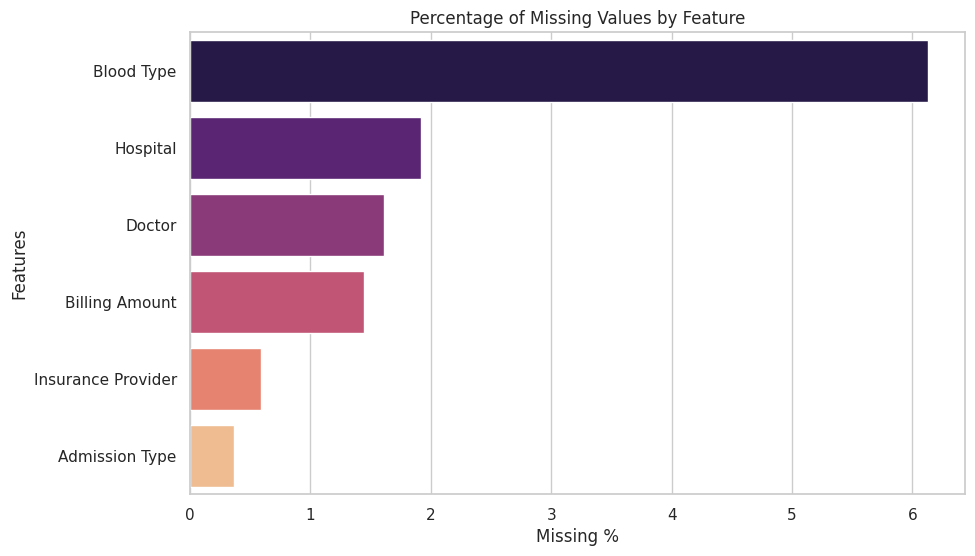

,Missing Count,Missing %,Unique Values
Blood Type,3065,6.130,8
Hospital,959,1.918,60
Doctor,804,1.608,217
Billing Amount,724,1.448,49276
Insurance Provider,293,0.586,5
Admission Type,181,0.362,3
ID,0,0.000,50000
Name,0,0.000,49992
Date of Admission,0,0.000,2101
Medical Condition,0,0.000,6


In [ ]:
# Visualize missing values
missing = df.isnull().mean().sort_values(ascending=False) * 100
missing = missing[missing > 0]  # show only columns with missing values

plt.figure(figsize=(10, 6))
sns.barplot(x=missing.values, y=missing.index, palette='magma')
plt.xlabel('Missing %')
plt.ylabel('Features')
plt.title('Percentage of Missing Values by Feature')
plt.show()


# Quantitative analysis
missing_stats = pd.DataFrame({
    'Missing Count': df.isnull().sum(),
    'Missing %': df.isnull().mean() * 100,
    'Unique Values': df.nunique()
}).sort_values('Missing %', ascending=False)

display(missing_stats)

In [ ]:
df['ID'].duplicated().sum()

np.int64(0)

In [ ]:
df.drop(columns=['ID'], inplace=True)

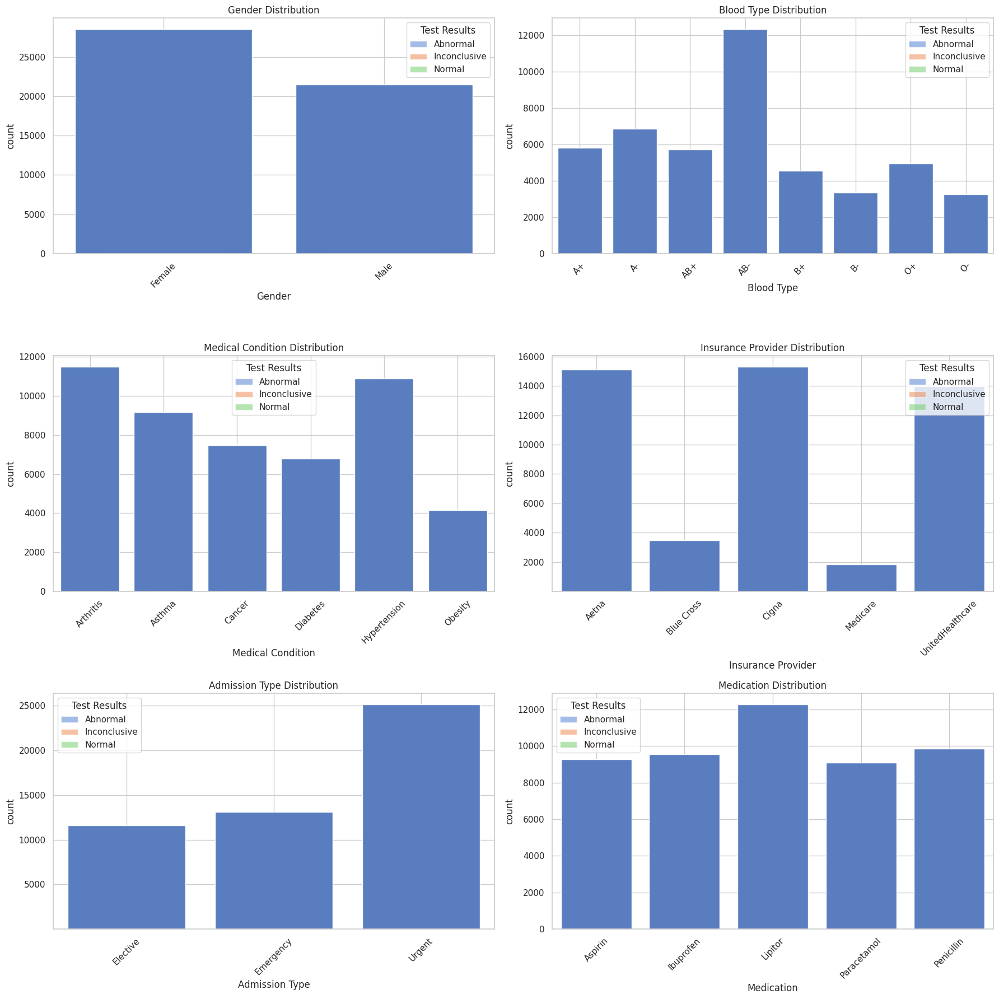

In [ ]:
# Select categorical columns
cat_cols = ['Gender', 'Blood Type', 'Medical Condition',
            'Insurance Provider', 'Admission Type', 'Medication']

# Create subplots
fig, axes = plt.subplots(3, 2, figsize=(18, 18))
axes = axes.flatten()

for i, col in enumerate(cat_cols):
    # Plot distribution
    if df[col].nunique() > 10:  # For high cardinality features
        top10 = df[col].value_counts().nlargest(10)
        sns.barplot(x=top10.index, y=top10.values, ax=axes[i])
    else:
        sns.countplot(x=col, data=df, ax=axes[i])

    # Add target analysis
    if 'Test Results' in df.columns:
        temp_df = df.groupby(col)['Test Results'].value_counts(normalize=True).unstack()
        temp_df.plot(kind='bar', stacked=True, ax=axes[i], alpha=0.5)

    axes[i].set_title(f'{col} Distribution')
    axes[i].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

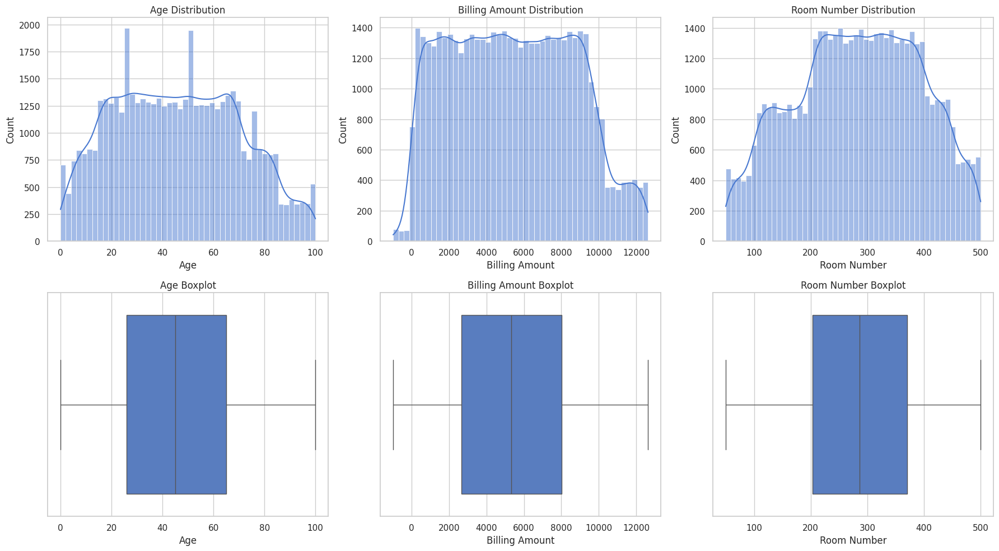

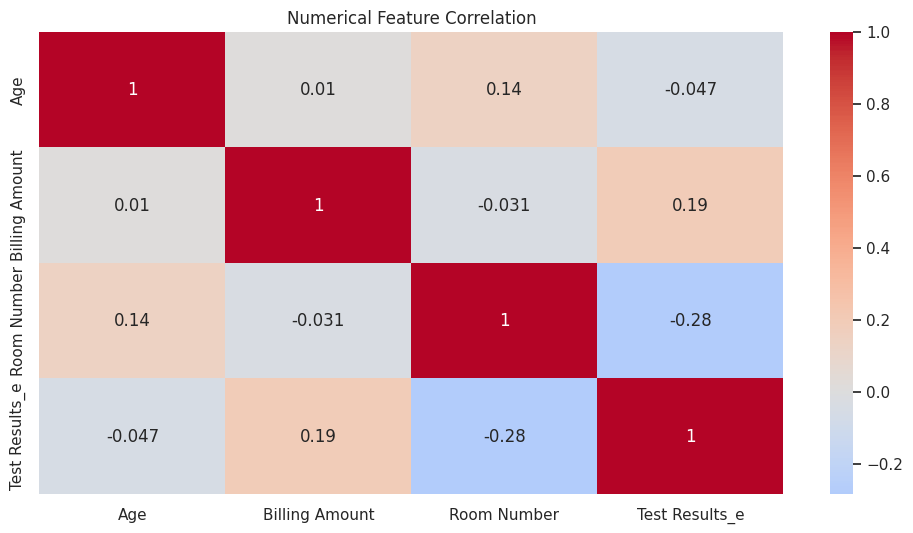

In [ ]:
num_cols = ['Age', 'Billing Amount', 'Room Number']

# Create subplots
fig, axes = plt.subplots(2, 3, figsize=(18, 10))
axes = axes.flatten()

for i, col in enumerate(num_cols):
    # Distribution plot
    sns.histplot(df[col], kde=True, ax=axes[i])
    axes[i].set_title(f'{col} Distribution')

    # Boxplot
    sns.boxplot(x=df[col], ax=axes[i+3])
    axes[i+3].set_title(f'{col} Boxplot')

plt.tight_layout()
plt.show()

# Correlation analysis
if 'Test Results' in df.columns:
    df['Test Results_e'] = df['Test Results'].astype('category').cat.codes

corr_matrix = df[num_cols + ['Test Results_e']].corr()
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0)
plt.title('Numerical Feature Correlation')
plt.show()
df.drop('Test Results_e', axis=1, inplace=True)

In [ ]:
# Select all numerical columns
num_cols = df.select_dtypes(include='number').columns

# Dictionary to hold IQR stats
iqr_summary = {}

for col in num_cols:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    iqr_summary[col] = {
        'Q1': Q1,
        'Q3': Q3,
        'IQR': IQR,
        'Lower Bound': lower_bound,
        'Upper Bound': upper_bound,
        'Outliers Below': (df[col] < lower_bound).sum(),
        'Outliers Above': (df[col] > upper_bound).sum()
    }

# Convert to DataFrame for display
iqr_df = pd.DataFrame(iqr_summary).T
display(iqr_df)


,Q1,Q3,IQR,Lower Bound,Upper Bound,Outliers Below,Outliers Above
Age,26.000000,65.000000,39.000000,-32.500000,123.500000,0.0,0.0
Billing Amount,2645.811489,8027.205893,5381.394404,-5426.280117,16099.297499,0.0,0.0
Room Number,203.000000,370.000000,167.000000,-47.500000,620.500000,0.0,0.0


missing values handling

Chi-square p-value: 0.0


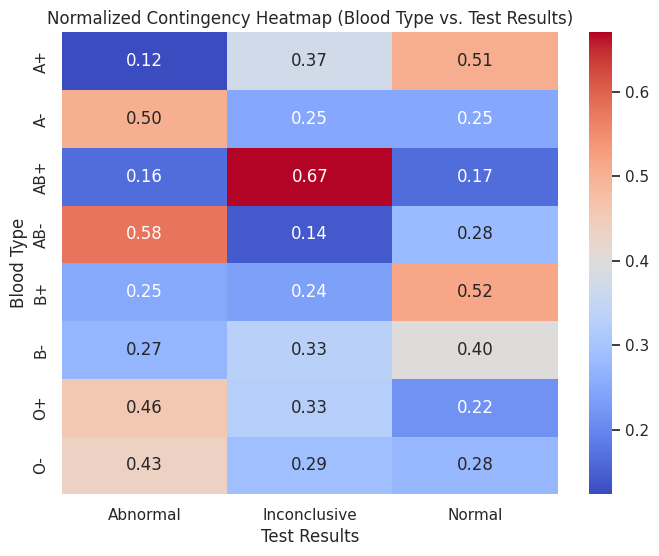

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

from scipy.stats import chi2_contingency

contingency_table = pd.crosstab(df['Blood Type'], df['Test Results'])
chi2, p, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-square p-value: {p}")

# Normalize the contingency table
normalized_table = contingency_table.div(contingency_table.sum(axis=1), axis=0)

# Plot the heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(normalized_table, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Normalized Contingency Heatmap (Blood Type vs. Test Results)")
plt.xlabel("Test Results")
plt.ylabel("Blood Type")
plt.show()

In [ ]:
!pip install catboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 6.8 MB/s eta 0:00:00


In [ ]:
import pandas as pd
from catboost import CatBoostClassifier

# Get only rows where 'Blood Type' is missing or present
df_missing = df[df['Blood Type'].isna()]
df_complete = df[df['Blood Type'].notna()]

# Choose features and target
features = ['Age', 'Gender', 'Medical Condition']
target = 'Blood Type'

# Train a CatBoostClassifier
model = CatBoostClassifier(verbose=0)
model.fit(df_complete[features], df_complete[target], cat_features=[1, 2])  # Gender and Medical Condition

# Predict missing Blood Types
predicted_blood_types = model.predict(df_missing[features])

# Fill in the missing values
df.loc[df['Blood Type'].isna(), 'Blood Type'] = predicted_blood_types


In [ ]:
import pandas as pd

contingency_table = pd.crosstab(df['Doctor'], df['Test Results'])
print(contingency_table)


In [ ]:
df['Hospital'].fillna('Unknown', inplace=True)

In [ ]:
df['Insurance Provider'] = df['Insurance Provider'].fillna('No Insurance')


In [ ]:
# Check how many negative billing amounts there are
neg_billing = df[df['Billing Amount'] < 0]
print(f"Number of negative billing amounts: {len(neg_billing)}")

# Inspect some of these negative values
print(neg_billing[['Billing Amount', 'Name', 'Date of Admission', 'Medical Condition', 'Test Results']].head(10))


In [ ]:
df['Billing Amount'] = df['Billing Amount'].abs()

In [ ]:
# neg_billing = df[df['Billing Amount'] < 0]


# Replace negative values with 0 (new approach)
# df.loc[df['Billing Amount'] < 0, 'Billing Amount'] = 0

In [ ]:
mean_billing = df['Billing Amount'].mean()
df['Billing Amount'].fillna(mean_billing, inplace=True)

In [ ]:
print(df['Admission Type'].isna().sum())

In [ ]:
mode_type = df['Admission Type'].mode()[0]
df['Admission Type'] = df['Admission Type'].fillna(mode_type)


In [ ]:
df.info()

In [ ]:
sns.pairplot(df, hue="Test Results")
plt.show()

In [ ]:
# Count the class distribution
class_counts = df['Test Results'].value_counts()
class_percentages = df['Test Results'].value_counts(normalize=True) * 100

# Display count and percentage
print("Class Counts:\n", class_counts)
print("\nClass Percentages:\n", class_percentages.round(2))

# Plot the distribution
plt.figure(figsize=(6, 4))
sns.countplot(x='Test Results', data=df, palette='Set2')
plt.title('Test Results Distribution')
plt.ylabel('Count')
plt.xlabel('Test Result Class')
plt.show()


In [ ]:
fig = px.sunburst(df, path=["Gender", "Medical Condition"])
fig.update_traces(textinfo = "label + percent parent")
fig.update_layout(title= "Patient's Gender",
                 title_font = {'size' : 20, 'family' : 'Serif'},
                 width = 500, height = 500)


In [ ]:
feats = ["Age", "Gender", "Blood Type", "Medical Condition", "Insurance Provider", "Admission Type", "Medication", "Test Results"]
for i, col in enumerate(feats, 1):
    fig = px.sunburst(df, path=[col])
    fig.update_traces(textinfo="label + percent parent")
    fig.update_layout(
        title=f"Patient's {col}",
        title_font={"size": 20, "family": "Serif"},
        width=600,
        height=600
    )


In [ ]:
fig = px.sunburst(df, path = ["Test Results", "Medication"])
fig.update_traces(textinfo = "label + percent parent")
fig.update_layout(title = "Test Results by Medication",
                 title_font = {'size' : 20, 'family' : 'Serif'},
                 width = 600, height = 600)


In [ ]:
fig = px.sunburst(df, path = ["Admission Type", "Medical Condition"])
fig.update_traces(textinfo = "label + percent parent")
fig.update_layout(title = "Admission Type by Medical Condition",
                 title_font = {'size' : 20, 'family' : 'Serif'},
                 height = 600, width = 600)

In [ ]:
fig = px.sunburst(df, path = ["Gender", "Medical Condition", "Medication"])
fig.update_traces(textinfo = "label + percent parent")
fig.update_layout(title = "Patient's Status",
                 title_font = {'size' : 20, 'family' : 'Serif'},
                 height = 600, width = 600)


In [ ]:
df['Date of Admission'] = pd.to_datetime(df['Date of Admission'], dayfirst=True, errors='coerce')
df['Discharge Date'] = pd.to_datetime(df['Discharge Date'], dayfirst=True, errors='coerce')

In [ ]:
# df = df.drop(columns=['Doctor'])


In [ ]:
df.drop(columns=['Name'], inplace=True)

In [ ]:
df.info()

In [ ]:
# Save cleaned dataframe to a new CSV file
df.to_csv("cleaned_healthcare_data_withAGE0_&negativebilling.csv", index=False)

## Feature Engineering

In [ ]:
import pandas as pd
import numpy as np
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, OneHotEncoder, FunctionTransformer
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder
from deap import base, creator, tools, algorithms
import random
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
# Impute missing values in the Doctor column based on Test Results
def impute_missing_doctor(data):
    data = data.copy()

    # Check if there are missing values in the Doctor column
    missing_doctor_mask = data['Doctor'].isna()
    missing_count = missing_doctor_mask.sum()

    if missing_count > 0:
        print(f"Found {missing_count} missing values in the Doctor column")

        # Create a mapping of Test Results to most frequent doctor
        doctor_by_test_result = {}

        # Group by Test Results and find the most frequent doctor for each result type
        for test_result, group in data.loc[~missing_doctor_mask].groupby('Test Results'):
            # Count occurrences of each doctor for this test result
            doctor_counts = group['Doctor'].value_counts()
            # Get the most frequent doctor
            most_frequent_doctor = doctor_counts.idxmax()
            # Store in our mapping
            doctor_by_test_result[test_result] = most_frequent_doctor

            print(f"For Test Result '{test_result}', most frequent doctor is '{most_frequent_doctor}' with {doctor_counts.max()} occurrences")

        # Apply the mapping to fill missing values
        for test_result, doctor in doctor_by_test_result.items():
            # For each missing Doctor value, fill with the most frequent doctor for that test result
            mask = missing_doctor_mask & (data['Test Results'] == test_result)
            data.loc[mask, 'Doctor'] = doctor
            print(f"Imputed {mask.sum()} missing Doctor values for Test Result '{test_result}'")

        # Check if we still have missing values that weren't handled
        still_missing = data['Doctor'].isna().sum()
        if still_missing > 0:
            # Use the overall most frequent doctor as fallback
            overall_most_frequent = data['Doctor'].value_counts().idxmax()
            data.loc[data['Doctor'].isna(), 'Doctor'] = overall_most_frequent
            print(f"Imputed remaining {still_missing} missing values with overall most frequent doctor '{overall_most_frequent}'")

        # Verify no missing values remain
        final_missing = data['Doctor'].isna().sum()
        print(f"Final missing values in Doctor column: {final_missing}")

        # Visualize the distribution of doctors before and after imputation
        plt.figure(figsize=(12, 6))

        plt.subplot(1, 2, 1)
        doctor_counts_after = data['Doctor'].value_counts().head(10)
        sns.barplot(x=doctor_counts_after.values, y=doctor_counts_after.index)
        plt.title('Top 10 Doctors After Imputation')
        plt.xlabel('Count')
        plt.tight_layout()
        plt.show()

    else:
        print("No missing values found in the Doctor column")

    return data


Found 804 missing values in the Doctor column
For Test Result 'Abnormal', most frequent doctor is 'Lynn Young' with 230 occurrences
For Test Result 'Inconclusive', most frequent doctor is 'Christopher Butler' with 278 occurrences
For Test Result 'Normal', most frequent doctor is 'Angela Contreras' with 198 occurrences
Imputed 298 missing Doctor values for Test Result 'Abnormal'
Imputed 241 missing Doctor values for Test Result 'Inconclusive'
Imputed 265 missing Doctor values for Test Result 'Normal'
Final missing values in Doctor column: 0


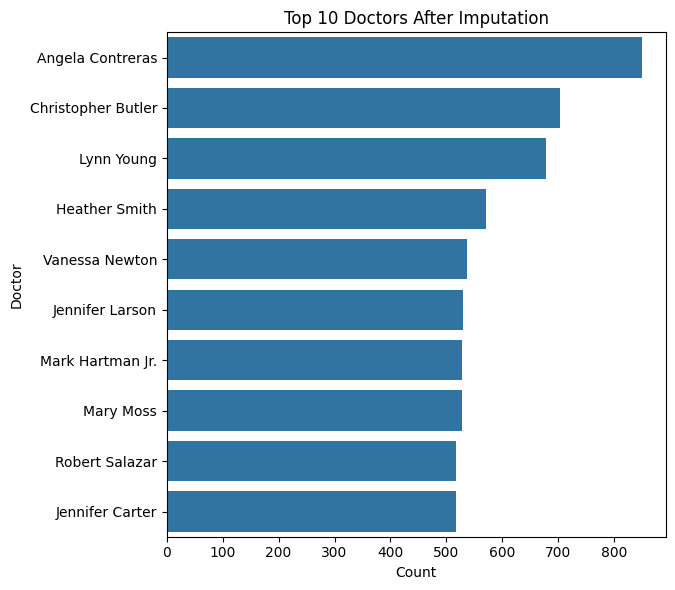

In [ ]:
# Load data
data = pd.read_csv('/content/drive/MyDrive/Task (2) - Machine Learning/cleaned_healthcare_data_withAGE0_negativebilling_only.csv')

# Apply imputation
data = impute_missing_doctor(data)


In [ ]:
def parse_dates_conditionally(date_series):
    date_series = date_series.astype(str)
    sample = date_series.dropna().iloc[0]
    parts = sample.split('/')
    day_first = True
    if len(parts) == 3:
        if int(parts[0]) > 12:
            day_first = True
        else:
            day_first = False
    return pd.to_datetime(date_series, errors='coerce', dayfirst=day_first)

def preprocess_dates_and_columns(df, drop_columns=False):
    df = df.copy()
    df['Date of Admission'] = parse_dates_conditionally(df['Date of Admission'])
    df['Discharge Date'] = parse_dates_conditionally(df['Discharge Date'])

    df['Days Spent'] = (df['Discharge Date'] - df['Date of Admission']).dt.days
    df['Days Spent'] = df['Days Spent'].fillna(df['Days Spent'].median())

    if drop_columns:
        drop_cols = ['Date of Admission', 'Discharge Date', 'Room Number']
        df.drop(columns=drop_cols, inplace=True, errors='ignore')

    return df


In [ ]:
# Extract target variable
y = data['Test Results']
X = data.drop('Test Results', axis=1)

In [ ]:
# Create a label encoder for the target variable
le = LabelEncoder()
y_encoded = le.fit_transform(y)

In [ ]:
categorical_cols = ['Gender', 'Blood Type', 'Medical Condition',
                    'Admission Type', 'Medication', 'Hospital', 'Insurance Provider', 'Doctor']

all_numeric_cols = ['Age', 'Billing Amount', 'Days Spent', 'Room Number']

# Define transformers
categorical_transformer = OneHotEncoder(handle_unknown='ignore', sparse_output=False)
numeric_transformer = StandardScaler()

In [ ]:
import numpy as np
from sklearn.decomposition import PCA
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import FunctionTransformer
from tqdm import tqdm

best_score = 0
best_n = None

# This will store scores for plotting or analysis if needed
scores = []

for n_components in tqdm(range(2, 310)):
    pipeline_pca = Pipeline([
        ('preprocessing', FunctionTransformer(lambda df: preprocess_dates_and_columns(df, drop_columns=False))),
        ('transform', ColumnTransformer([
            ('num', numeric_transformer, all_numeric_cols),
            ('cat', categorical_transformer, categorical_cols)
        ])),
        ('pca', PCA(n_components=n_components)),
        ('clf', LogisticRegression(max_iter=1000, random_state=42))
    ])

    # cross_val_score needs X, y datasets
    # Assuming you have X, y defined
    score = cross_val_score(pipeline_pca, X, y, cv=5, scoring='accuracy').mean()
    scores.append(score)

    if score > best_score:
        best_score = score
        best_n = n_components

print(f"Best n_components: {best_n} with cross-validated accuracy: {best_score:.4f}")


100%|██████████| 308/308 [3:17:17<00:00, 38.43s/it]

Best n_components: 284 with cross-validated accuracy: 0.8440


In [ ]:
# PIPELINE 1: Baseline without PCA - drops specified columns
preprocessor_baseline = FunctionTransformer(lambda df: preprocess_dates_and_columns(df, drop_columns=True))
column_transformer_baseline = ColumnTransformer([
    ('num', numeric_transformer, ['Age', 'Billing Amount', 'Days Spent']),
    ('cat', categorical_transformer, categorical_cols)
])
pipeline_baseline = Pipeline([
    ('preprocessing', preprocessor_baseline),
    ('transform', column_transformer_baseline)
])


In [ ]:
# PIPELINE 2: PCA approach - drops specified columns before PCA
preprocessor_pca = FunctionTransformer(lambda df: preprocess_dates_and_columns(df, drop_columns=False))
column_transformer_pca = ColumnTransformer([
    ('num', numeric_transformer, all_numeric_cols),
    ('cat', categorical_transformer, categorical_cols)
])
pipeline_pca = Pipeline([
    ('preprocessing', preprocessor_pca),
    ('transform', column_transformer_pca),
    ('pca', PCA(n_components=284))
])

In [ ]:
# PIPELINE 3: Genetic Algorithm for feature selection
# Keep all columns initially for GA to select from
preprocessor_ga = FunctionTransformer(lambda df: preprocess_dates_and_columns(df, drop_columns=False))
column_transformer_ga = ColumnTransformer([
    ('num', numeric_transformer, all_numeric_cols),
    ('cat', categorical_transformer, categorical_cols)
])

# Process the data for GA
pipeline_ga_preprocess = Pipeline([
    ('preprocessing', preprocessor_ga),
    ('transform', column_transformer_ga)
])

In [26]:
# Split data
X_temp, X_test, y_temp, y_test = train_test_split(
    X, y_encoded, test_size=0.15, random_state=42, stratify=y_encoded)

X_train, X_val, y_train, y_val = train_test_split(
    X_temp, y_temp, test_size=0.1765, random_state=42, stratify=y_temp)

#baseline
X_train_baseline = pipeline_baseline.fit_transform(X_train)
X_val_baseline = pipeline_baseline.transform(X_val)
X_test_baseline = pipeline_baseline.transform(X_test)

#PCA
X_train_pca = pipeline_pca.fit_transform(X_train)
X_val_pca = pipeline_pca.transform(X_val)
X_test_pca = pipeline_pca.transform(X_test)

#Genetic Algorithm
X_train_ga_full = pipeline_ga_preprocess.fit_transform(X_train)
X_val_ga_full = pipeline_ga_preprocess.transform(X_val)
X_test_ga_full = pipeline_ga_preprocess.transform(X_test)


In [ ]:
# Genetic Algorithm Setup
n_features = X_train_ga_full.shape[1]

creator.create("FitnessMax", base.Fitness, weights=(1.0,))
creator.create("Individual", list, fitness=creator.FitnessMax)

toolbox = base.Toolbox()
toolbox.register("attr_bool", random.randint, 0, 1)
toolbox.register("individual", tools.initRepeat, creator.Individual, toolbox.attr_bool, n=n_features)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

# Evaluation function for GA
def evalFeatureSelection(individual):
    selected_indices = [i for i, val in enumerate(individual) if val == 1]

    if len(selected_indices) == 0:
        return 0.0,

    X_train_selected = X_train_ga_full[:, selected_indices]
    X_val_selected = X_val_ga_full[:, selected_indices]

    lr = LogisticRegression(random_state=42, max_iter=1000)
    lr.fit(X_train_selected, y_train)

    val_accuracy = accuracy_score(y_val, lr.predict(X_val_selected))

    return val_accuracy,

toolbox.register("evaluate", evalFeatureSelection)
toolbox.register("mate", tools.cxTwoPoint)
toolbox.register("mutate", tools.mutFlipBit, indpb=0.1)
toolbox.register("select", tools.selTournament, tournsize=3)

# Run Genetic Algorithm
def run_genetic_algorithm(pop_size=100, ngen=20, cxpb=0.7, mutpb=0.2):
    print("Starting Genetic Algorithm for feature selection...")
    pop = toolbox.population(n=pop_size)
    hof = tools.HallOfFame(1)
    stats = tools.Statistics(lambda ind: ind.fitness.values)
    stats.register("avg", np.mean)
    stats.register("max", np.max)

    pop, log = algorithms.eaSimple(pop, toolbox, cxpb=cxpb, mutpb=mutpb, ngen=ngen,
                                  stats=stats, halloffame=hof, verbose=True)

    return hof[0]

best_individual = run_genetic_algorithm()

Starting Genetic Algorithm for feature selection...
gen	nevals	avg     	max    
0  	100   	0.738031	0.80592
1  	80    	0.771076	0.818778
2  	74    	0.787372	0.828288
3  	70    	0.798547	0.828288
4  	77    	0.807206	0.82936 
5  	85    	0.815893	0.83445 
6  	75    	0.819152	0.837262
7  	84    	0.823649	0.836191
8  	78    	0.826347	0.836191
9  	76    	0.827876	0.836191
10 	81    	0.830735	0.83686 
11 	74    	0.832075	0.837396
12 	87    	0.831792	0.839807
13 	83    	0.833548	0.840745
14 	76    	0.833583	0.840745
15 	90    	0.835824	0.842888
16 	71    	0.836847	0.84262 
17 	76    	0.836181	0.842754
18 	76    	0.83701 	0.844093
19 	65    	0.837123	0.844495
20 	66    	0.839242	0.845299


In [ ]:
# Get selected features from best individual
selected_indices = [i for i, val in enumerate(best_individual) if val == 1]
print(f"Number of features selected by GA: {sum(best_individual)}/{len(best_individual)}")

Number of features selected by GA: 186/310


In [ ]:
# Get selected features from best individual
selected_indices = [i for i, val in enumerate(best_individual) if val == 1]
print("selected features indices:", selected_indices)
print(f"Number of features selected by GA: {sum(best_individual)}/{len(best_individual)}")

selected features indices: [0, 1, 2, 3, 5, 6, 8, 9, 12, 13, 14, 15, 16, 18, 19, 21, 22, 24, 26, 27, 28, 30, 31, 34, 35, 36, 38, 39, 40, 41, 42, 43, 47, 49, 52, 53, 55, 56, 58, 59, 60, 61, 62, 64, 66, 67, 69, 70, 72, 73, 74, 75, 80, 81, 82, 84, 85, 86, 89, 91, 92, 93, 94, 96, 99, 102, 103, 104, 106, 107, 108, 109, 112, 114, 116, 117, 118, 120, 122, 123, 124, 126, 127, 128, 131, 132, 135, 140, 142, 143, 144, 146, 148, 149, 150, 151, 152, 153, 155, 158, 159, 160, 162, 164, 165, 166, 168, 170, 171, 172, 173, 175, 177, 178, 180, 181, 185, 188, 189, 190, 191, 194, 195, 196, 197, 198, 199, 200, 201, 202, 204, 206, 207, 208, 209, 212, 215, 218, 219, 220, 221, 223, 224, 225, 226, 230, 231, 233, 234, 235, 237, 238, 239, 240, 241, 242, 244, 245, 247, 248, 249, 250, 252, 254, 256, 257, 258, 259, 261, 262, 263, 264, 265, 269, 272, 273, 274, 275, 276, 280, 283, 285, 287, 288, 289, 290, 291, 293, 295, 299, 300, 301, 302, 306, 307]
Number of features selected by GA: 195/310


In [27]:
selected_indices =  [0, 1, 2, 3, 5, 6, 8, 9, 12, 13, 14, 15, 16, 18, 19, 21, 22, 24, 26, 27, 28, 30, 31, 34, 35, 36, 38, 39, 40, 41, 42, 43, 47, 49, 52, 53, 55, 56, 58, 59, 60, 61, 62, 64, 66, 67, 69, 70, 72, 73, 74, 75, 80, 81, 82, 84, 85, 86, 89, 91, 92, 93, 94, 96, 99, 102, 103, 104, 106, 107, 108, 109, 112, 114, 116, 117, 118, 120, 122, 123, 124, 126, 127, 128, 131, 132, 135, 140, 142, 143, 144, 146, 148, 149, 150, 151, 152, 153, 155, 158, 159, 160, 162, 164, 165, 166, 168, 170, 171, 172, 173, 175, 177, 178, 180, 181, 185, 188, 189, 190, 191, 194, 195, 196, 197, 198, 199, 200, 201, 202, 204, 206, 207, 208, 209, 212, 215, 218, 219, 220, 221, 223, 224, 225, 226, 230, 231, 233, 234, 235, 237, 238, 239, 240, 241, 242, 244, 245, 247, 248, 249, 250, 252, 254, 256, 257, 258, 259, 261, 262, 263, 264, 265, 269, 272, 273, 274, 275, 276, 280, 283, 285, 287, 288, 289, 290, 291, 293, 295, 299, 300, 301, 302, 306, 307]

print(f"Using {len(selected_indices)} features selected by previous GA run")
print("Selected feature indices:", selected_indices)

# Apply feature selection to your datasets
X_train_ga = X_train_ga_full[:, selected_indices]
X_val_ga = X_val_ga_full[:, selected_indices]
X_test_ga = X_test_ga_full[:, selected_indices]

Using 195 features selected by previous GA run
Selected feature indices: [0, 1, 2, 3, 5, 6, 8, 9, 12, 13, 14, 15, 16, 18, 19, 21, 22, 24, 26, 27, 28, 30, 31, 34, 35, 36, 38, 39, 40, 41, 42, 43, 47, 49, 52, 53, 55, 56, 58, 59, 60, 61, 62, 64, 66, 67, 69, 70, 72, 73, 74, 75, 80, 81, 82, 84, 85, 86, 89, 91, 92, 93, 94, 96, 99, 102, 103, 104, 106, 107, 108, 109, 112, 114, 116, 117, 118, 120, 122, 123, 124, 126, 127, 128, 131, 132, 135, 140, 142, 143, 144, 146, 148, 149, 150, 151, 152, 153, 155, 158, 159, 160, 162, 164, 165, 166, 168, 170, 171, 172, 173, 175, 177, 178, 180, 181, 185, 188, 189, 190, 191, 194, 195, 196, 197, 198, 199, 200, 201, 202, 204, 206, 207, 208, 209, 212, 215, 218, 219, 220, 221, 223, 224, 225, 226, 230, 231, 233, 234, 235, 237, 238, 239, 240, 241, 242, 244, 245, 247, 248, 249, 250, 252, 254, 256, 257, 258, 259, 261, 262, 263, 264, 265, 269, 272, 273, 274, 275, 276, 280, 283, 285, 287, 288, 289, 290, 291, 293, 295, 299, 300, 301, 302, 306, 307]


## Models

### SVM

In [ ]:
from sklearn.svm import SVC
from sklearn.pipeline import make_pipeline
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler
from sklearn.multiclass import OneVsOneClassifier, OneVsRestClassifier
from sklearn.model_selection import train_test_split
import json
import os

# Create results directory if it doesn't exist
os.makedirs('results', exist_ok=True)

class SVMAnalyzer:
    def __init__(self, preprocessing_data, y_train, y_val, y_test):
        self.preprocessing_data = preprocessing_data
        self.y_train = y_train
        self.y_val = y_val
        self.y_test = y_test
        self.target_names = [f'Class {i}' for i in range(len(np.unique(y_train)))]
        self.svm_kernels = {
            "Linear": 'linear',
            "Polynomial": 'poly',
            "Gaussian (RBF)": 'rbf'
        }
        self.all_results = {}

    def create_models(self):
        """Create all SVM model variants"""
        models = {}
        for kernel_name, kernel in self.svm_kernels.items():
            # Default multiclass (OvR)
            models[f"{kernel_name} SVM (Default)"] = make_pipeline(
                StandardScaler(),
                SVC(kernel=kernel, C=1.0, gamma='scale', random_state=42, decision_function_shape='ovr')
            )

            # Explicit One-vs-One
            models[f"{kernel_name} SVM (OvO)"] = make_pipeline(
                StandardScaler(),
                OneVsOneClassifier(SVC(kernel=kernel, C=1.0, gamma='scale', random_state=42))
            )

            # One-vs-Rest (OvA)
            models[f"{kernel_name} SVM (OvA)"] = make_pipeline(
                StandardScaler(),
                OneVsRestClassifier(SVC(kernel=kernel, C=1.0, gamma='scale', random_state=42))
            )
        return models

    def extract_3d_coordinates(self, X_train, y_train, model_name):
        """Extract 3D coordinates for each class"""
        coordinates_3d = {}
        if X_train.shape[1] >= 3:
            for class_idx in np.unique(y_train):
                mask = y_train == class_idx
                class_points = X_train[mask, :3]  # First 3 dimensions
                coordinates_3d[f'class_{class_idx}'] = class_points.tolist()
        return coordinates_3d

    def get_ovo_decision_boundaries_3d(self, model, X_train):
        """Extract OvO decision boundary parameters for 3D visualization"""
        if 'OvO' not in str(type(model)) or X_train.shape[1] < 3:
            return {}

        ovo_clf = None
        for step_name, step in model.named_steps.items():
            if isinstance(step, OneVsOneClassifier):
                ovo_clf = step
                break

        if ovo_clf is None or not hasattr(ovo_clf, 'estimators_'):
            return {}

        boundary_info = {}
        classes = ovo_clf.classes_
        estimators = ovo_clf.estimators_

        pair_idx = 0
        for i in range(len(classes)):
            for j in range(i + 1, len(classes)):
                clf = estimators[pair_idx]
                if hasattr(clf, 'coef_') and hasattr(clf, 'intercept_'):
                    # For linear kernels, we can get the boundary parameters
                    boundary_info[f'class_{classes[i]}_vs_class_{classes[j]}'] = {
                        'normal': clf.coef_[0][:3].tolist(),  # First 3 coefficients
                        'intercept': float(clf.intercept_[0])
                    }
                pair_idx += 1

        return boundary_info

    def plot_2d_decision_boundary(self, X_train, y_train, model, model_name, prep_name, val_acc, test_acc):
        """Plot 2D decision boundary with proper OvO visualization"""
        if X_train.shape[1] < 2:
            return

        f1, f2 = 0, 1  # First two features

        # Create mesh grid
        h = 0.02
        x_min, x_max = X_train[:, f1].min() - 1, X_train[:, f1].max() + 1
        y_min, y_max = X_train[:, f2].min() - 1, X_train[:, f2].max() + 1
        xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

        # Create fake data with zeros for other features
        fake_data = np.zeros((xx.ravel().shape[0], X_train.shape[1]))
        fake_data[:, f1] = xx.ravel()
        fake_data[:, f2] = yy.ravel()

        # Apply scaling
        scaler = model.named_steps['standardscaler']
        scaled_fake_data = scaler.transform(fake_data)

        if 'OvA' in model_name:
            self._plot_ova_boundaries(model, xx, yy, scaled_fake_data, X_train, y_train,
                                    model_name, prep_name, f1, f2)
        else:
            self._plot_combined_boundaries(model, xx, yy, scaled_fake_data, X_train, y_train,
                                         model_name, prep_name, f1, f2, val_acc, test_acc)

    def _plot_ova_boundaries(self, model, xx, yy, scaled_fake_data, X_train, y_train,
                           model_name, prep_name, f1, f2):
        """Plot One-vs-All decision boundaries"""
        n_classes = len(np.unique(y_train))
        fig, axs = plt.subplots(n_classes, 1, figsize=(10, 5*n_classes))
        if n_classes == 1:
            axs = [axs]

        ovr_classifier = model.named_steps['onevsrestclassifier']

        for i in range(n_classes):
            ax = axs[i] if n_classes > 1 else axs
            binary_clf = ovr_classifier.estimators_[i]

            Z = binary_clf.decision_function(scaled_fake_data)
            Z = Z.reshape(xx.shape)

            ax.contourf(xx, yy, Z, alpha=0.4, cmap=plt.cm.RdBu)
            ax.contour(xx, yy, Z, colors='k', levels=[-1, 0, 1], alpha=0.5,
                      linestyles=['--', '-', '--'])

            # Plot training points
            for cls in np.unique(y_train):
                idx = np.where(y_train == cls)[0]
                ax.scatter(X_train[idx, f1], X_train[idx, f2],
                          alpha=0.8, label=f'Class {cls}', edgecolor='k')

            ax.set_title(f"{prep_name} - {model_name} - Class {i} vs Rest\nFeatures {f1} vs {f2}")
            ax.set_xlabel(f"Feature {f1}")
            ax.set_ylabel(f"Feature {f2}")
            ax.legend()

        plt.tight_layout()
        filename = f"results/{prep_name}_{model_name.replace(' ', '_')}_ova_decision_boundary.png"
        plt.savefig(filename, dpi=300, bbox_inches='tight')
        plt.show()

    def _plot_combined_boundaries(self, model, xx, yy, scaled_fake_data, X_train, y_train,
                                model_name, prep_name, f1, f2, val_acc, test_acc):
        """Plot combined decision boundaries for Default and OvO"""
        plt.figure(figsize=(12, 10))

        # Get the classifier
        if 'OvO' in model_name:
            classifier = model.named_steps['onevsoneclassifier']
            # For OvO, show individual binary classifiers
            self._add_ovo_individual_boundaries(classifier, xx, yy, scaled_fake_data)
        else:
            classifier = model.named_steps['svc']

        # Get combined predictions
        Z = classifier.predict(scaled_fake_data)
        Z = Z.reshape(xx.shape)

        # Plot decision regions
        plt.contourf(xx, yy, Z, alpha=0.4, cmap=plt.cm.brg)
        plt.contour(xx, yy, Z, colors='k', alpha=0.7, linewidths=2)

        # Plot training points
        colors = ['blue', 'orange', 'green', 'red', 'purple', 'brown']
        for cls in np.unique(y_train):
            idx = np.where(y_train == cls)[0]
            plt.scatter(X_train[idx, f1], X_train[idx, f2],
                       c=colors[cls % len(colors)], alpha=0.8,
                       label=f'Class {cls}', edgecolor='k', s=50)

        plt.title(f"{prep_name} - {model_name}\nFeatures {f1} vs {f2}\n"
                 f"Val Acc: {val_acc:.4f}, Test Acc: {test_acc:.4f}", fontsize=14)
        plt.xlabel(f"Feature {f1}", fontsize=12)
        plt.ylabel(f"Feature {f2}", fontsize=12)
        plt.legend()
        plt.grid(True, alpha=0.3)

        filename = f"results/{prep_name}_{model_name.replace(' ', '_')}_decision_boundary.png"
        plt.savefig(filename, dpi=300, bbox_inches='tight')
        plt.show()

    def _add_ovo_individual_boundaries(self, ovo_classifier, xx, yy, scaled_fake_data):
        """Add individual OvO decision boundaries"""
        if hasattr(ovo_classifier, 'estimators_'):
            classes = ovo_classifier.classes_
            estimators = ovo_classifier.estimators_

            pair_idx = 0
            colors = ['red', 'blue', 'green', 'purple', 'orange', 'brown']

            for i in range(len(classes)):
                for j in range(i + 1, len(classes)):
                    clf = estimators[pair_idx]
                    if hasattr(clf, 'decision_function'):
                        Z_binary = clf.decision_function(scaled_fake_data)
                        Z_binary = Z_binary.reshape(xx.shape)

                        plt.contour(xx, yy, Z_binary, colors=colors[pair_idx % len(colors)],
                                  levels=[0], alpha=0.8, linewidths=1.5,
                                  linestyles='-')
                    pair_idx += 1

    def plot_3d_coordinates(self, coordinates_3d, prep_name, model_name, boundary_info=None):
        """Plot 3D coordinates with decision boundaries"""
        if not coordinates_3d:
            return

        fig = plt.figure(figsize=(15, 12))
        ax = fig.add_subplot(111, projection='3d')

        colors = ['blue', 'orange', 'green', 'red', 'purple', 'brown']

        # Plot points for each class
        for class_key, points in coordinates_3d.items():
            class_idx = int(class_key.split('_')[1])
            points_array = np.array(points)

            ax.scatter(points_array[:, 0], points_array[:, 1], points_array[:, 2],
                      c=colors[class_idx % len(colors)], alpha=0.6, s=50,
                      label=f'Class {class_idx}', edgecolor='k')

        # Plot decision boundaries for linear OvO
        if boundary_info and 'Linear' in model_name:
            self._plot_3d_decision_planes(ax, boundary_info, coordinates_3d)

        ax.set_xlabel('Feature 0', fontsize=12)
        ax.set_ylabel('Feature 1', fontsize=12)
        ax.set_zlabel('Feature 2', fontsize=12)
        ax.set_title(f'{prep_name} - {model_name}\n3D Feature Space', fontsize=14)
        ax.legend()

        # Set equal aspect ratio
        max_range = 0
        for points in coordinates_3d.values():
            points_array = np.array(points)
            for i in range(3):
                range_i = points_array[:, i].max() - points_array[:, i].min()
                max_range = max(max_range, range_i)

        ax.set_xlim([-max_range/2, max_range/2])
        ax.set_ylim([-max_range/2, max_range/2])
        ax.set_zlim([-max_range/2, max_range/2])

        filename = f"results/{prep_name}_{model_name.replace(' ', '_')}_3d_plot.png"
        plt.savefig(filename, dpi=300, bbox_inches='tight')
        plt.show()

    def _plot_3d_decision_planes(self, ax, boundary_info, coordinates_3d):
        """Plot 3D decision planes for linear OvO classifiers"""
        # Get overall data range
        all_points = []
        for points in coordinates_3d.values():
            all_points.extend(points)
        all_points = np.array(all_points)

        x_range = [all_points[:, 0].min(), all_points[:, 0].max()]
        y_range = [all_points[:, 1].min(), all_points[:, 1].max()]
        z_range = [all_points[:, 2].min(), all_points[:, 2].max()]

        colors = ['red', 'blue', 'green', 'purple', 'orange', 'brown']
        color_idx = 0

        for boundary_key, params in boundary_info.items():
            normal = np.array(params['normal'])
            intercept = params['intercept']

            # Create plane: normal[0]*x + normal[1]*y + normal[2]*z + intercept = 0
            # Solve for z: z = -(normal[0]*x + normal[1]*y + intercept) / normal[2]
            if abs(normal[2]) > 1e-6:  # Avoid division by zero
                xx, yy = np.meshgrid(np.linspace(x_range[0], x_range[1], 20),
                                   np.linspace(y_range[0], y_range[1], 20))
                zz = -(normal[0] * xx + normal[1] * yy + intercept) / normal[2]

                # Only plot if z values are within reasonable range
                valid_mask = (zz >= z_range[0]) & (zz <= z_range[1])
                if valid_mask.any():
                    ax.plot_surface(xx, yy, zz, alpha=0.3,
                                  color=colors[color_idx % len(colors)])

            color_idx += 1

    def run_comprehensive_analysis(self):
        """Run the complete SVM analysis"""
        print("\n=== Comprehensive SVM Classification Performance ===\n")

        for prep_name, data in self.preprocessing_data.items():
            print(f"\n{'='*60}")
            print(f"PREPROCESSING: {prep_name}")
            print(f"{'='*60}")

            X_train_curr = data['X_train']
            X_val_curr = data['X_val']
            X_test_curr = data['X_test']

            models = self.create_models()
            results = {}

            for name, model in models.items():
                print(f"\n--- {prep_name} - {name} ---")

                # Fit model
                model.fit(X_train_curr, self.y_train)
                y_val_pred = model.predict(X_val_curr)
                y_test_pred = model.predict(X_test_curr)

                # Calculate metrics
                val_acc = accuracy_score(self.y_val, y_val_pred)
                test_acc = accuracy_score(self.y_test, y_test_pred)
                cm = confusion_matrix(self.y_test, y_test_pred)

                # Extract 3D coordinates
                coordinates_3d = self.extract_3d_coordinates(X_train_curr, self.y_train, name)

                # Get OvO boundary info for 3D
                boundary_info = self.get_ovo_decision_boundaries_3d(model, X_train_curr)

                # Store results
                results[name] = {
                    'val_acc': val_acc,
                    'test_acc': test_acc,
                    'confusion_matrix': cm,
                    'model': model,
                    'coordinates_3d': coordinates_3d,
                    'ovo_boundaries_3d': boundary_info
                }

                print(f"Validation Accuracy: {val_acc:.4f}")
                print(f"Test Accuracy: {test_acc:.4f}")
                print("Confusion Matrix (Test Set):")
                print(cm)
                print("\nClassification Report (Test Set):")
                print(classification_report(self.y_test, y_test_pred, target_names=self.target_names))

                # Plot 2D decision boundary
                self.plot_2d_decision_boundary(X_train_curr, self.y_train, model,
                                             name, prep_name, val_acc, test_acc)

                # Plot 3D coordinates
                if coordinates_3d:
                    self.plot_3d_coordinates(coordinates_3d, prep_name, name, boundary_info)

            self.all_results[prep_name] = results
            self._plot_comparison(results, prep_name)

        self._final_analysis()
        self._save_results()

    def _plot_comparison(self, results, prep_name):
        """Plot model comparison for preprocessing method"""
        models_list = sorted(results.keys(), key=lambda x: results[x]['test_acc'], reverse=True)

        plt.figure(figsize=(14, 8))
        val_acc = [results[name]['val_acc'] for name in models_list]
        test_acc = [results[name]['test_acc'] for name in models_list]
        x = np.arange(len(models_list))
        width = 0.35

        plt.bar(x - width/2, val_acc, width, label='Validation Accuracy', alpha=0.8)
        plt.bar(x + width/2, test_acc, width, label='Test Accuracy', alpha=0.8)
        plt.xticks(x, models_list, rotation=45, ha='right')
        plt.ylabel('Accuracy')
        plt.title(f'Model Comparison - {prep_name} Preprocessing')
        plt.legend()
        plt.grid(axis='y', alpha=0.3)
        plt.tight_layout()
        plt.savefig(f"results/{prep_name}_model_comparison.png", dpi=300, bbox_inches='tight')
        plt.show()

    def _final_analysis(self):
        """Perform final cross-preprocessing analysis"""
        print(f"\n{'='*80}")
        print("CROSS-PREPROCESSING COMPARISON")
        print(f"{'='*80}")

        # Find best models
        best_models = {}
        for prep_name, results in self.all_results.items():
            best_model_name = max(results.keys(), key=lambda x: results[x]['test_acc'])
            best_models[prep_name] = {
                'name': best_model_name,
                'val_acc': results[best_model_name]['val_acc'],
                'test_acc': results[best_model_name]['test_acc']
            }

        print("\nBest model for each preprocessing method:")
        print("{:<15} {:<30} {:<15} {:<15}".format("Preprocessing", "Best Model", "Val Accuracy", "Test Accuracy"))
        for prep_name, info in best_models.items():
            print("{:<15} {:<30} {:<15.4f} {:<15.4f}".format(
                prep_name, info['name'], info['val_acc'], info['test_acc']))

        # Overall best
        overall_best_prep = max(best_models.keys(), key=lambda x: best_models[x]['test_acc'])
        overall_best_info = best_models[overall_best_prep]
        print(f"\nOverall best model: {overall_best_prep} - {overall_best_info['name']}")
        print(f"Test Accuracy: {overall_best_info['test_acc']:.4f}")

    def _save_results(self):
        """Save results to JSON file"""
        json_results = {}
        for prep_name, results in self.all_results.items():
            json_results[prep_name] = {}
            for model_name, metrics in results.items():
                json_results[prep_name][model_name] = {
                    'val_acc': float(metrics['val_acc']),
                    'test_acc': float(metrics['test_acc']),
                    'confusion_matrix': metrics['confusion_matrix'].tolist(),
                    'coordinates_3d': metrics.get('coordinates_3d', {}),
                    'ovo_boundaries_3d': metrics.get('ovo_boundaries_3d', {})
                }

        with open('Another_results/comprehensive_svm_results.json', 'w') as f:
            json.dump(json_results, f, indent=2)

        print(f"\nResults saved to 'another_results/comprehensive_svm_results.json'")
        print("All plots saved to 'another_results/' folder")
        print("\n=== Comprehensive SVM Analysis Complete ===")

# Usage example:


=== Comprehensive SVM Classification Performance ===


PREPROCESSING: Baseline

--- Baseline - Linear SVM (Default) ---
Validation Accuracy: 0.8523
Test Accuracy: 0.8413
Confusion Matrix (Test Set):
[[2237  150  129]
 [ 176 2018  288]
 [ 207  240 2055]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.85      0.89      0.87      2516
     Class 1       0.84      0.81      0.83      2482
     Class 2       0.83      0.82      0.83      2502

    accuracy                           0.84      7500
   macro avg       0.84      0.84      0.84      7500
weighted avg       0.84      0.84      0.84      7500



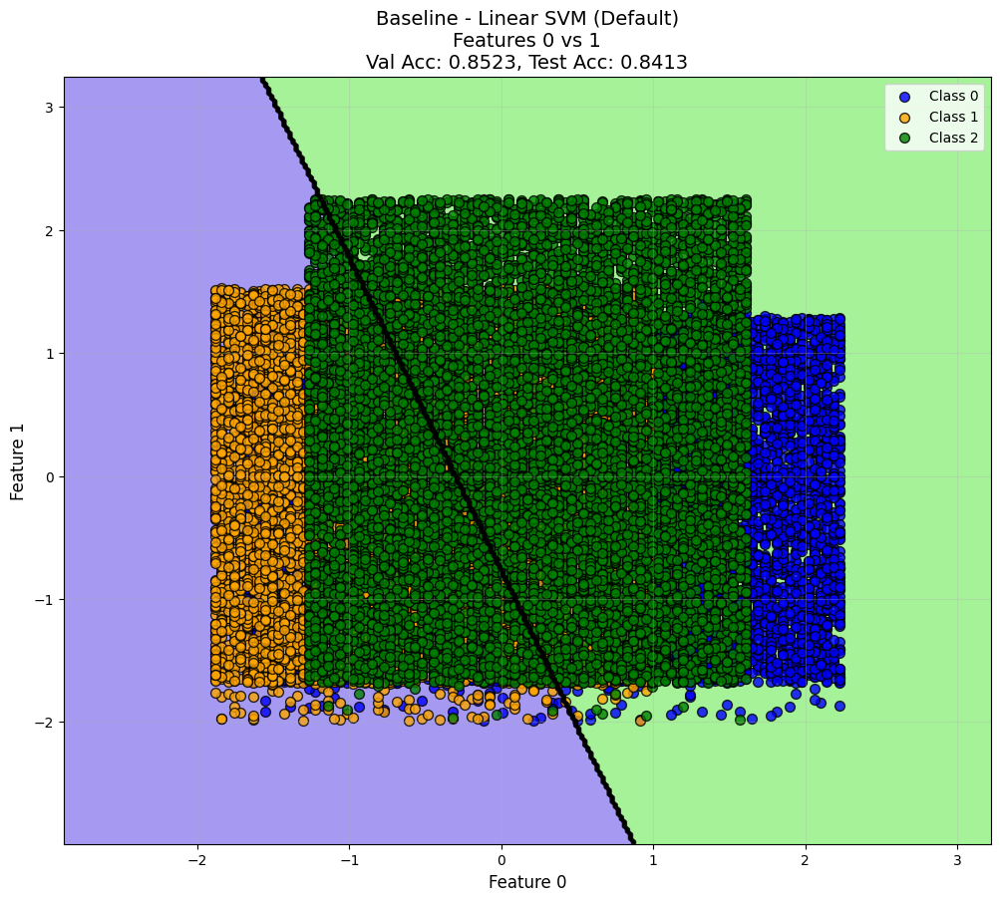

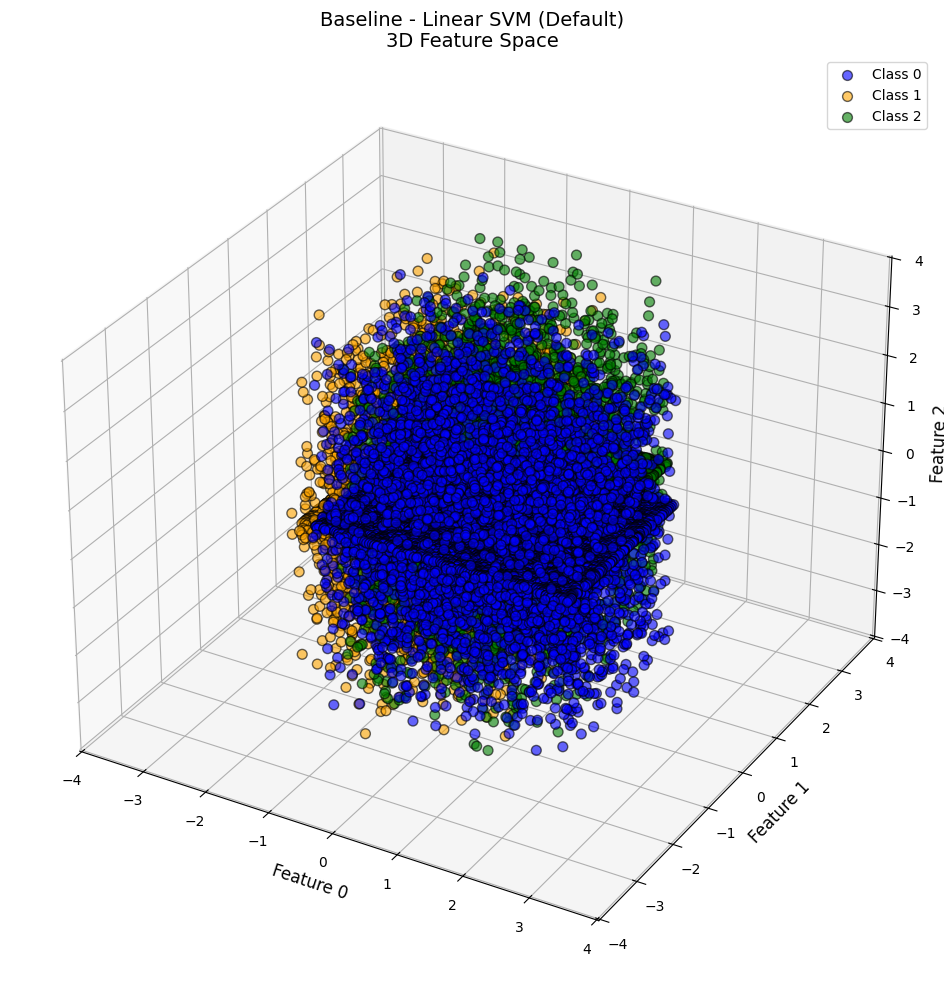


--- Baseline - Linear SVM (OvO) ---
Validation Accuracy: 0.8520
Test Accuracy: 0.8416
Confusion Matrix (Test Set):
[[2234  150  132]
 [ 173 2020  289]
 [ 202  242 2058]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.86      0.89      0.87      2516
     Class 1       0.84      0.81      0.83      2482
     Class 2       0.83      0.82      0.83      2502

    accuracy                           0.84      7500
   macro avg       0.84      0.84      0.84      7500
weighted avg       0.84      0.84      0.84      7500



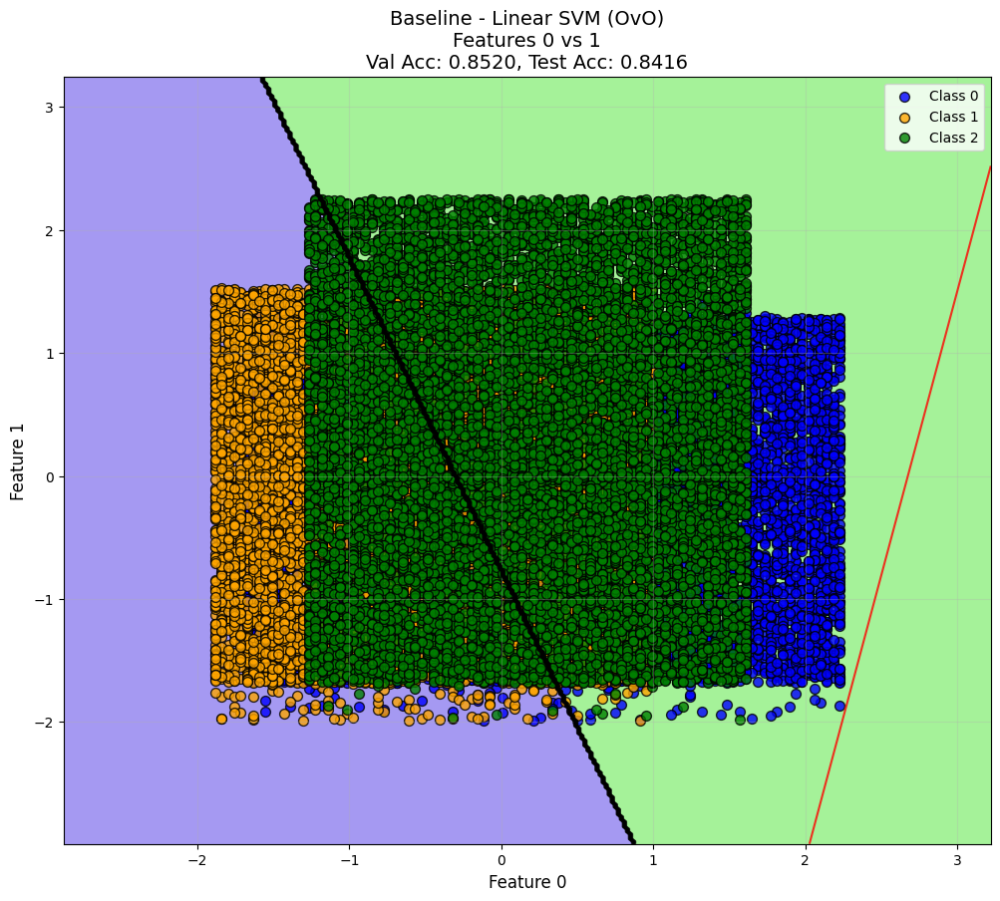

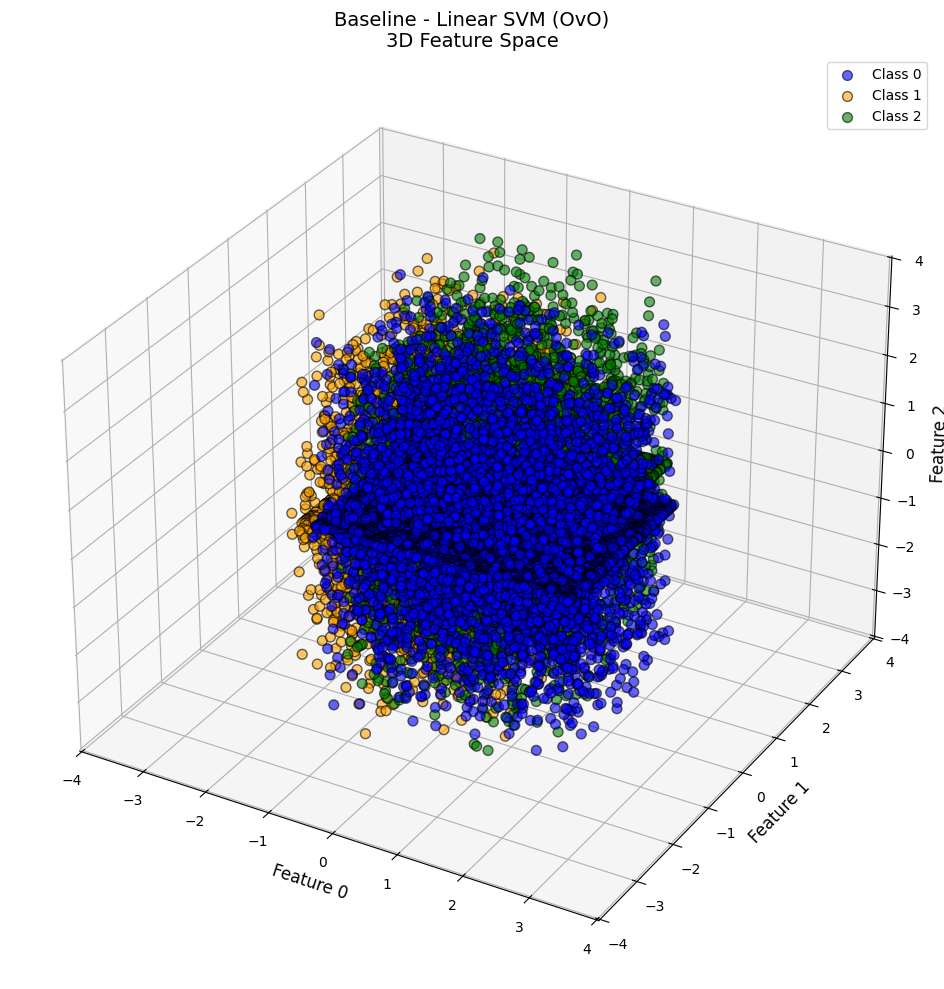


--- Baseline - Linear SVM (OvA) ---
Validation Accuracy: 0.8498
Test Accuracy: 0.8420
Confusion Matrix (Test Set):
[[2250  155  111]
 [ 176 2024  282]
 [ 219  242 2041]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.85      0.89      0.87      2516
     Class 1       0.84      0.82      0.83      2482
     Class 2       0.84      0.82      0.83      2502

    accuracy                           0.84      7500
   macro avg       0.84      0.84      0.84      7500
weighted avg       0.84      0.84      0.84      7500



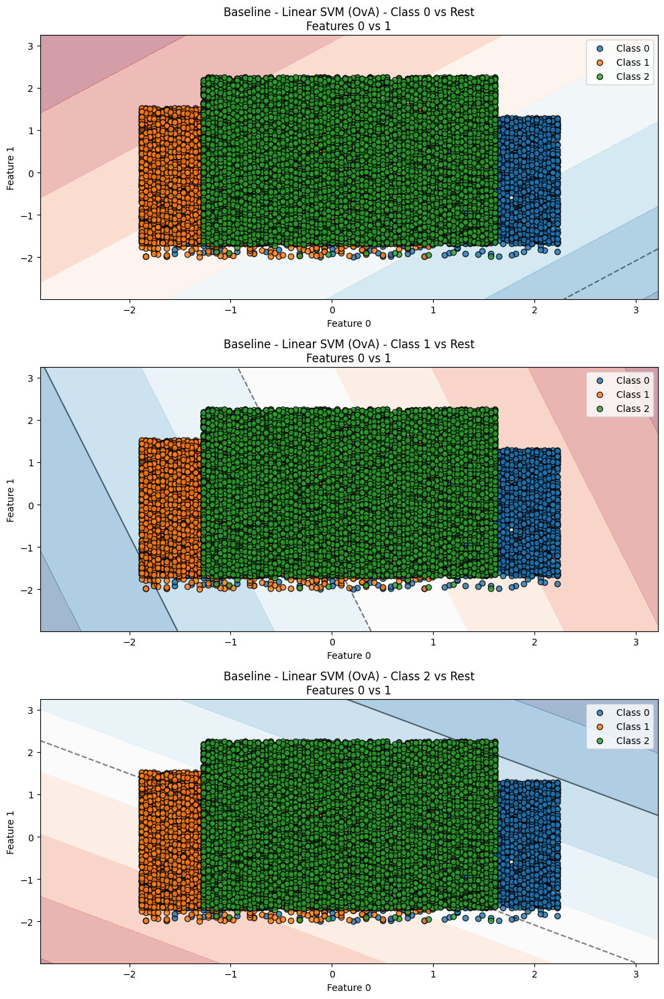

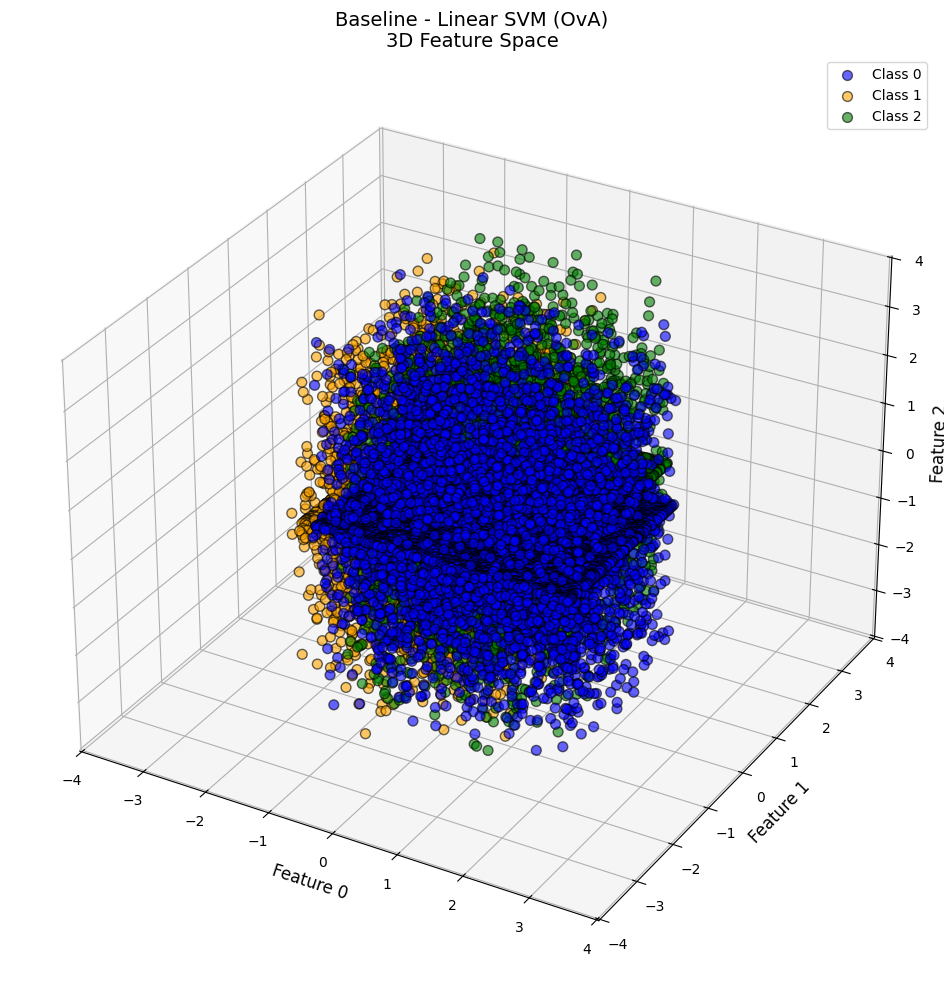


--- Baseline - Polynomial SVM (Default) ---
Validation Accuracy: 0.7630
Test Accuracy: 0.7603
Confusion Matrix (Test Set):
[[2038  274  204]
 [ 245 1914  323]
 [ 314  438 1750]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.78      0.81      0.80      2516
     Class 1       0.73      0.77      0.75      2482
     Class 2       0.77      0.70      0.73      2502

    accuracy                           0.76      7500
   macro avg       0.76      0.76      0.76      7500
weighted avg       0.76      0.76      0.76      7500



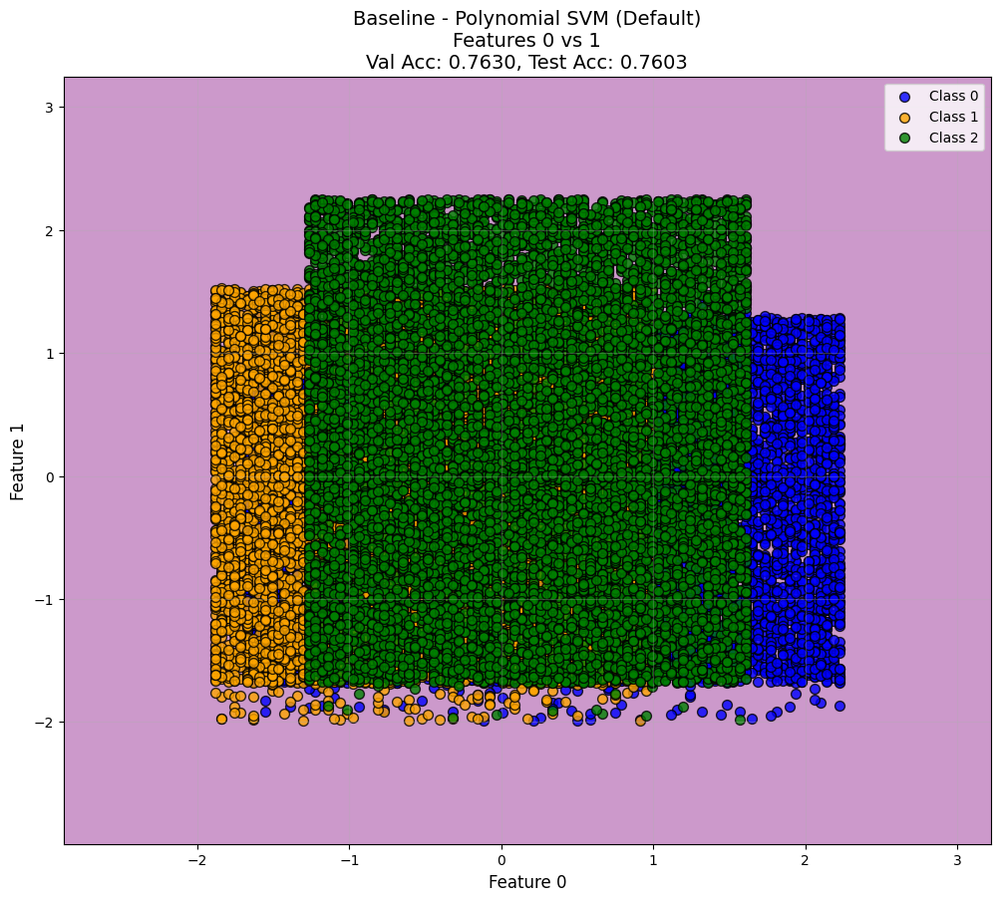

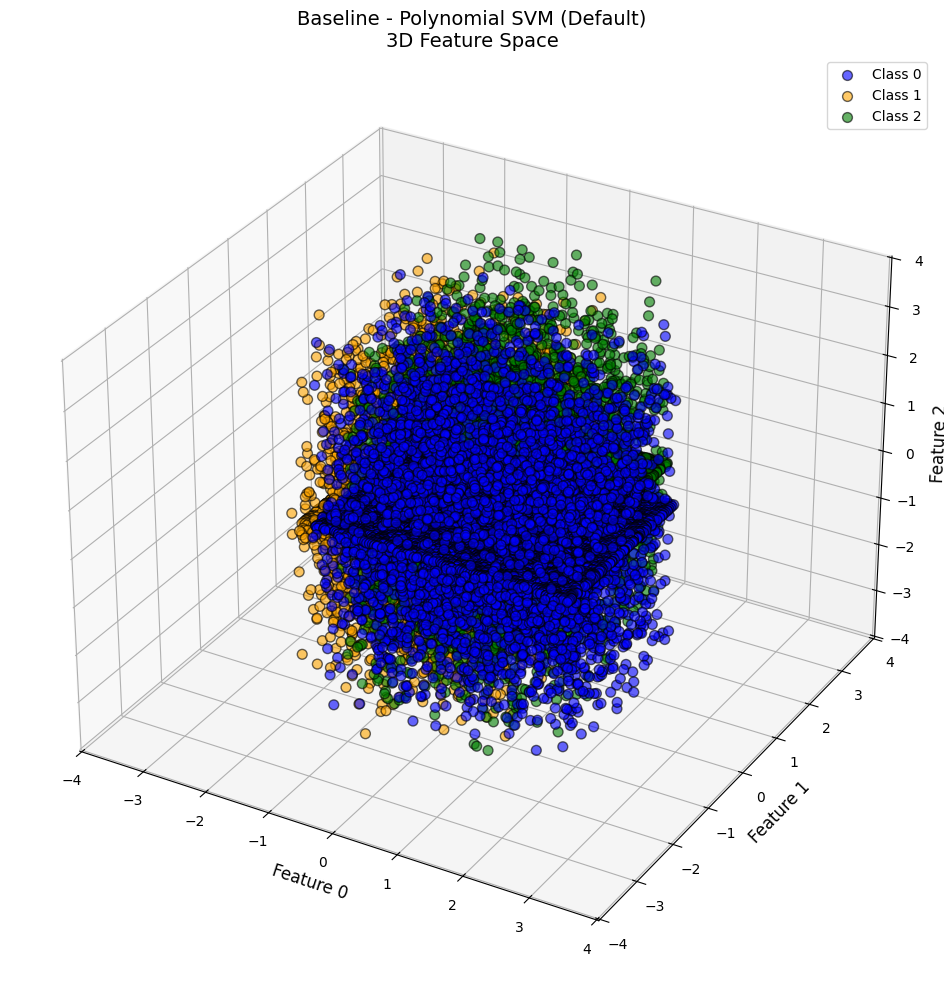


--- Baseline - Polynomial SVM (OvO) ---
Validation Accuracy: 0.7610
Test Accuracy: 0.7588
Confusion Matrix (Test Set):
[[2055  254  207]
 [ 244 1912  326]
 [ 312  466 1724]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.79      0.82      0.80      2516
     Class 1       0.73      0.77      0.75      2482
     Class 2       0.76      0.69      0.72      2502

    accuracy                           0.76      7500
   macro avg       0.76      0.76      0.76      7500
weighted avg       0.76      0.76      0.76      7500



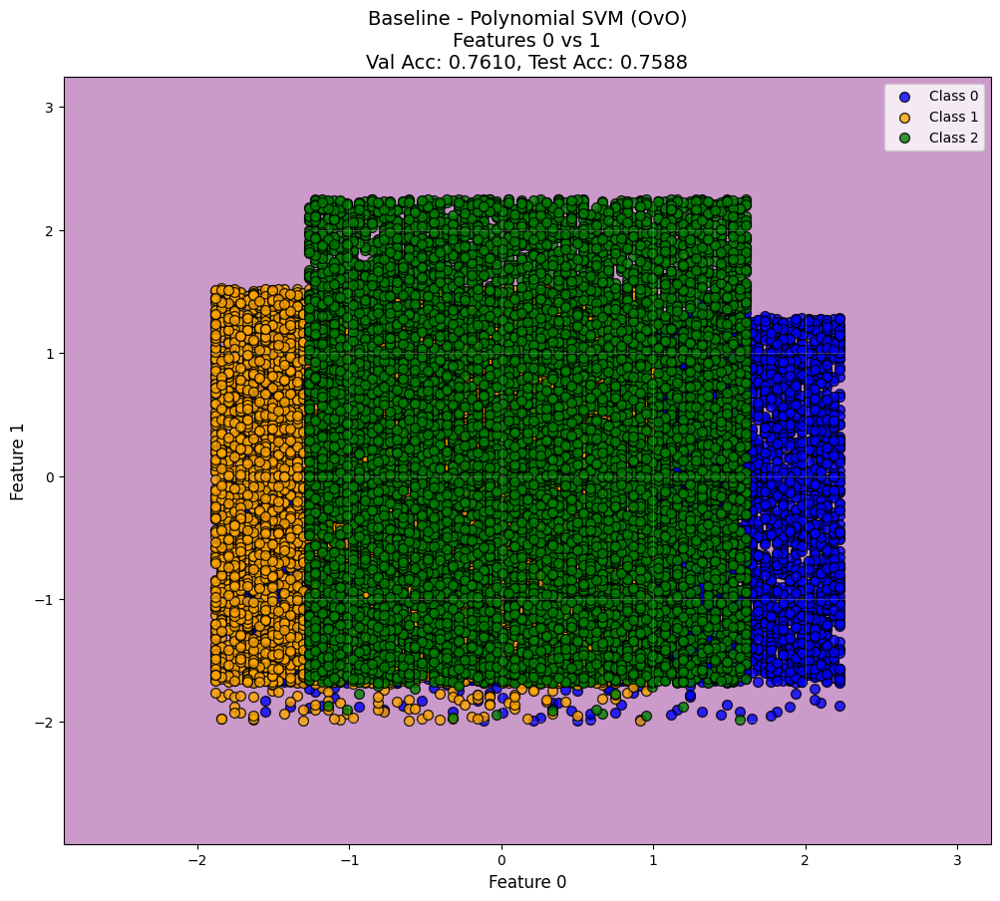

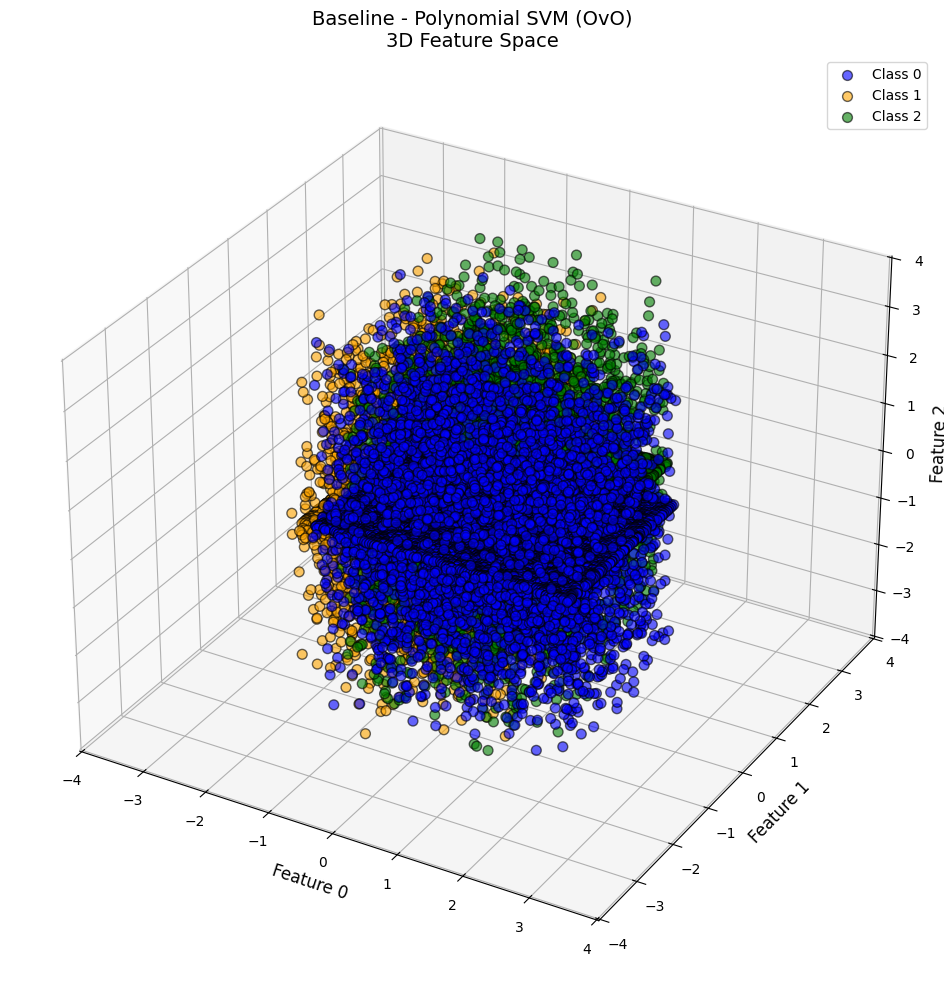


--- Baseline - Polynomial SVM (OvA) ---
Validation Accuracy: 0.7759
Test Accuracy: 0.7719
Confusion Matrix (Test Set):
[[2103  234  179]
 [ 261 1897  324]
 [ 323  390 1789]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.78      0.84      0.81      2516
     Class 1       0.75      0.76      0.76      2482
     Class 2       0.78      0.72      0.75      2502

    accuracy                           0.77      7500
   macro avg       0.77      0.77      0.77      7500
weighted avg       0.77      0.77      0.77      7500



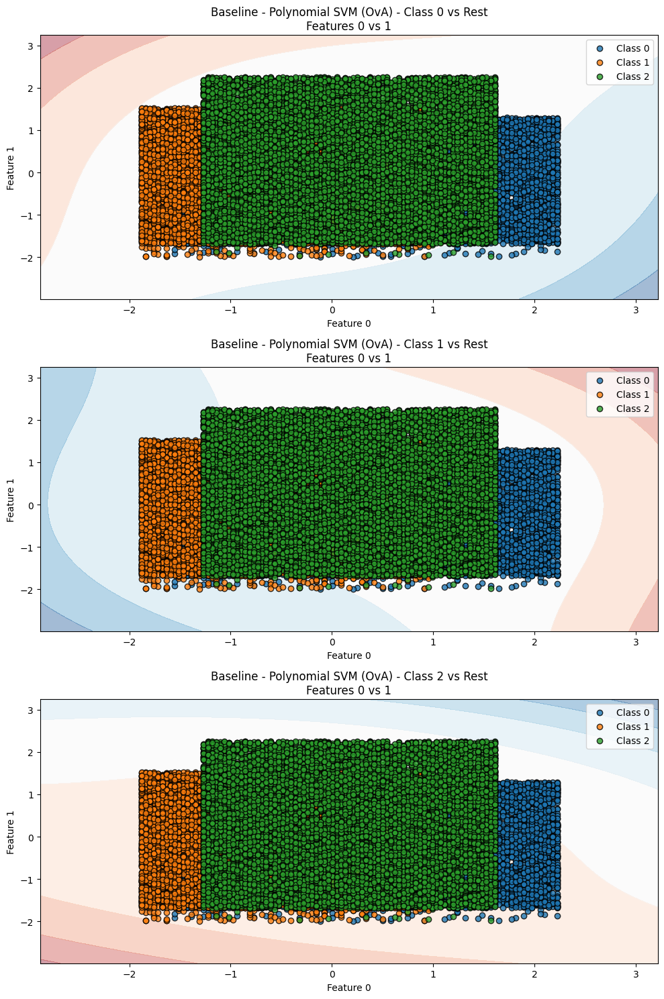

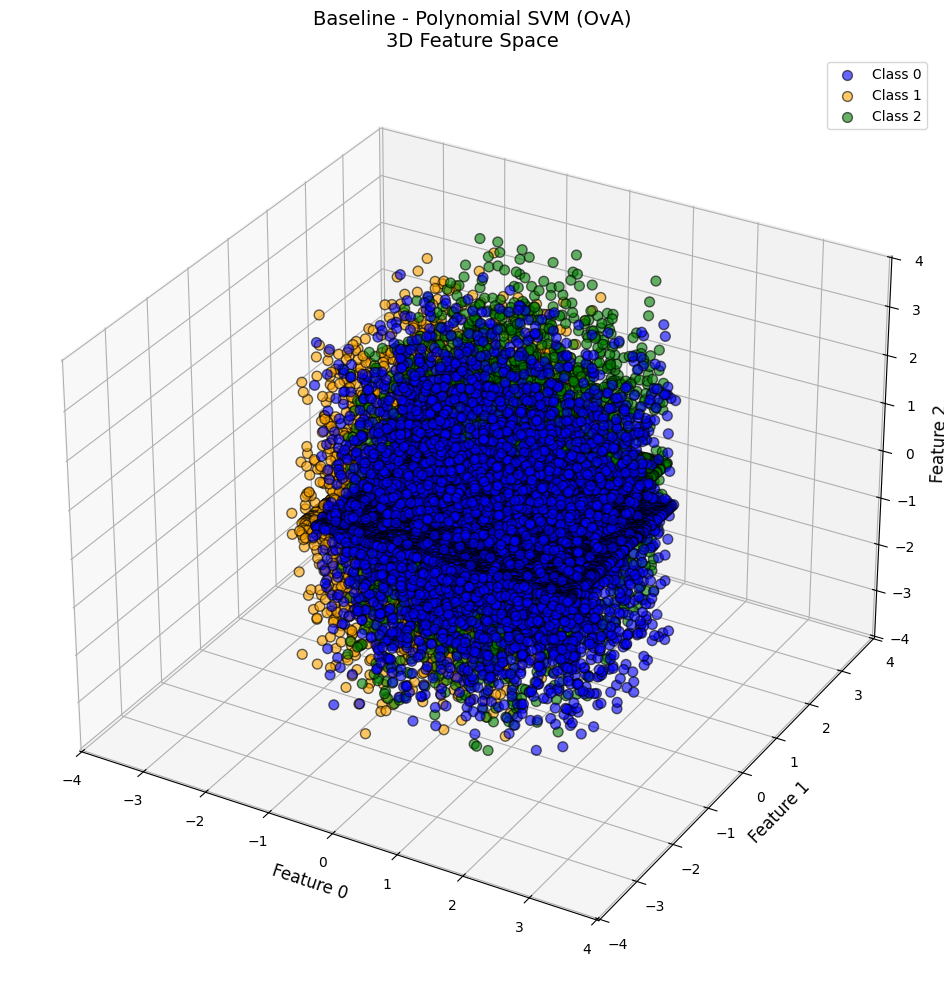


--- Baseline - Gaussian (RBF) SVM (Default) ---
Validation Accuracy: 0.8427
Test Accuracy: 0.8380
Confusion Matrix (Test Set):
[[2198  160  158]
 [ 172 2023  287]
 [ 201  237 2064]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.85      0.87      0.86      2516
     Class 1       0.84      0.82      0.83      2482
     Class 2       0.82      0.82      0.82      2502

    accuracy                           0.84      7500
   macro avg       0.84      0.84      0.84      7500
weighted avg       0.84      0.84      0.84      7500



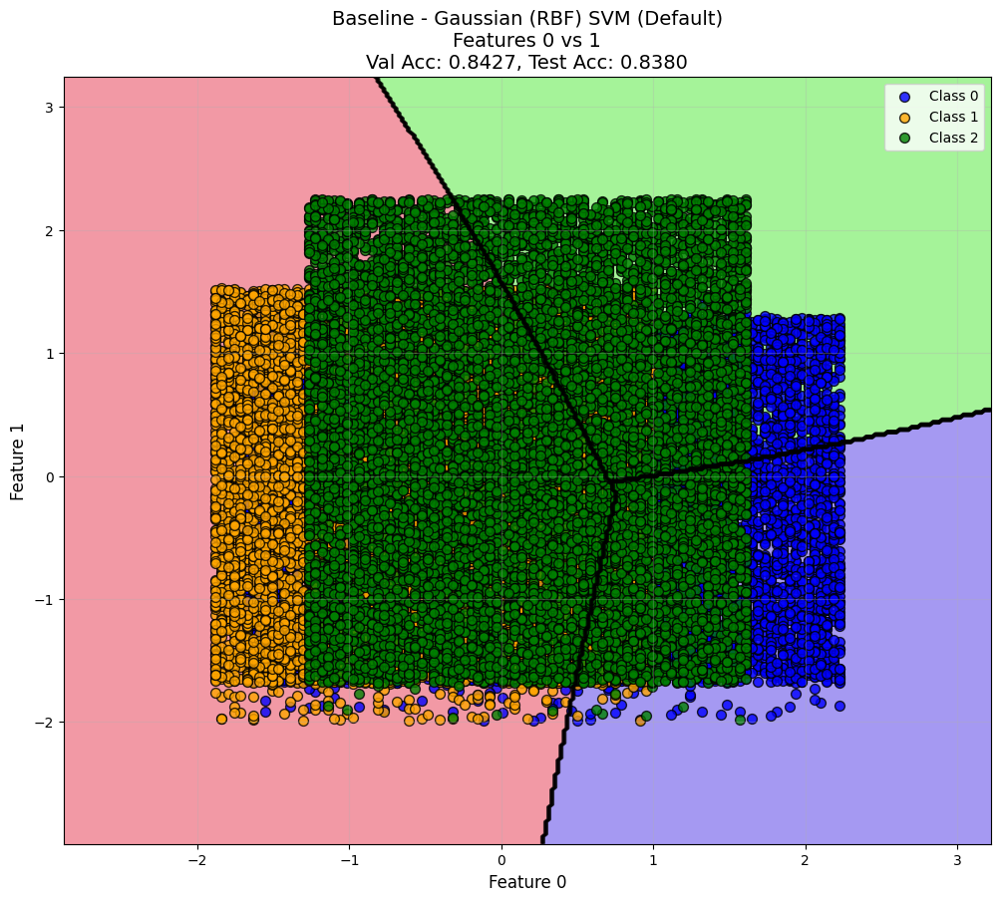

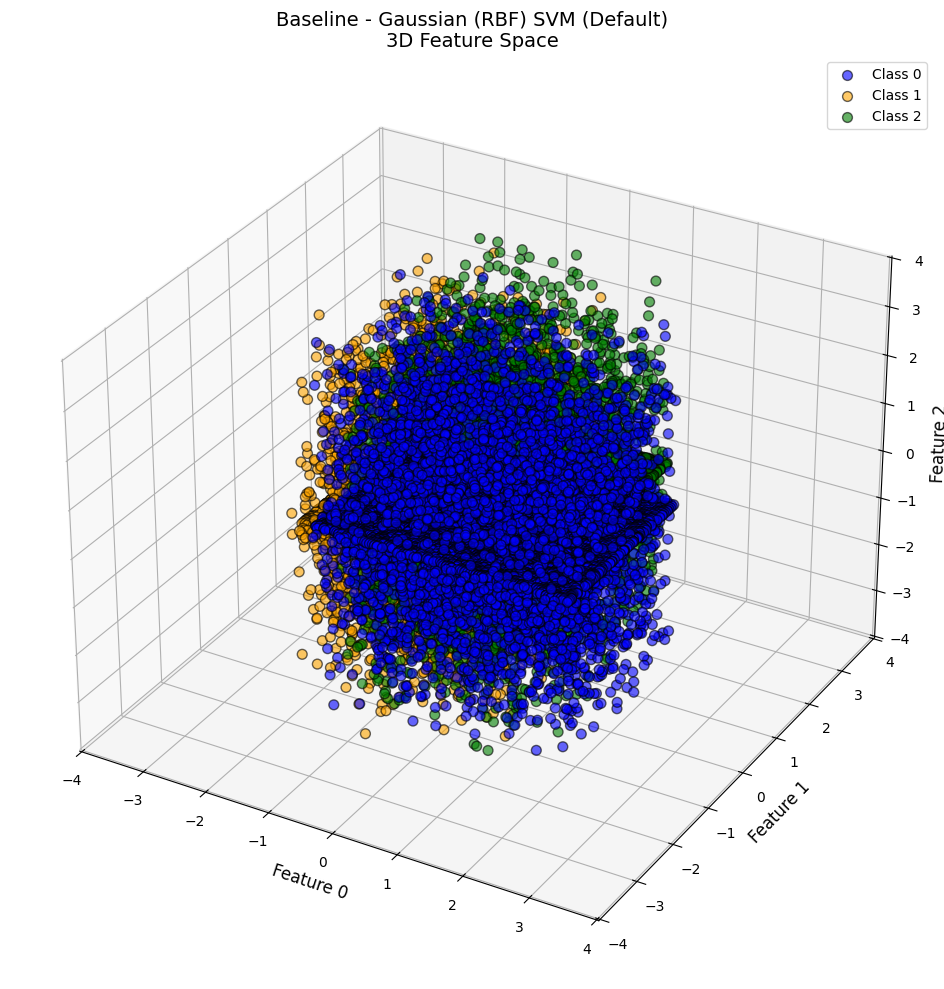


--- Baseline - Gaussian (RBF) SVM (OvO) ---
Validation Accuracy: 0.8410
Test Accuracy: 0.8384
Confusion Matrix (Test Set):
[[2192  165  159]
 [ 166 2027  289]
 [ 197  236 2069]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.86      0.87      0.86      2516
     Class 1       0.83      0.82      0.83      2482
     Class 2       0.82      0.83      0.82      2502

    accuracy                           0.84      7500
   macro avg       0.84      0.84      0.84      7500
weighted avg       0.84      0.84      0.84      7500



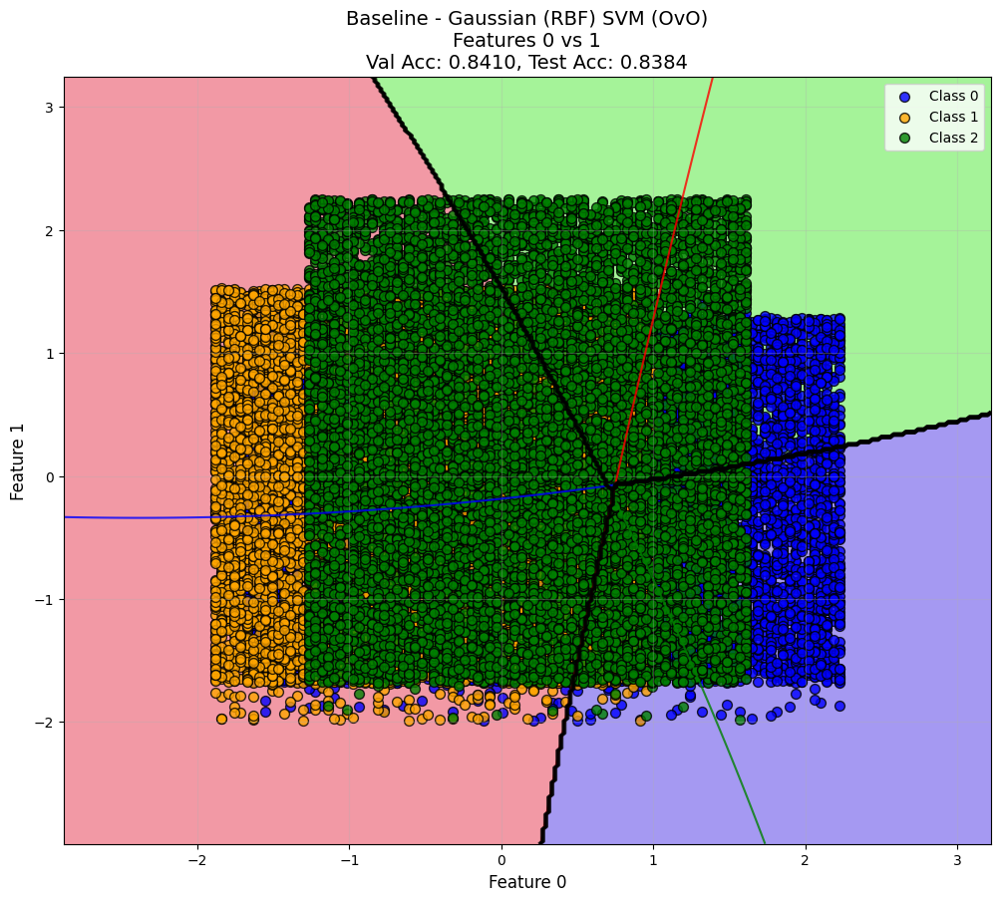

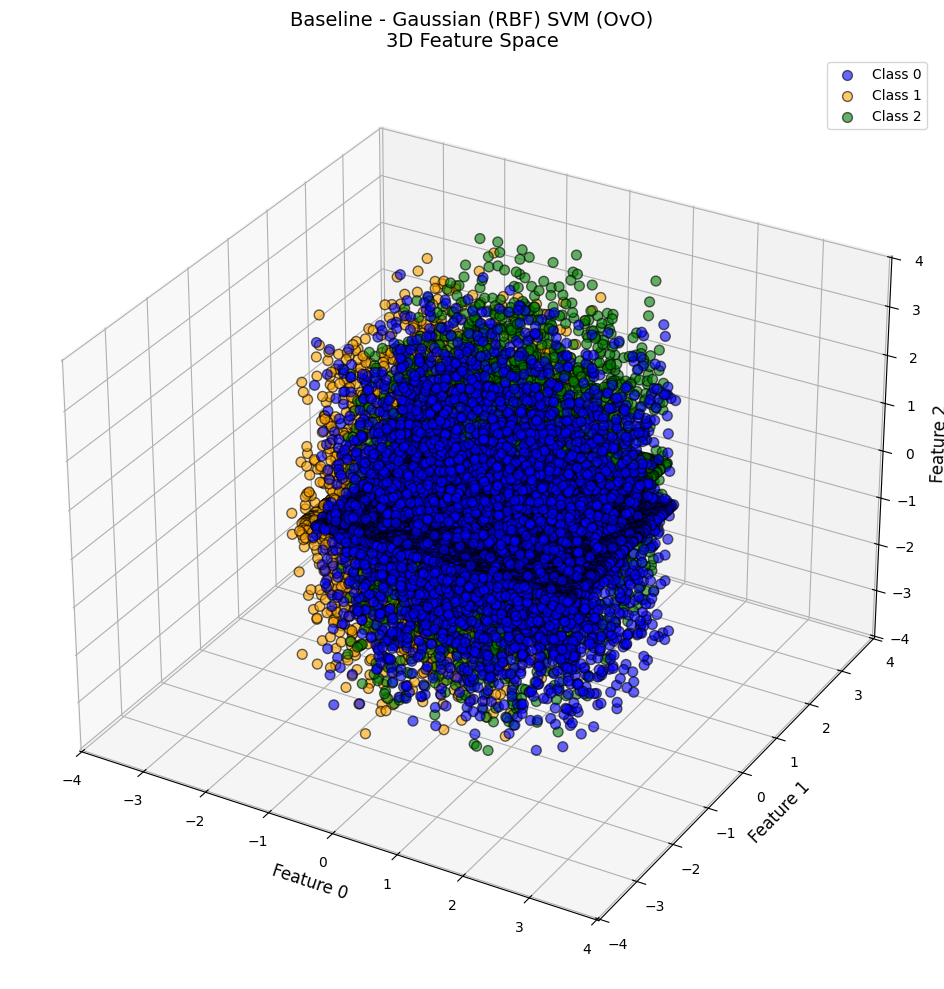


--- Baseline - Gaussian (RBF) SVM (OvA) ---
Validation Accuracy: 0.8422
Test Accuracy: 0.8400
Confusion Matrix (Test Set):
[[2206  159  151]
 [ 177 2025  280]
 [ 196  237 2069]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.86      0.88      0.87      2516
     Class 1       0.84      0.82      0.83      2482
     Class 2       0.83      0.83      0.83      2502

    accuracy                           0.84      7500
   macro avg       0.84      0.84      0.84      7500
weighted avg       0.84      0.84      0.84      7500



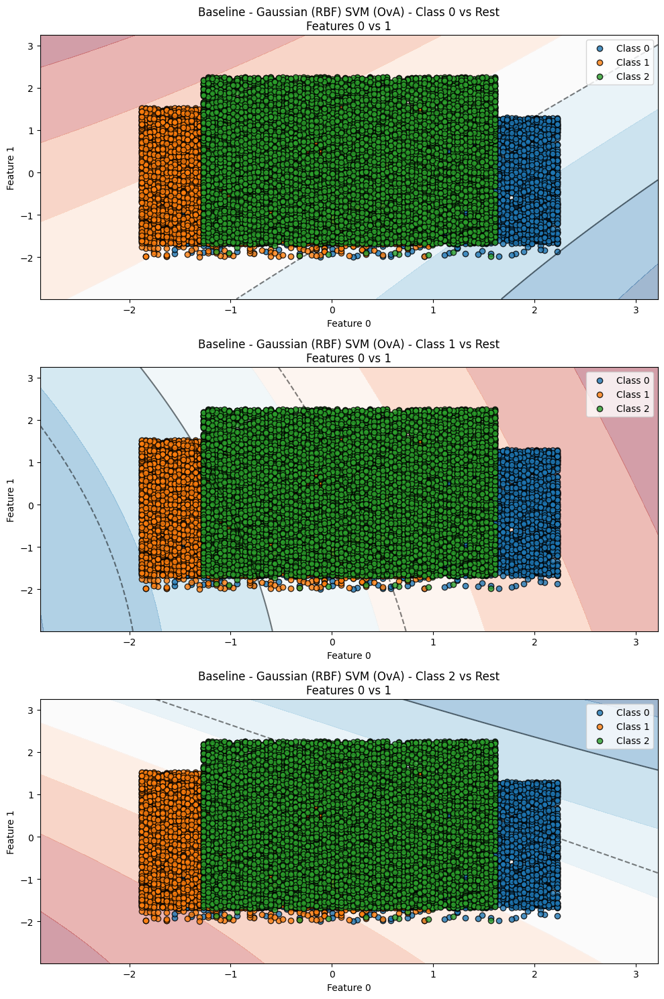

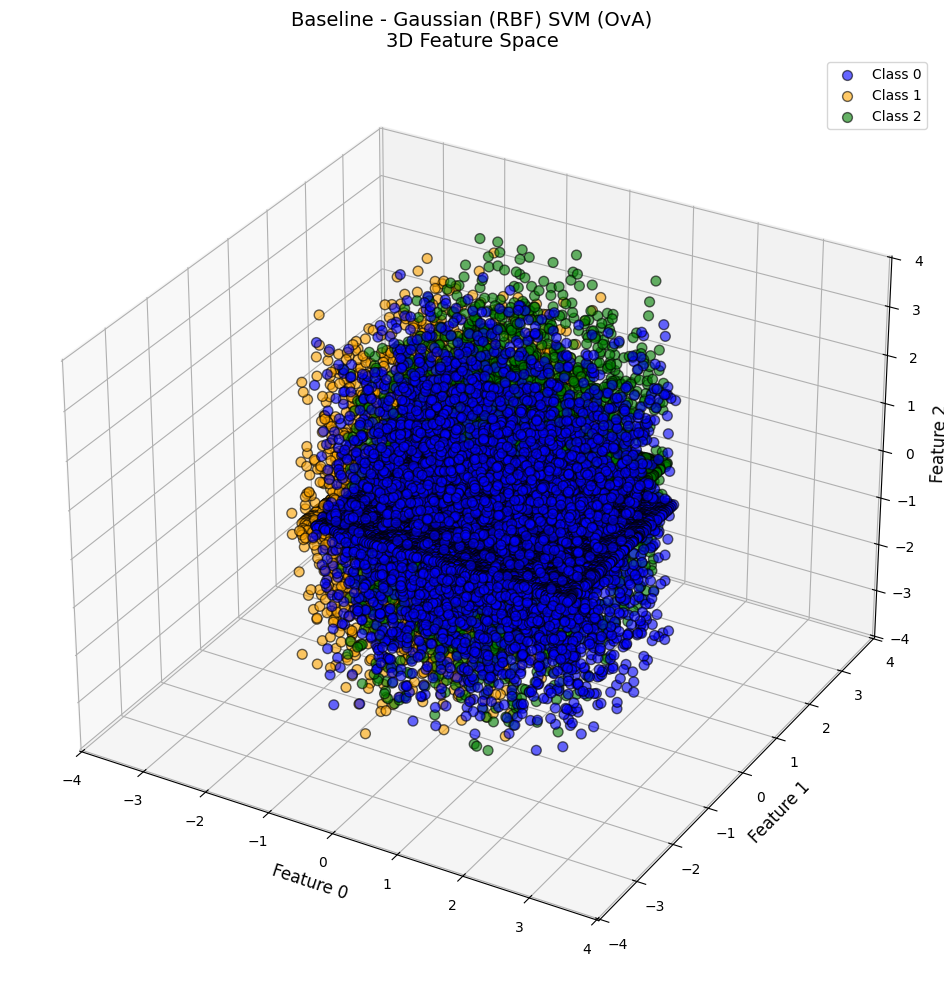

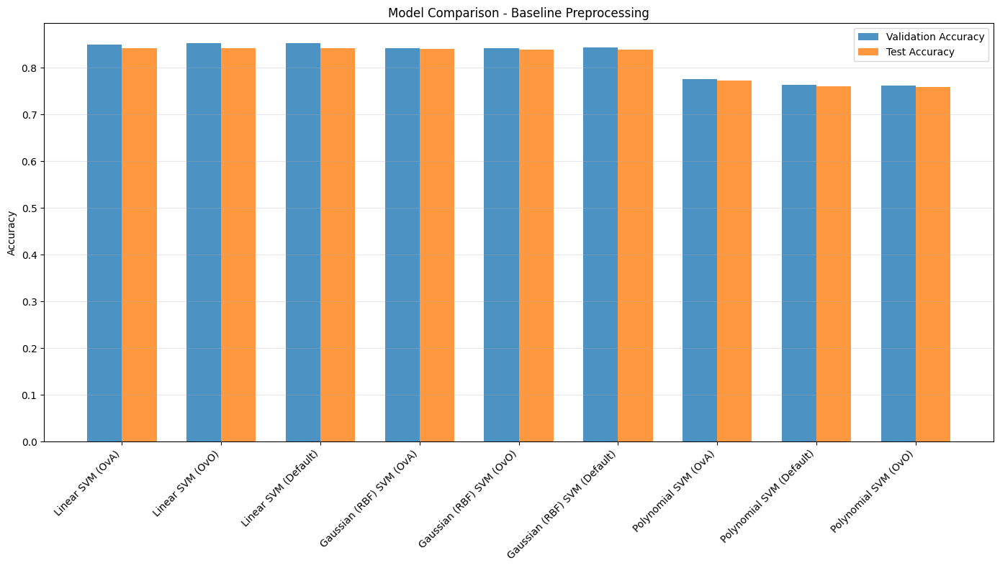


PREPROCESSING: PCA

--- PCA - Linear SVM (Default) ---
Validation Accuracy: 0.8528
Test Accuracy: 0.8407
Confusion Matrix (Test Set):
[[2230  151  135]
 [ 167 2016  299]
 [ 205  238 2059]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.86      0.89      0.87      2516
     Class 1       0.84      0.81      0.83      2482
     Class 2       0.83      0.82      0.82      2502

    accuracy                           0.84      7500
   macro avg       0.84      0.84      0.84      7500
weighted avg       0.84      0.84      0.84      7500



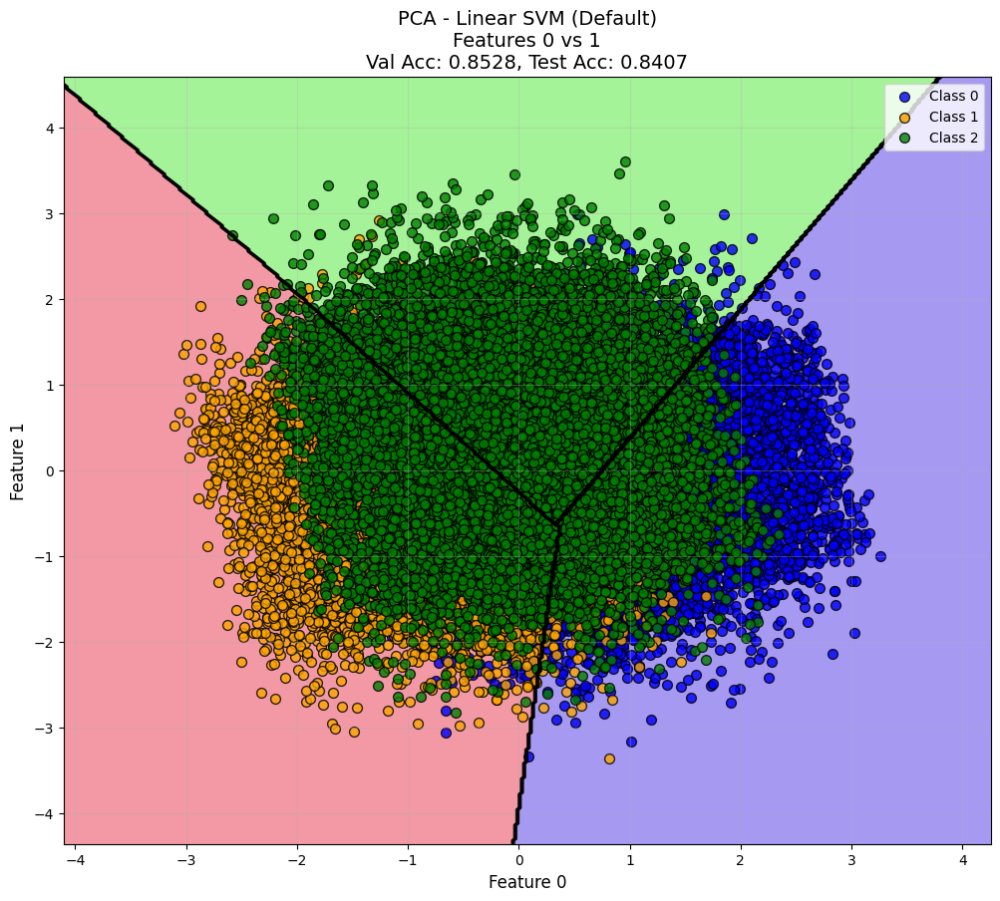

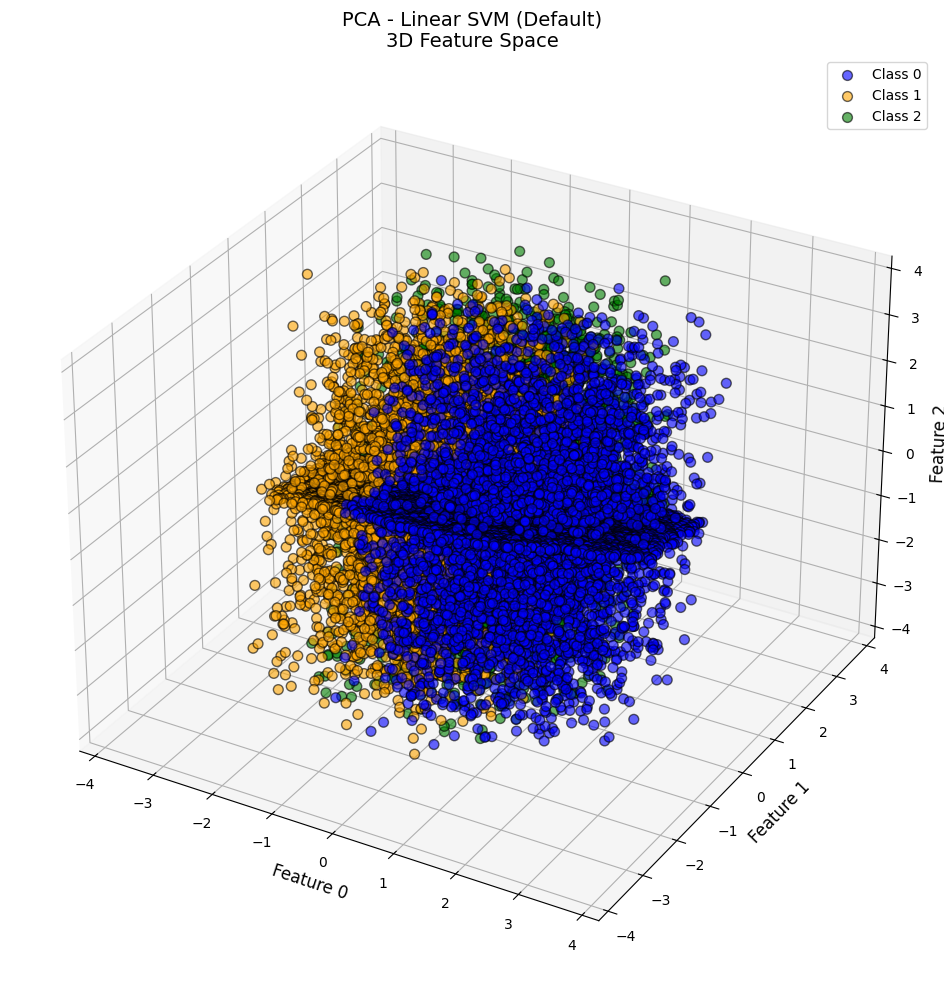


--- PCA - Linear SVM (OvO) ---
Validation Accuracy: 0.8520
Test Accuracy: 0.8411
Confusion Matrix (Test Set):
[[2227  151  138]
 [ 163 2019  300]
 [ 201  239 2062]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.86      0.89      0.87      2516
     Class 1       0.84      0.81      0.83      2482
     Class 2       0.82      0.82      0.82      2502

    accuracy                           0.84      7500
   macro avg       0.84      0.84      0.84      7500
weighted avg       0.84      0.84      0.84      7500



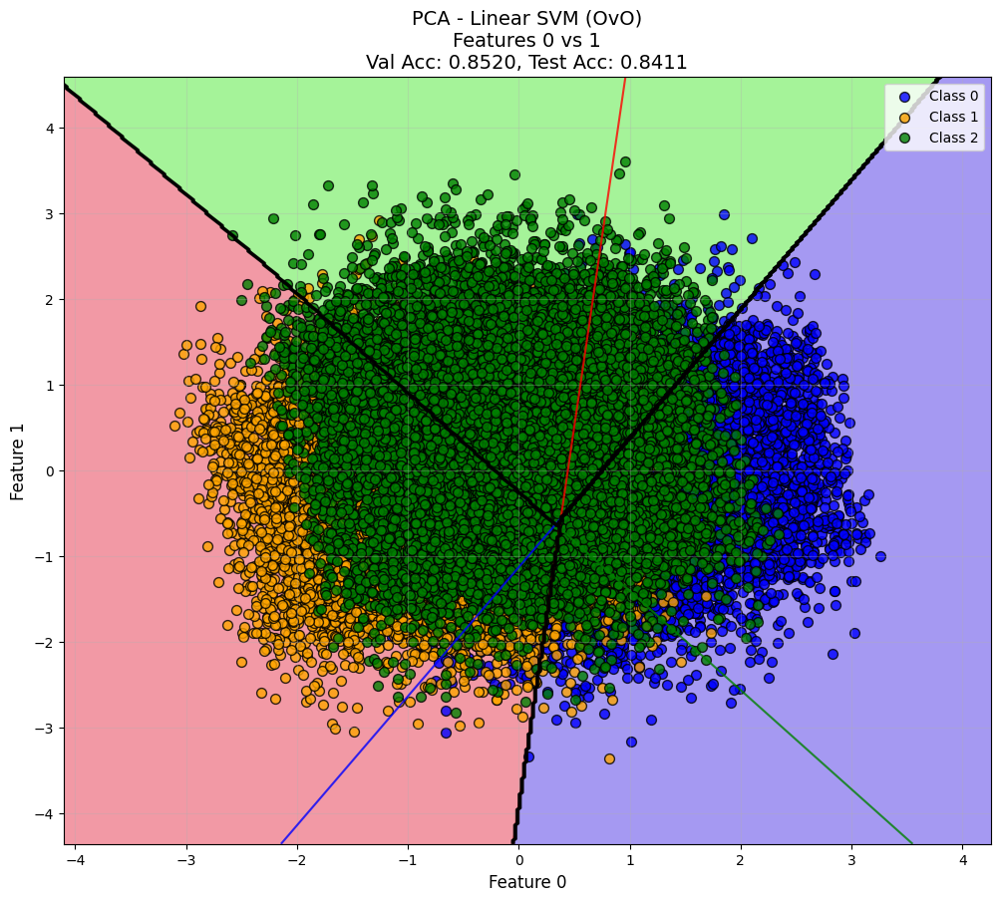

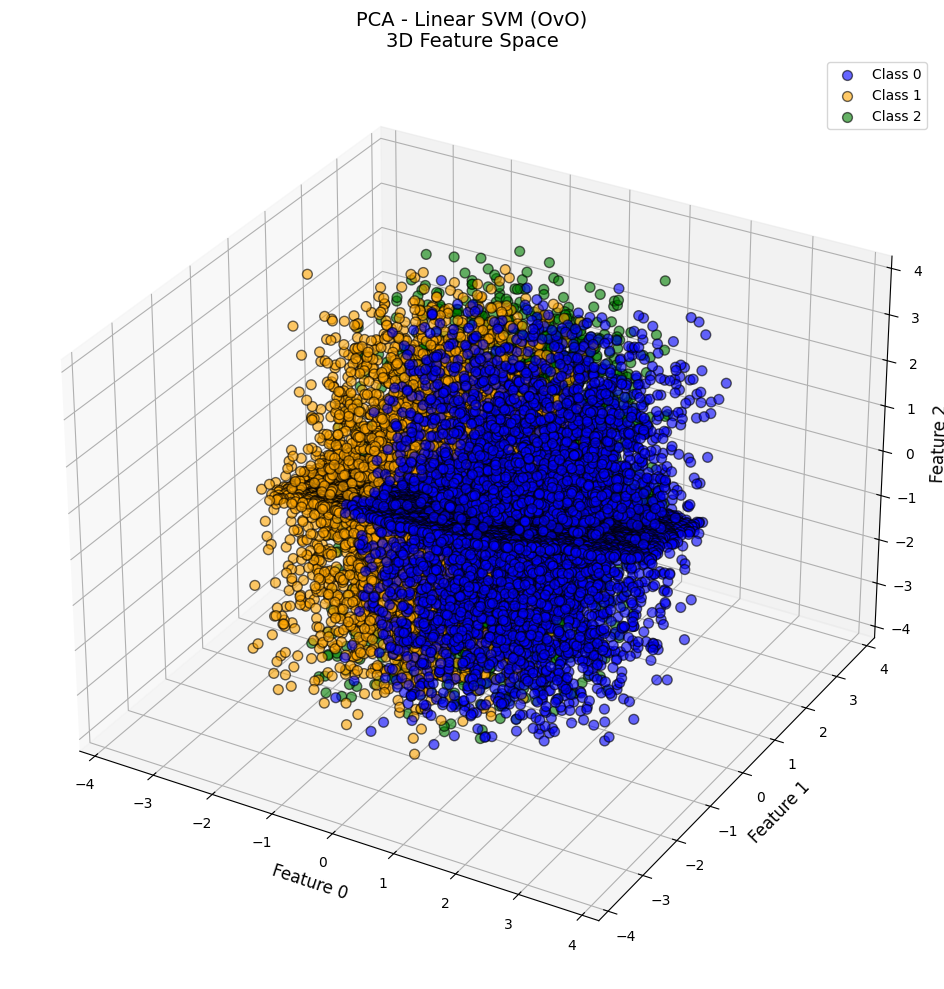


--- PCA - Linear SVM (OvA) ---
Validation Accuracy: 0.8490
Test Accuracy: 0.8421
Confusion Matrix (Test Set):
[[2248  155  113]
 [ 174 2025  283]
 [ 220  239 2043]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.85      0.89      0.87      2516
     Class 1       0.84      0.82      0.83      2482
     Class 2       0.84      0.82      0.83      2502

    accuracy                           0.84      7500
   macro avg       0.84      0.84      0.84      7500
weighted avg       0.84      0.84      0.84      7500



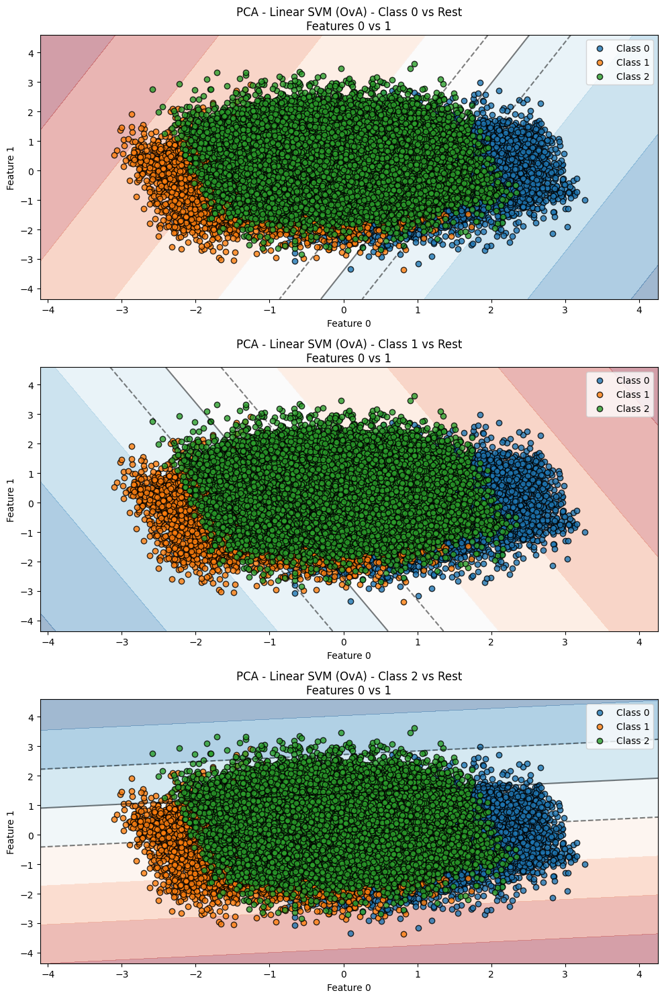

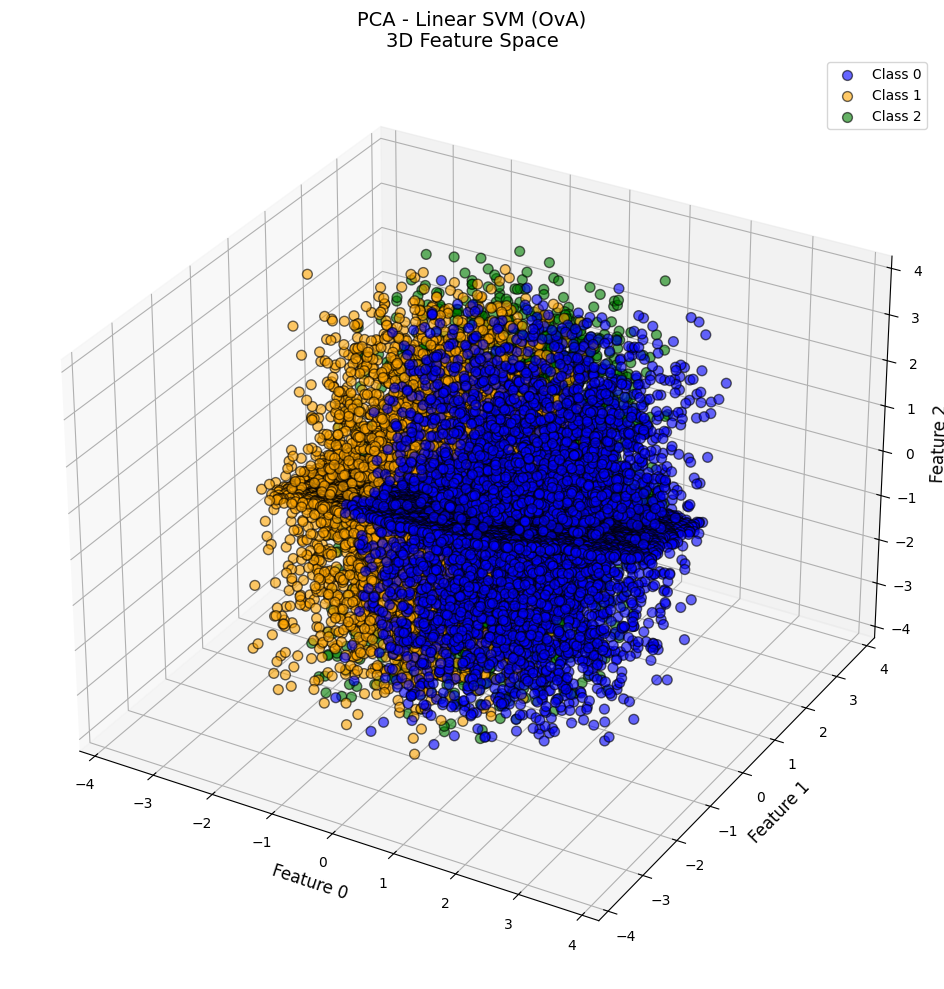


--- PCA - Polynomial SVM (Default) ---
Validation Accuracy: 0.7145
Test Accuracy: 0.7197
Confusion Matrix (Test Set):
[[1901  347  268]
 [ 303 1849  330]
 [ 376  478 1648]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.74      0.76      0.75      2516
     Class 1       0.69      0.74      0.72      2482
     Class 2       0.73      0.66      0.69      2502

    accuracy                           0.72      7500
   macro avg       0.72      0.72      0.72      7500
weighted avg       0.72      0.72      0.72      7500



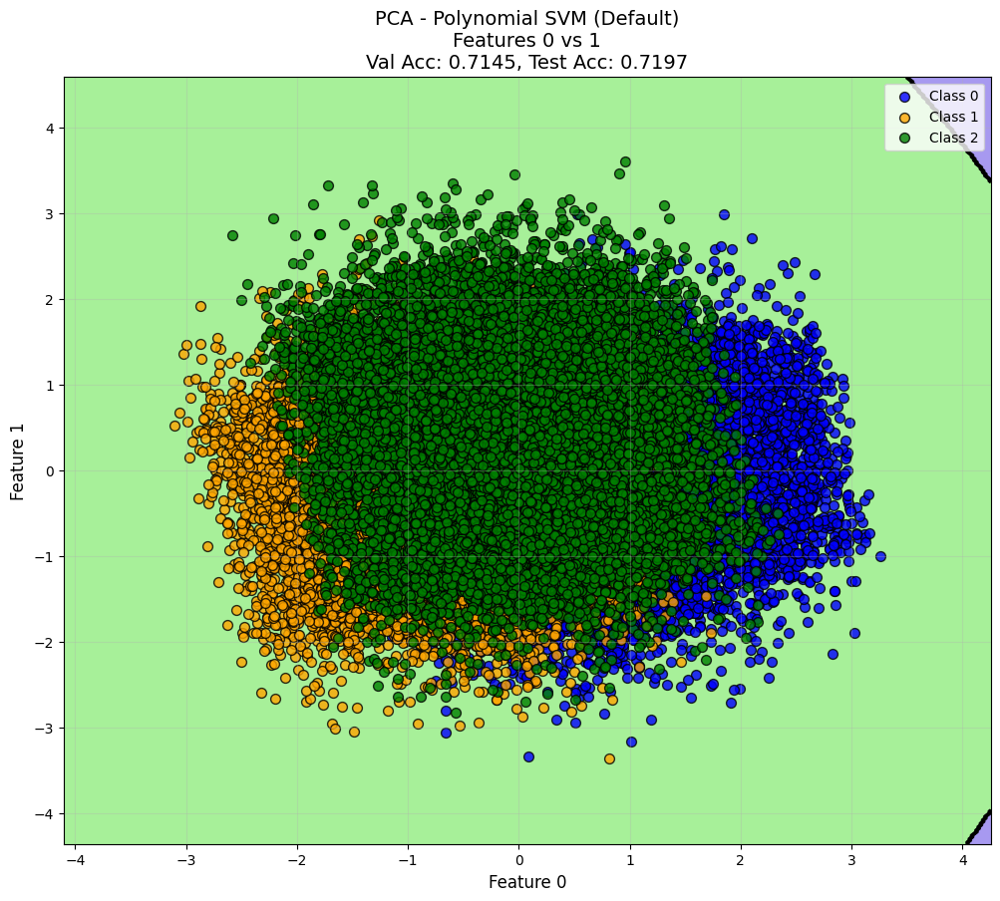

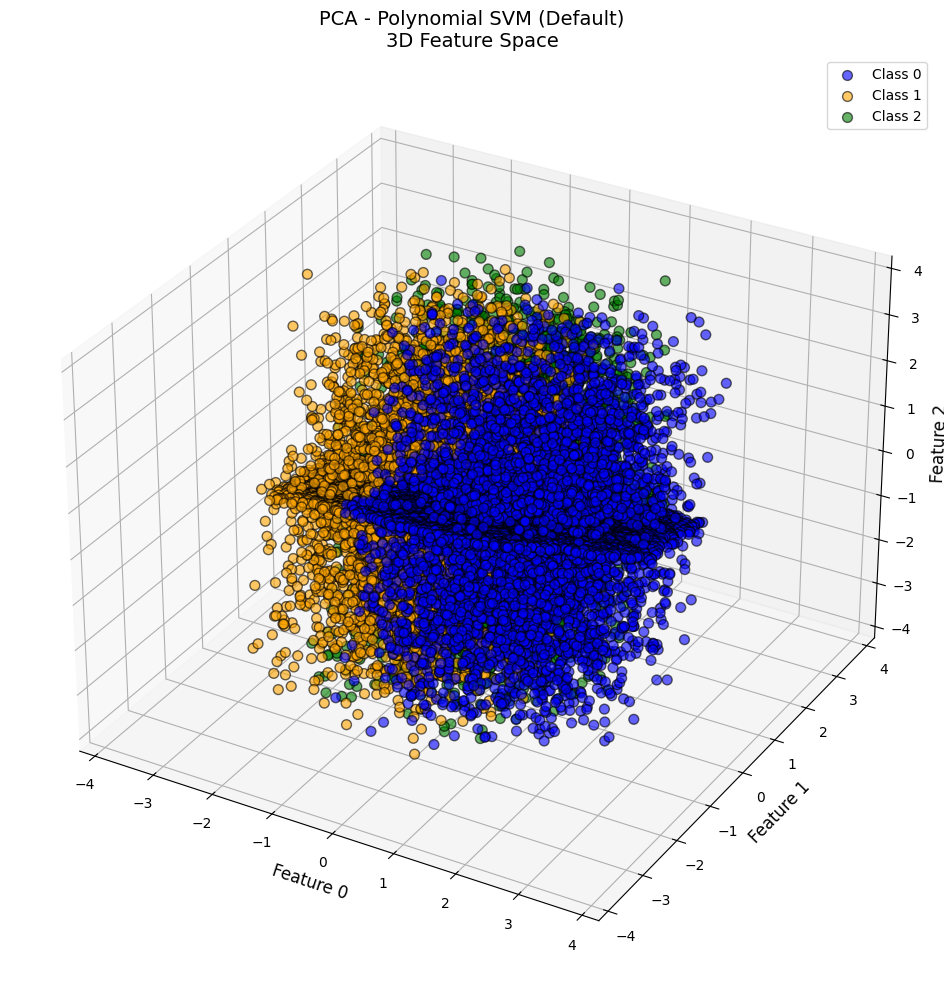


--- PCA - Polynomial SVM (OvO) ---
Validation Accuracy: 0.7130
Test Accuracy: 0.7199
Confusion Matrix (Test Set):
[[1915  335  266]
 [ 294 1859  329]
 [ 388  489 1625]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.74      0.76      0.75      2516
     Class 1       0.69      0.75      0.72      2482
     Class 2       0.73      0.65      0.69      2502

    accuracy                           0.72      7500
   macro avg       0.72      0.72      0.72      7500
weighted avg       0.72      0.72      0.72      7500



KeyboardInterrupt: 

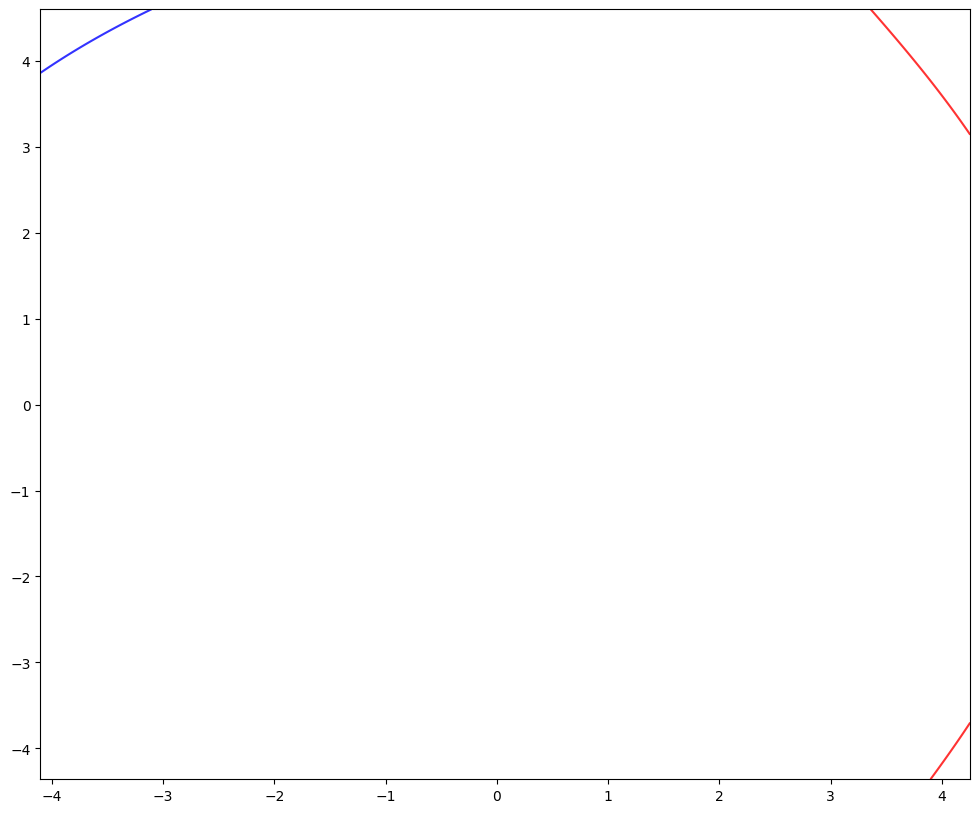

In [ ]:
# Define your preprocessing data
preprocessing_data = {
    'Baseline': {
        'X_train': X_train_baseline,
        'X_val': X_val_baseline,
        'X_test': X_test_baseline
    },
    'PCA': {
        'X_train': X_train_pca,
        'X_val': X_val_pca,
        'X_test': X_test_pca
    },
    'GA': {
        'X_train': X_train_ga,
        'X_val': X_val_ga,
        'X_test': X_test_ga
    }
}

# Run analysis
analyzer = SVMAnalyzer(preprocessing_data, y_train, y_val, y_test)
analyzer.run_comprehensive_analysis()




=== SVM Classification Performance ===


--- Linear SVM (Default) ---
Validation Accuracy: 0.7031
Test Accuracy: 0.6923
Confusion Matrix (Test Set):
[[1842  447  227]
 [ 604 1402  439]
 [ 338  242 1923]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.66      0.73      0.70      2516
     Class 1       0.67      0.57      0.62      2445
     Class 2       0.74      0.77      0.76      2503

    accuracy                           0.69      7464
   macro avg       0.69      0.69      0.69      7464
weighted avg       0.69      0.69      0.69      7464



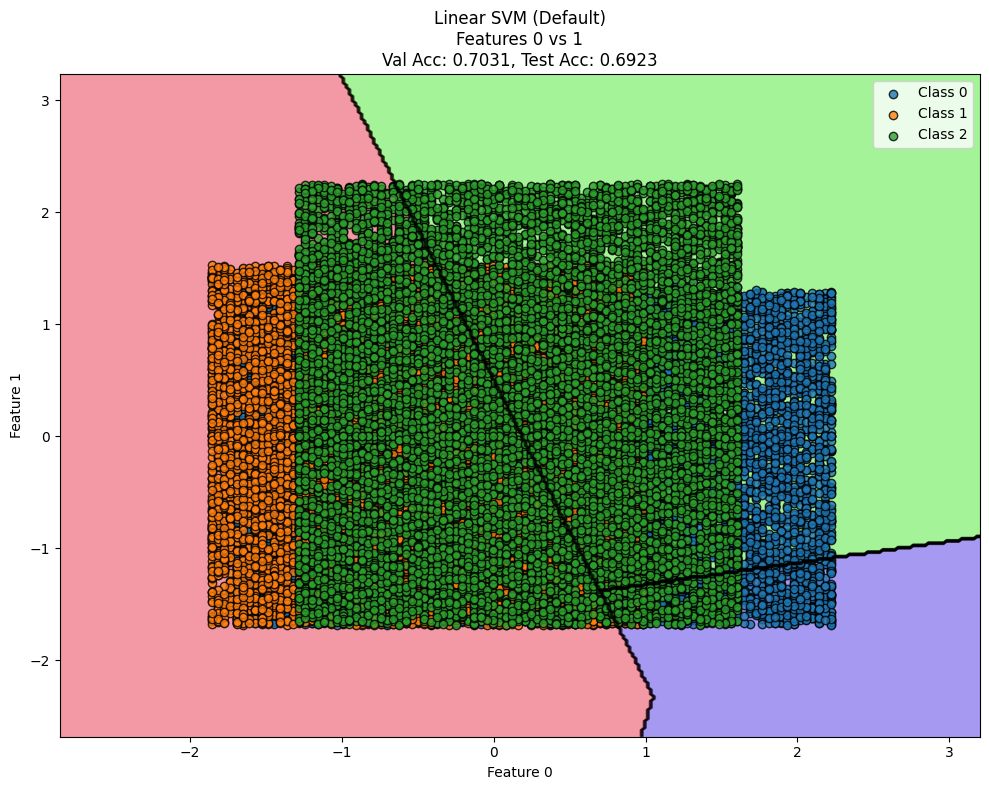


--- Linear SVM (OvO) ---
Validation Accuracy: 0.7035
Test Accuracy: 0.6925
Confusion Matrix (Test Set):
[[1840  449  227]
 [ 600 1405  440]
 [ 336  243 1924]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.66      0.73      0.70      2516
     Class 1       0.67      0.57      0.62      2445
     Class 2       0.74      0.77      0.76      2503

    accuracy                           0.69      7464
   macro avg       0.69      0.69      0.69      7464
weighted avg       0.69      0.69      0.69      7464



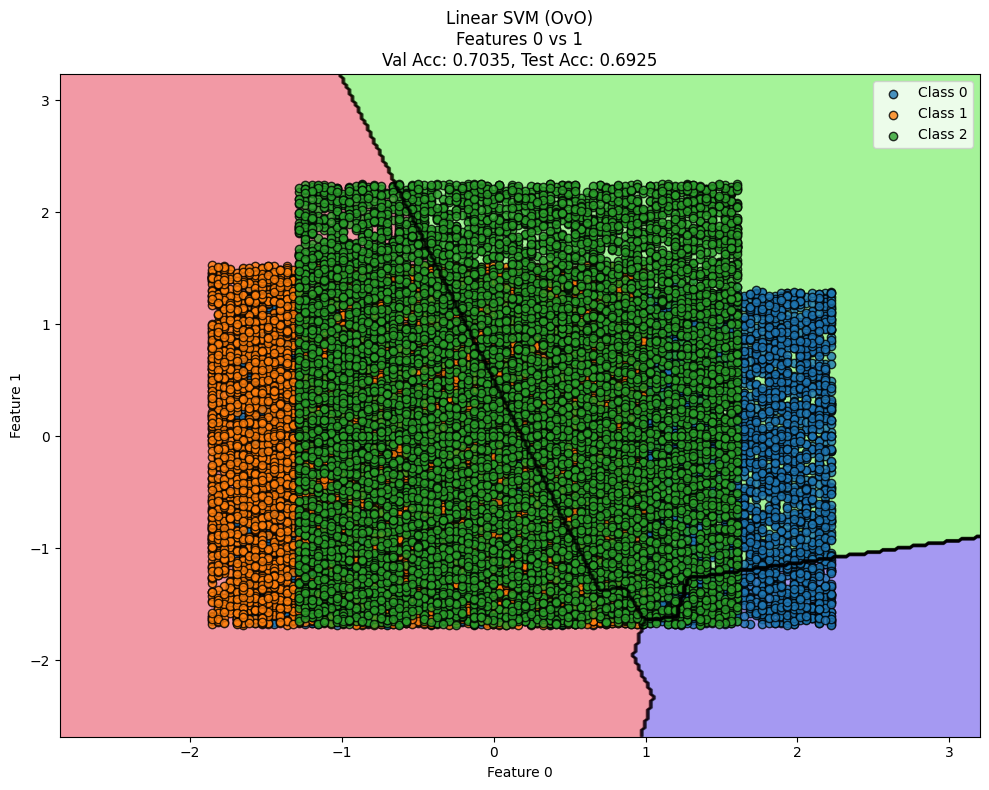


--- Linear SVM (OvA) ---
Validation Accuracy: 0.7009
Test Accuracy: 0.6852
Confusion Matrix (Test Set):
[[1786  496  234]
 [ 566 1393  486]
 [ 342  226 1935]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.66      0.71      0.69      2516
     Class 1       0.66      0.57      0.61      2445
     Class 2       0.73      0.77      0.75      2503

    accuracy                           0.69      7464
   macro avg       0.68      0.68      0.68      7464
weighted avg       0.68      0.69      0.68      7464



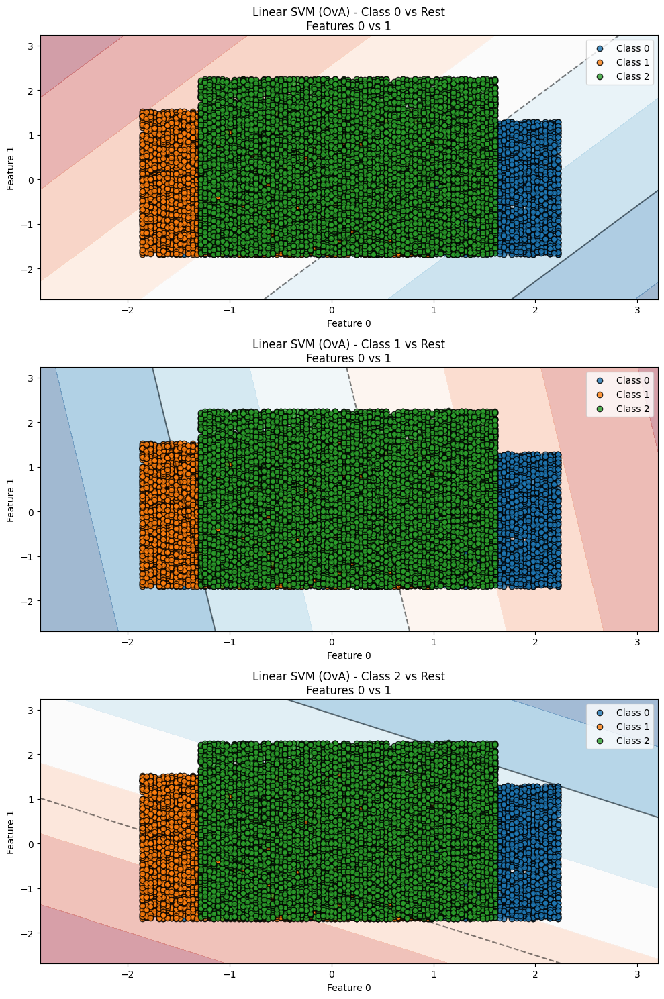


--- Polynomial SVM (Default) ---
Validation Accuracy: 0.7565
Test Accuracy: 0.7456
Confusion Matrix (Test Set):
[[1822  469  225]
 [ 613 1556  276]
 [ 139  177 2187]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.71      0.72      0.72      2516
     Class 1       0.71      0.64      0.67      2445
     Class 2       0.81      0.87      0.84      2503

    accuracy                           0.75      7464
   macro avg       0.74      0.74      0.74      7464
weighted avg       0.74      0.75      0.74      7464



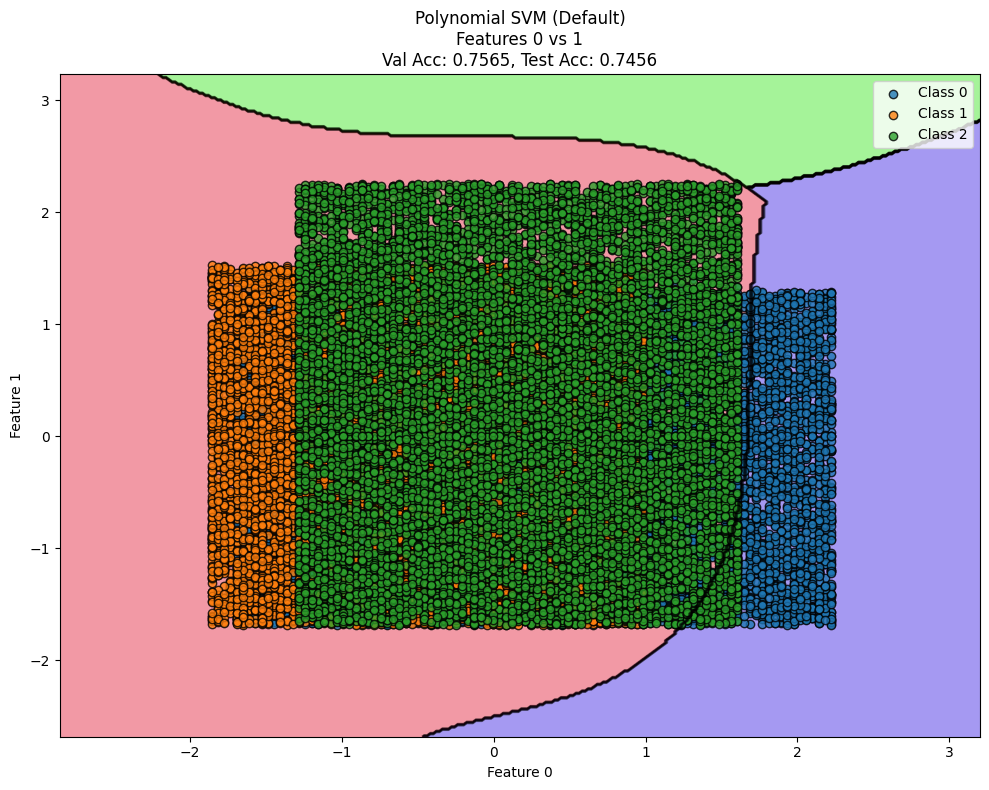


--- Polynomial SVM (OvO) ---
Validation Accuracy: 0.7564
Test Accuracy: 0.7472
Confusion Matrix (Test Set):
[[1824  467  225]
 [ 602 1563  280]
 [ 131  182 2190]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.71      0.72      0.72      2516
     Class 1       0.71      0.64      0.67      2445
     Class 2       0.81      0.87      0.84      2503

    accuracy                           0.75      7464
   macro avg       0.74      0.75      0.74      7464
weighted avg       0.74      0.75      0.74      7464



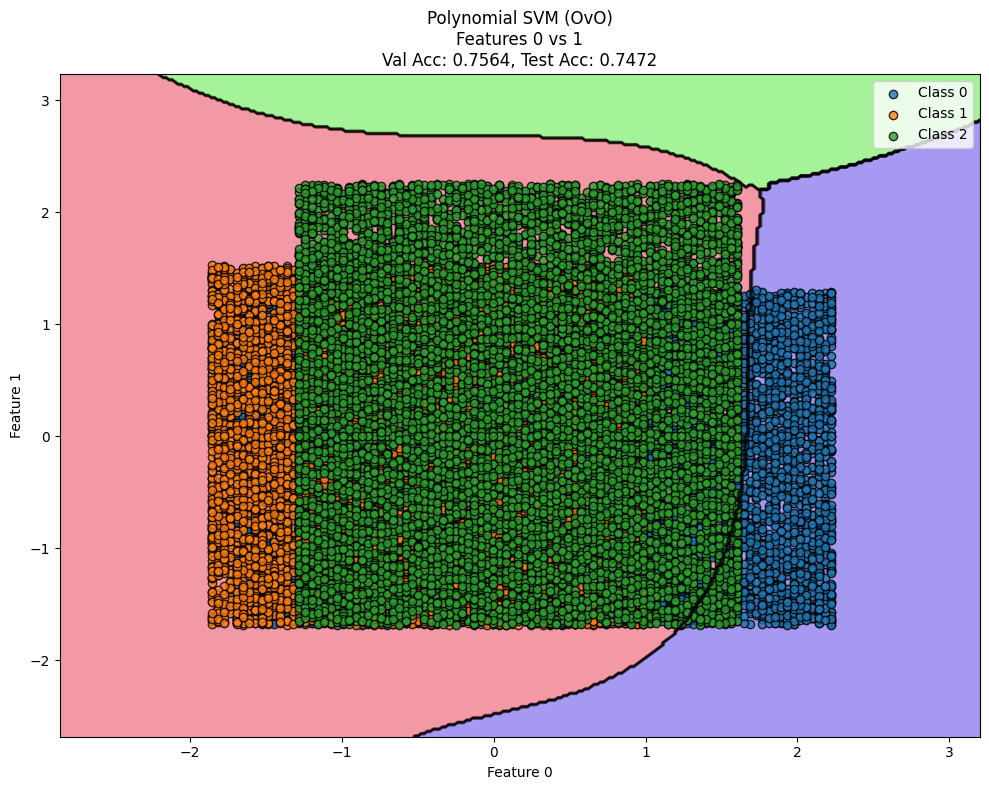


--- Polynomial SVM (OvA) ---
Validation Accuracy: 0.7549
Test Accuracy: 0.7456
Confusion Matrix (Test Set):
[[1825  468  223]
 [ 619 1544  282]
 [ 131  176 2196]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.71      0.73      0.72      2516
     Class 1       0.71      0.63      0.67      2445
     Class 2       0.81      0.88      0.84      2503

    accuracy                           0.75      7464
   macro avg       0.74      0.74      0.74      7464
weighted avg       0.74      0.75      0.74      7464



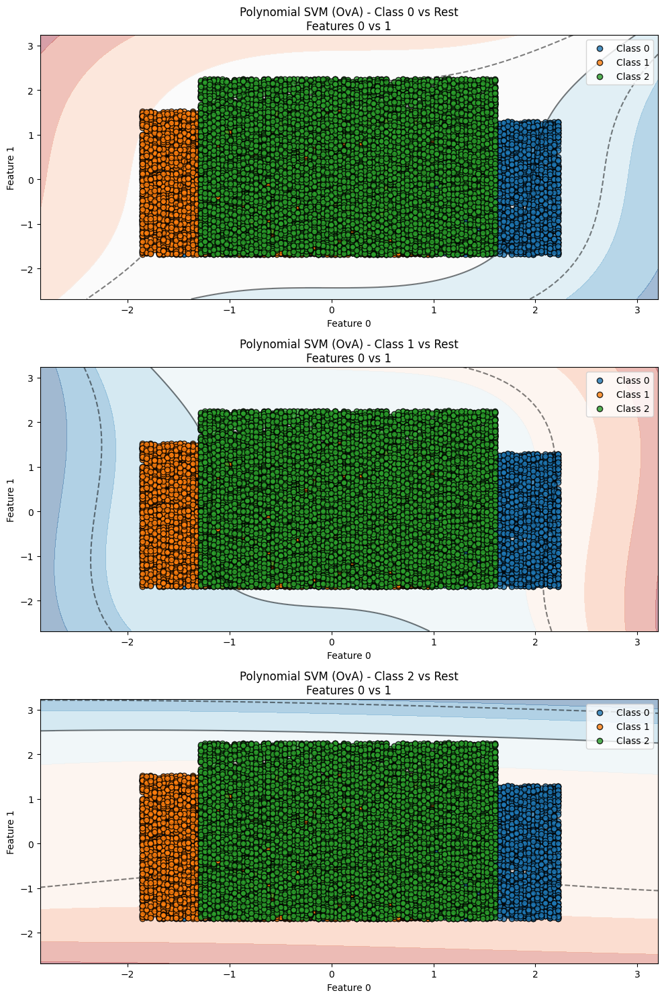


--- Gaussian (RBF) SVM (Default) ---
Validation Accuracy: 0.7637
Test Accuracy: 0.7524
Confusion Matrix (Test Set):
[[1855  461  200]
 [ 599 1575  271]
 [ 136  181 2186]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.72      0.74      0.73      2516
     Class 1       0.71      0.64      0.68      2445
     Class 2       0.82      0.87      0.85      2503

    accuracy                           0.75      7464
   macro avg       0.75      0.75      0.75      7464
weighted avg       0.75      0.75      0.75      7464



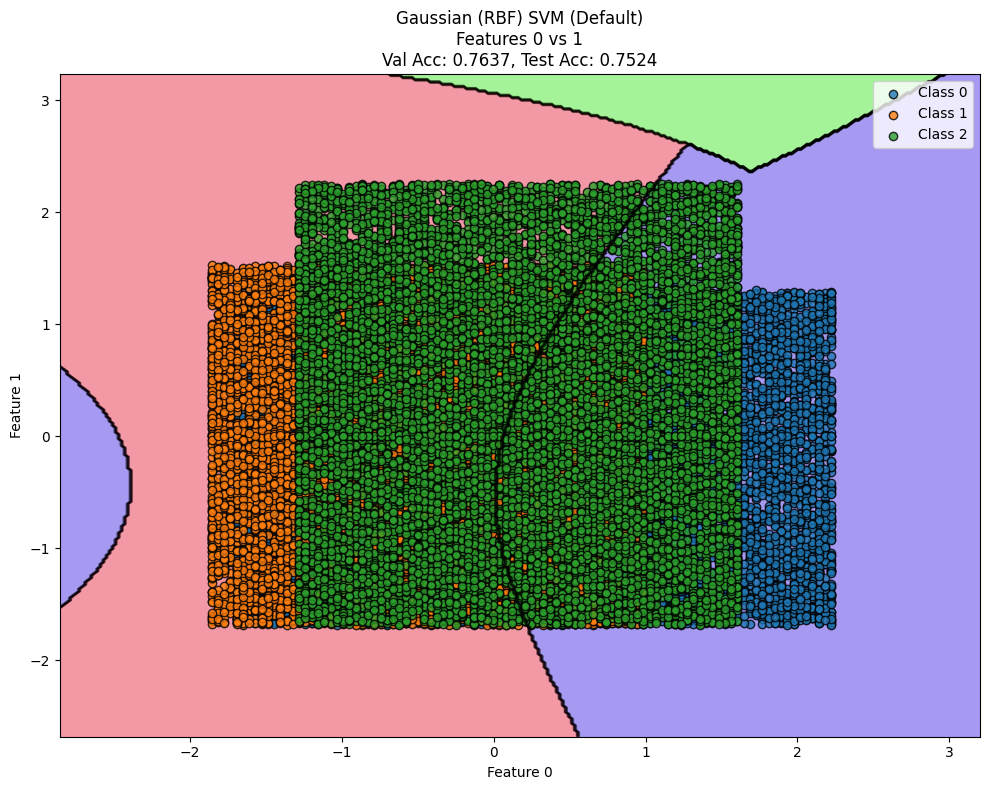


--- Gaussian (RBF) SVM (OvO) ---
Validation Accuracy: 0.7640
Test Accuracy: 0.7520
Confusion Matrix (Test Set):
[[1852  463  201]
 [ 597 1576  272]
 [ 133  185 2185]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.72      0.74      0.73      2516
     Class 1       0.71      0.64      0.68      2445
     Class 2       0.82      0.87      0.85      2503

    accuracy                           0.75      7464
   macro avg       0.75      0.75      0.75      7464
weighted avg       0.75      0.75      0.75      7464



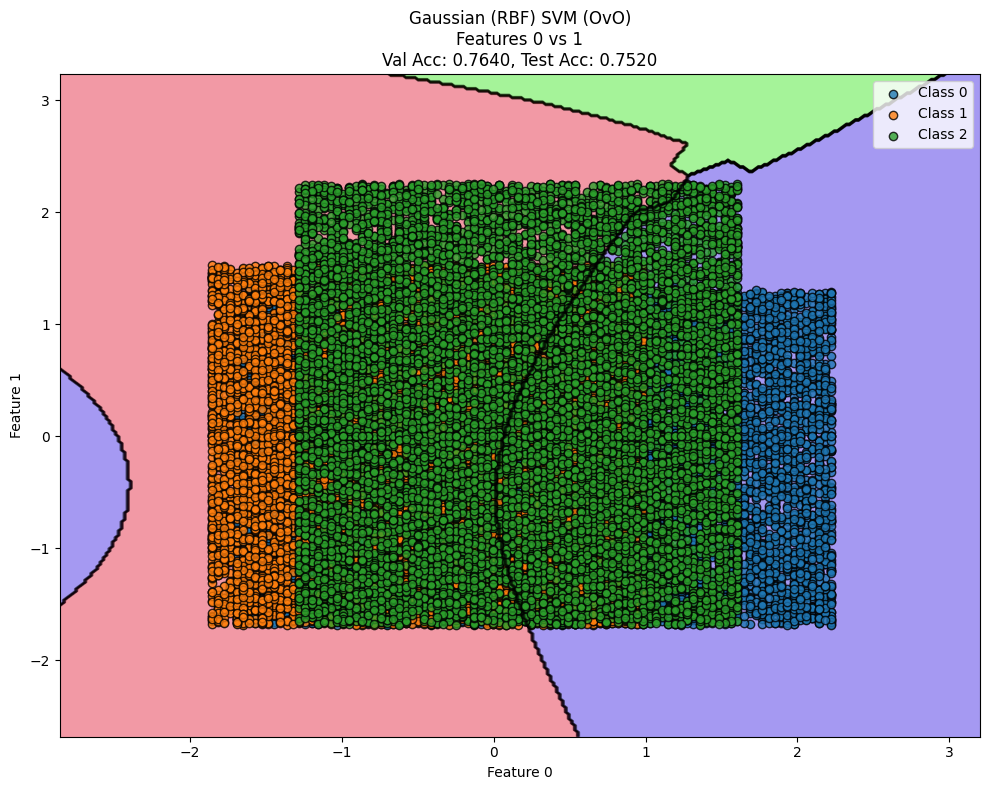


--- Gaussian (RBF) SVM (OvA) ---
Validation Accuracy: 0.7629
Test Accuracy: 0.7499
Confusion Matrix (Test Set):
[[1831  477  208]
 [ 594 1566  285]
 [ 134  169 2200]]

Classification Report (Test Set):
              precision    recall  f1-score   support

     Class 0       0.72      0.73      0.72      2516
     Class 1       0.71      0.64      0.67      2445
     Class 2       0.82      0.88      0.85      2503

    accuracy                           0.75      7464
   macro avg       0.75      0.75      0.75      7464
weighted avg       0.75      0.75      0.75      7464



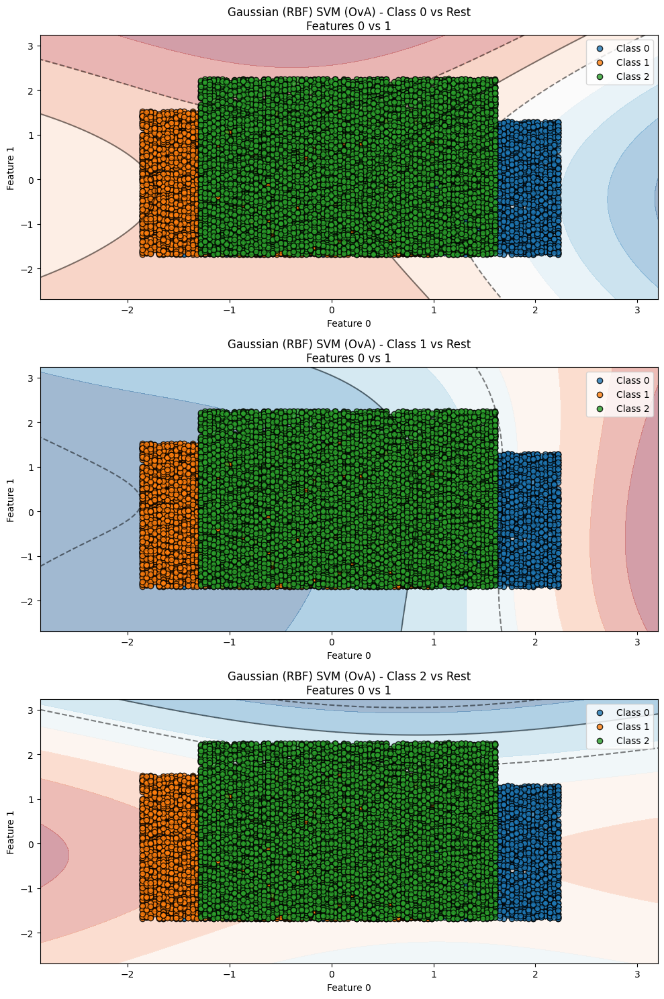


=== Model Comparison ===
Model                          Val Accuracy    Test Accuracy  
Gaussian (RBF) SVM (Default)   0.7637          0.7524         
Gaussian (RBF) SVM (OvO)       0.7640          0.7520         
Gaussian (RBF) SVM (OvA)       0.7629          0.7499         
Polynomial SVM (OvO)           0.7564          0.7472         
Polynomial SVM (Default)       0.7565          0.7456         
Polynomial SVM (OvA)           0.7549          0.7456         
Linear SVM (OvO)               0.7035          0.6925         
Linear SVM (Default)           0.7031          0.6923         
Linear SVM (OvA)               0.7009          0.6852         


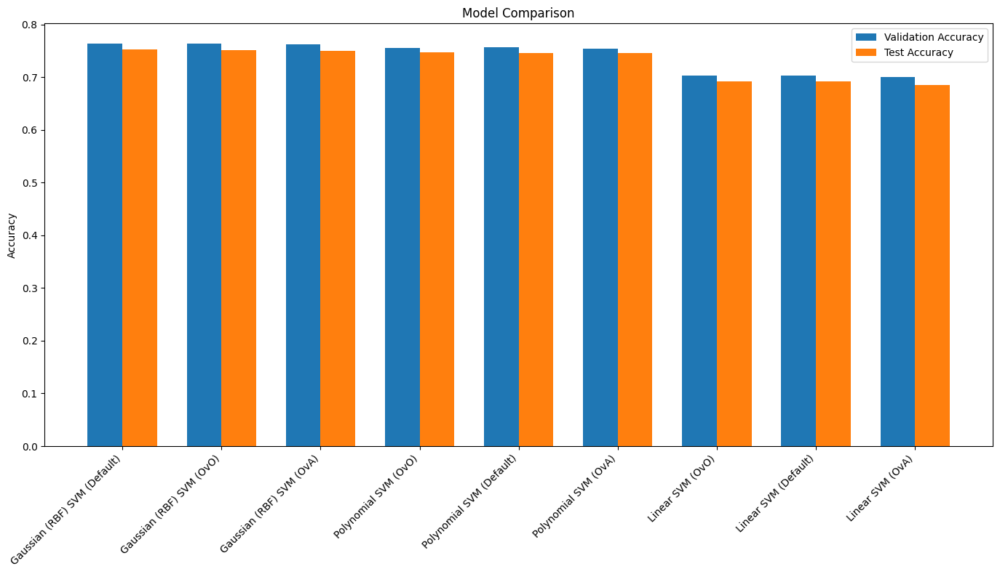


=== Misclassification Analysis ===

Gaussian (RBF) SVM (Default):
Class-wise accuracy:
Class 0: 0.7373
Class 1: 0.6442
Class 2: 0.8734
Most common error: Class 1 as Class 0 (599 cases)

Gaussian (RBF) SVM (OvO):
Class-wise accuracy:
Class 0: 0.7361
Class 1: 0.6446
Class 2: 0.8730
Most common error: Class 1 as Class 0 (597 cases)

Gaussian (RBF) SVM (OvA):
Class-wise accuracy:
Class 0: 0.7277
Class 1: 0.6405
Class 2: 0.8789
Most common error: Class 1 as Class 0 (594 cases)

Polynomial SVM (OvO):
Class-wise accuracy:
Class 0: 0.7250
Class 1: 0.6393
Class 2: 0.8750
Most common error: Class 1 as Class 0 (602 cases)

Polynomial SVM (Default):
Class-wise accuracy:
Class 0: 0.7242
Class 1: 0.6364
Class 2: 0.8738
Most common error: Class 1 as Class 0 (613 cases)

Polynomial SVM (OvA):
Class-wise accuracy:
Class 0: 0.7254
Class 1: 0.6315
Class 2: 0.8773
Most common error: Class 1 as Class 0 (619 cases)

Linear SVM (OvO):
Class-wise accuracy:
Class 0: 0.7313
Class 1: 0.5746
Class 2: 0.7687
Most

TypeError: Object of type Pipeline is not JSON serializable

In [ ]:
from sklearn.svm import SVC
from sklearn.pipeline import make_pipeline
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.multiclass import OneVsOneClassifier, OneVsRestClassifier
from sklearn.model_selection import train_test_split

# Use your existing dataset splits
# Assuming these variables are already defined:
# X_temp, X_test, y_temp, y_test
# X_train, X_val, y_train, y_val

target_names = [f'Class {i}' for i in range(len(np.unique(y_train)))]

# Define SVM kernels
svm_kernels = {
    "Linear": 'linear',
    "Polynomial": 'poly',
    "Gaussian (RBF)": 'rbf'
}

# Initialize models dictionary with OvO and OvA variants
models = {}

for kernel_name, kernel in svm_kernels.items():
    # Standard multiclass
    models[f"{kernel_name} SVM (Default)"] = make_pipeline(
        StandardScaler(),
        SVC(kernel=kernel, C=1.0, gamma='scale', random_state=42, decision_function_shape='ovr')
    )

    # Explicit One-vs-One
    models[f"{kernel_name} SVM (OvO)"] = make_pipeline(
        StandardScaler(),
        OneVsOneClassifier(SVC(kernel=kernel, C=1.0, gamma='scale', random_state=42))
    )

    # One-vs-Rest (OvA)
    models[f"{kernel_name} SVM (OvA)"] = make_pipeline(
        StandardScaler(),
        OneVsRestClassifier(SVC(kernel=kernel, C=1.0, gamma='scale', random_state=42))
    )

# Train and evaluate models
print("\n=== SVM Classification Performance ===\n")
results = {}

for name, model in models.items():
    print(f"\n--- {name} ---")

    # Fit the model
    model.fit(X_train, y_train)
    y_val_pred = model.predict(X_val)
    y_test_pred = model.predict(X_test)

    # Calculate metrics
    val_acc = accuracy_score(y_val, y_val_pred)
    test_acc = accuracy_score(y_test, y_test_pred)
    cm = confusion_matrix(y_test, y_test_pred)

    # Store results
    results[name] = {
        'val_acc': val_acc,
        'test_acc': test_acc,
        'confusion_matrix': cm,
        'model': model
    }

    print(f"Validation Accuracy: {val_acc:.4f}")
    print(f"Test Accuracy: {test_acc:.4f}")
    print("Confusion Matrix (Test Set):")
    print(cm)
    print("\nClassification Report (Test Set):")
    print(classification_report(y_test, y_test_pred, target_names=target_names))

    # Visualization for first two features
    f1, f2 = 0, 1  # Using first two features for visualization

    # Create mesh grid for the first two features
    h = 0.02  # step size in the mesh
    x_min, x_max = X_train[:, f1].min() - 1, X_train[:, f1].max() + 1
    y_min, y_max = X_train[:, f2].min() - 1, X_train[:, f2].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

    # Create fake data with zeros for other features
    fake_data = np.zeros((xx.ravel().shape[0], X_train.shape[1]))
    fake_data[:, f1] = xx.ravel()
    fake_data[:, f2] = yy.ravel()

    # Apply the same scaling as during training
    scaler = model.named_steps['standardscaler']
    scaled_fake_data = scaler.transform(fake_data)

    # For OvA models, plot each binary classifier separately
    if 'OvA' in name:
        n_classes = len(np.unique(y_train))
        fig, axs = plt.subplots(n_classes, 1, figsize=(10, 5*n_classes))

        # Get the OneVsRest classifier
        ovr_classifier = model.named_steps['onevsrestclassifier']

        for i in range(n_classes):
            ax = axs[i] if n_classes > 1 else axs

            # Get the binary classifier
            binary_clf = ovr_classifier.estimators_[i]

            # Get the decision function values
            Z = binary_clf.decision_function(scaled_fake_data)
            Z = Z.reshape(xx.shape)

            # Plot decision boundary
            ax.contourf(xx, yy, Z, alpha=0.4, cmap=plt.cm.RdBu)
            ax.contour(xx, yy, Z, colors='k', levels=[-1, 0, 1], alpha=0.5,
                      linestyles=['--', '-', '--'])

            # Plot the training points for these two features
            for cls in np.unique(y_train):
                idx = np.where(y_train == cls)[0]
                ax.scatter(X_train[idx, f1], X_train[idx, f2],
                          alpha=0.8, label=f'Class {cls}',
                          edgecolor='k')

            ax.set_title(f"{name} - Class {i} vs Rest\nFeatures {f1} vs {f2}")
            ax.set_xlabel(f"Feature {f1}")
            ax.set_ylabel(f"Feature {f2}")
            ax.legend()

        plt.tight_layout()
        plt.savefig(f"{name.replace(' ', '_')}_ova_decision_boundary.png", dpi=300)
        plt.show()

    # For Default and OvO, plot combined decision boundaries
    else:
        plt.figure(figsize=(10, 8))

        # Get the classifier
        if 'OvO' in name:
            classifier = model.named_steps['onevsoneclassifier']
        else:  # Default SVC
            classifier = model.named_steps['svc']

        # Get predictions for the mesh
        Z = classifier.predict(scaled_fake_data)
        Z = Z.reshape(xx.shape)

        # Plot decision regions
        plt.contourf(xx, yy, Z, alpha=0.4, cmap=plt.cm.brg)

        # Plot decision boundary
        plt.contour(xx, yy, Z, colors='k', alpha=0.5)

        # Plot the training points for these two features
        for cls in np.unique(y_train):
            idx = np.where(y_train == cls)[0]
            plt.scatter(X_train[idx, f1], X_train[idx, f2],
                       alpha=0.8, label=f'Class {cls}',
                       edgecolor='k')

        plt.title(f"{name}\nFeatures {f1} vs {f2}\nVal Acc: {val_acc:.4f}, Test Acc: {test_acc:.4f}")
        plt.xlabel(f"Feature {f1}")
        plt.ylabel(f"Feature {f2}")
        plt.legend()

        plt.tight_layout()
        plt.savefig(f"{name.replace(' ', '_')}_decision_boundary.png", dpi=300)
        plt.show()

# Model comparison visualization
print("\n=== Model Comparison ===")
models_list = sorted(results.keys(), key=lambda x: results[x]['test_acc'], reverse=True)
print("{:<30} {:<15} {:<15}".format("Model", "Val Accuracy", "Test Accuracy"))
for name in models_list:
    print("{:<30} {:<15.4f} {:<15.4f}".format(
        name,
        results[name]['val_acc'],
        results[name]['test_acc']))

# Plot accuracy comparison
plt.figure(figsize=(14, 8))
val_acc = [results[name]['val_acc'] for name in models_list]
test_acc = [results[name]['test_acc'] for name in models_list]
x = np.arange(len(models_list))
width = 0.35

plt.bar(x - width/2, val_acc, width, label='Validation Accuracy')
plt.bar(x + width/2, test_acc, width, label='Test Accuracy')
plt.xticks(x, models_list, rotation=45, ha='right')
plt.ylabel('Accuracy')
plt.title('Model Comparison')
plt.legend()
plt.tight_layout()
plt.savefig("model_comparison.png", dpi=300)
plt.show()

# Misclassification analysis
print("\n=== Misclassification Analysis ===")
for name in models_list:
    cm = results[name]['confusion_matrix']
    print(f"\n{name}:")
    print("Class-wise accuracy:")
    class_acc = cm.diagonal()/cm.sum(axis=1)
    for i, acc in enumerate(class_acc):
        print(f"Class {i}: {acc:.4f}")

    if cm.shape[0] > 1:
        # Create a copy to avoid modifying the original
        cm_copy = cm.copy()
        np.fill_diagonal(cm_copy, 0)
        if cm_copy.sum() > 0:
            max_err = np.unravel_index(np.argmax(cm_copy), cm_copy.shape)
            print(f"Most common error: Class {max_err[0]} as Class {max_err[1]} ({cm_copy[max_err]} cases)")

# Save results to file
import json
with open('svm_results.json', 'w') as f:
    json.dump({k: {kk: vv.tolist() if isinstance(vv, np.ndarray) else vv
              for kk, vv in v.items()}
              for k, v in results.items()}, f, indent=2)

print("\n=== Analysis Complete ===")

### SVM WITH PSO (READY MADE)

In [ ]:
!pip install pyswarms

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.1/104.1 kB 6.7 MB/s eta 0:00:00


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.decomposition import PCA
import seaborn as sns
import joblib
import time
import pickle
import json
import os
from datetime import datetime
from sklearn.metrics import accuracy_score, classification_report
from sklearn.model_selection import cross_val_score
from sklearn.svm import SVC
from sklearn.multiclass import OneVsRestClassifier
import pyswarms as ps

# Create directories for saving results
os.makedirs('models', exist_ok=True)
os.makedirs('results', exist_ok=True)
os.makedirs('logs', exist_ok=True)

# Initialize results tracking
timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
results_file = f'results/pso_results_{timestamp}.pkl'
log_file = f'logs/pso_log_{timestamp}.txt'

def log_message(message, print_msg=True):
    """Log message to both console and file"""
    if print_msg:
        print(message)
    with open(log_file, 'a') as f:
        f.write(f"{datetime.now().strftime('%Y-%m-%d %H:%M:%S')} - {message}\n")

def save_progress(pso_results, current_method=None):
    """Save current progress to prevent data loss"""
    try:
        # Save results dictionary
        with open(results_file, 'wb') as f:
            pickle.dump(pso_results, f)

        # Also save as JSON (readable format)
        json_results = {}
        for name, res in pso_results.items():
            json_results[name] = {
                'C': float(res['C']),
                'gamma': float(res['gamma']),
                'val_score': float(res['val_score']),
                'test_acc': float(res['test_acc']),
                'time': float(res['time']),
                'completed': True
            }

        json_file = f'results/pso_results_{timestamp}.json'
        with open(json_file, 'w') as f:
            json.dump(json_results, f, indent=2)

        log_message(f"Progress saved: {len(pso_results)} methods completed")
        if current_method:
            log_message(f"Just completed: {current_method}")

    except Exception as e:
        log_message(f"Error saving progress: {str(e)}")

def load_existing_results():
    """Load existing results if available"""
    if os.path.exists(results_file):
        try:
            with open(results_file, 'rb') as f:
                results = pickle.load(f)
            log_message(f"Loaded existing results: {list(results.keys())}")
            return results
        except Exception as e:
            log_message(f"Error loading existing results: {str(e)}")
    return {}

def create_fitness_function(X_train, y_train, use_sample=True, sample_size=10000):
    """Create vectorized fitness function for PSO"""

    # Use sample for large datasets to speed up optimization
    if use_sample and X_train.shape[0] > sample_size:
        indices = np.random.choice(X_train.shape[0], sample_size, replace=False)
        X_sample = X_train.iloc[indices] if hasattr(X_train, 'iloc') else X_train[indices]
        y_sample = y_train.iloc[indices] if hasattr(y_train, 'iloc') else y_train[indices]
        log_message(f"  Using sample of {sample_size} from {X_train.shape[0]} training samples")
    else:
        X_sample = X_train
        y_sample = y_train
        log_message(f"  Using full training set: {X_train.shape[0]} samples")

    def fitness_function(params):
        scores = []
        for particle in params:
            try:
                C = 10 ** particle[0]
                gamma = 10 ** particle[1]

                # Create SVM model
                svm = OneVsRestClassifier(SVC(C=C, gamma=gamma, kernel='rbf'))

                # 3-fold CV for speed
                score = cross_val_score(svm, X_sample, y_sample, cv=5, scoring='accuracy', n_jobs=-1).mean()
                scores.append(1 - score)  # minimize inverted accuracy

            except Exception as e:
                log_message(f"    Error with particle C={C:.4f}, gamma={gamma:.6f}: {str(e)}")
                scores.append(1.0)  # Return poor score on error

        return np.array(scores)

    return fitness_function

def optimize_svm_pso(X_train, y_train, X_val, y_val, method_name):
    """Optimize SVM using PySwarms PSO"""

    log_message(f"Starting PSO optimization for {method_name}...")

    # PSO bounds: log10(C) and log10(gamma)
    bounds = (np.array([-1, -4]),  # log10(0.1), log10(1e-4)
              np.array([2, 0]))    # log10(100), log10(1)

    # Create fitness function
    fitness_func = create_fitness_function(X_train, y_train)

    # PSO setup - optimized parameters
    options = {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
    optimizer = ps.single.GlobalBestPSO(
        n_particles=20,
        dimensions=2,
        options=options,
        bounds=bounds
    )

    # Run PSO optimization
    start_time = time.time()
    log_message(f"  Running PSO with 20 particles for 30 iterations...")

    best_cost, best_pos = optimizer.optimize(fitness_func, iters=30)

    pso_time = time.time() - start_time

    # Convert back to original parameters
    best_C = 10 ** best_pos[0]
    best_gamma = 10 ** best_pos[1]
    best_accuracy = 1 - best_cost  # Convert back from inverted accuracy

    log_message(f"  PSO completed in {pso_time:.1f}s")
    log_message(f"  Best parameters: C={best_C:.4f}, gamma={best_gamma:.6f}")
    log_message(f"  Best CV accuracy: {best_accuracy:.4f}")

    # Train final model on full training data
    log_message(f"  Training final model on full training data...")
    final_model = OneVsRestClassifier(SVC(C=best_C, gamma=best_gamma, kernel='rbf'))
    final_model.fit(X_train, y_train)

    # Validate on validation set
    y_pred_val = final_model.predict(X_val)
    val_score = accuracy_score(y_val, y_pred_val)

    log_message(f"  Validation accuracy: {val_score:.4f}")

    return best_C, best_gamma, val_score, final_model, pso_time

# Data pipelines
pipelines_data = {
    'Baseline': (X_train_baseline, y_train, X_val_baseline, y_val, X_test_baseline, y_test),
    'PCA': (X_train_pca, y_train, X_val_pca, y_val, X_test_pca, y_test),
    'GA': (X_train_ga, y_train, X_val_ga, y_val, X_test_ga, y_test),
}

# Load any existing results
pso_results = load_existing_results()

log_message(f"{'='*70}")
log_message("IMPROVED PSO-OPTIMIZED SVM HYPERPARAMETER TUNING")
log_message("Using PySwarms with Vectorized Fitness Function")
log_message(f"{'='*70}")

# Process each pipeline
for name, (X_train, y_train, X_val, y_val, X_test, y_test) in pipelines_data.items():

    # Skip if already completed
    if name in pso_results:
        log_message(f"\n Skipping {name.upper()} - already completed with test accuracy: {pso_results[name]['test_acc']:.4f}")
        continue

    log_message(f"\n{'-'*50}")
    log_message(f"Processing Method: {name.upper()}")
    log_message(f"Training shape: {X_train.shape}, Validation shape: {X_val.shape}, Test shape: {X_test.shape}")
    log_message(f"{'-'*50}")

    try:
        total_start_time = time.time()

        # Run PSO optimization
        best_C, best_gamma, val_score, final_model, pso_time = optimize_svm_pso(
            X_train, y_train, X_val, y_val, name
        )

        # Evaluate on test set
        log_message(f"  Evaluating on test set...")
        y_pred_test = final_model.predict(X_test)
        test_acc = accuracy_score(y_test, y_pred_test)

        total_time = time.time() - total_start_time

        # Save the trained model
        model_filename = f'./pso_models/best_svm_pso_model_{name.lower()}_{timestamp}.pkl'
        joblib.dump(final_model, model_filename)

        # Save model metadata
        model_metadata = {
            'method': name,
            'C': best_C,
            'gamma': best_gamma,
            'val_score': val_score,
            'test_acc': test_acc,
            'timestamp': timestamp,
            'optimization_time': pso_time,
            'total_time': total_time
        }

        metadata_filename = f'./pso_models/metadata_{name.lower()}_{timestamp}.json'
        with open(metadata_filename, 'w') as f:
            json.dump(model_metadata, f, indent=2)

        log_message(f"  Model saved: {model_filename}")
        log_message(f"  Metadata saved: {metadata_filename}")

        # Store results
        pso_results[name] = {
            'C': best_C,
            'gamma': best_gamma,
            'val_score': val_score,
            'test_acc': test_acc,
            'time': total_time,
            'pso_time': pso_time,
            'y_test': y_test,
            'y_pred': y_pred_test,
            'model_filename': model_filename,
            'metadata_filename': metadata_filename
        }

        log_message(f"\n {name.upper()} COMPLETED SUCCESSFULLY")
        log_message(f"  Final Results:")
        log_message(f"    C: {best_C:.4f}")
        log_message(f"    Gamma: {best_gamma:.6f}")
        log_message(f"    Validation Score: {val_score:.4f}")
        log_message(f"    Test Accuracy: {test_acc:.4f}")
        log_message(f"    PSO Time: {pso_time:.1f}s")
        log_message(f"    Total Time: {total_time:.1f}s")

        # Print detailed classification report
        log_message(f"\n  DETAILED CLASSIFICATION REPORT - {name.upper()}:")
        log_message("  " + "=" * 58)
        class_report = classification_report(y_test, y_pred_test, digits=4)
        for line in class_report.split('\n'):
            if line.strip():
                log_message(f"  {line}")
        log_message("  " + "=" * 58)

        # Save progress after each completion
        save_progress(pso_results, name)

    except Exception as e:
        log_message(f" Error processing {name.upper()}: {str(e)}")
        log_message(f"Continuing with next method...")
        continue

# Final summary and comparison
if pso_results:
    log_message(f"\n{'='*80}")
    log_message(" FINAL PSO-OPTIMIZED SVM RESULTS COMPARISON")
    log_message(f"{'='*80}")

    for name in pso_results:
        log_message(f"\n{name.upper()} METHOD:")
        log_message("-" * 50)
        class_report = classification_report(pso_results[name]['y_test'], pso_results[name]['y_pred'], digits=4)
        for line in class_report.split('\n'):
            if line.strip():
                log_message(line)

    # Print final summary table
    log_message(f"\n{'='*80}")
    log_message("FINAL SUMMARY TABLE")
    log_message(f"{'='*80}")

    log_message(f"{'Method':<12} {'Test Acc':<10} {'Val Score':<10} {'C':<10} {'Gamma':<12} {'PSO Time':<10} {'Total Time':<10}")
    log_message(f"{'-'*92}")

    best_method = max(pso_results, key=lambda x: pso_results[x]['test_acc'])

    for name, res in pso_results.items():
        marker = " ★" if name == best_method else ""
        log_message(f"{name:<12} {res['test_acc']:<10.4f} "
                   f"{res['val_score']:<10.4f} {res['C']:<10.3f} "
                   f"{res['gamma']:<12.6f} {res['pso_time']:<10.1f} "
                   f"{res['time']:<10.1f}{marker}")

    log_message(f"\n BEST PERFORMING METHOD: {best_method.upper()}")
    log_message(f"   Test Accuracy: {pso_results[best_method]['test_acc']:.4f}")
    log_message(f"   Parameters: C={pso_results[best_method]['C']:.4f}, gamma={pso_results[best_method]['gamma']:.6f}")

    # Save final comprehensive results
    save_progress(pso_results)

    # Create summary report
    summary_report = {
        'timestamp': timestamp,
        'total_methods': len(pipelines_data),
        'completed_methods': len(pso_results),
        'best_method': best_method,
        'best_test_accuracy': pso_results[best_method]['test_acc'],
        'total_optimization_time': sum(res['pso_time'] for res in pso_results.values()),
        'total_time': sum(res['time'] for res in pso_results.values()),
        'results_summary': {name: {
            'test_acc': res['test_acc'],
            'val_score': res['val_score'],
            'C': res['C'],
            'gamma': res['gamma'],
            'pso_time': res['pso_time'],
            'total_time': res['time']
        } for name, res in pso_results.items()}
    }

    summary_file = f'results/summary_report_{timestamp}.json'
    with open(summary_file, 'w') as f:
        json.dump(summary_report, f, indent=2)

    log_message(f"\n Summary report saved: {summary_file}")

else:
    log_message(" No methods completed successfully.")

log_message(f"\n{'='*70}")
log_message("PSO OPTIMIZATION COMPLETE")
log_message(f"Files saved with timestamp: {timestamp}")
log_message(f" Check directories: models/, results/, logs/")
log_message(f"{'='*70}")

print(f"\n Improved PSO SVM optimization completed!")
print(f" {len(pso_results)}/{len(pipelines_data)} methods completed successfully")
if pso_results:
    total_time = sum(res['time'] for res in pso_results.values())
    print(f"  Total processing time: {total_time:.1f}s ({total_time/60:.1f} minutes)")
    print(f" Best method: {max(pso_results, key=lambda x: pso_results[x]['test_acc']).upper()}")
print(f" Results saved with timestamp: {timestamp}")

2025-05-25 23:16:03,703 - pyswarms.single.global_best - INFO - Optimize for 20 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}


IMPROVED PSO-OPTIMIZED SVM HYPERPARAMETER TUNING
Using PySwarms with Vectorized Fitness Function

--------------------------------------------------
Processing Method: BASELINE
Training shape: (34998, 310), Validation shape: (7502, 310), Test shape: (7500, 310)
--------------------------------------------------
Starting PSO optimization for Baseline...
  Using sample of 10000 from 34998 training samples
  Running PSO with 40 particles for 20 iterations...


pyswarms.single.global_best: 100%|██████████|20/20, best_cost=0.15 
2025-05-26 03:59:02,670 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 0.1500999999999999, best pos: [ 0.52961235 -1.22452571]


  PSO completed in 16979.0s
  Best parameters: C=3.3854, gamma=0.059631
  Best CV accuracy: 0.8499
  Training final model on full training data...
  Validation accuracy: 0.8760
  Evaluating on test set...


2025-05-26 04:09:40,596 - pyswarms.single.global_best - INFO - Optimize for 20 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}


  Model saved: ./pso_models/best_svm_pso_model_baseline_20250525_231603.pkl
  Metadata saved: ./pso_models/metadata_baseline_20250525_231603.json

 BASELINE COMPLETED SUCCESSFULLY
  Final Results:
    C: 3.3854
    Gamma: 0.059631
    Validation Score: 0.8760
    Test Accuracy: 0.8719
    PSO Time: 16979.0s
    Total Time: 17616.8s

  DETAILED CLASSIFICATION REPORT - BASELINE:
                precision    recall  f1-score   support
             0     0.8776    0.8716    0.8746      2516
             1     0.8485    0.8441    0.8463      2482
             2     0.8890    0.8997    0.8943      2502
      accuracy                         0.8719      7500
     macro avg     0.8717    0.8718    0.8717      7500
  weighted avg     0.8718    0.8719    0.8718      7500
Progress saved: 1 methods completed
Just completed: Baseline

--------------------------------------------------
Processing Method: PCA
Training shape: (34998, 300), Validation shape: (7502, 300), Test shape: (7500, 300)
-------

pyswarms.single.global_best: 100%|██████████|20/20, best_cost=0.128
2025-05-26 08:28:33,322 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 0.12770000000000015, best pos: [ 0.54836875 -1.05154431]


  PSO completed in 15532.7s
  Best parameters: C=3.5348, gamma=0.088809
  Best CV accuracy: 0.8723
  Training final model on full training data...
  Validation accuracy: 0.8970
  Evaluating on test set...


2025-05-26 08:40:30,325 - pyswarms.single.global_best - INFO - Optimize for 20 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}


  Model saved: ./pso_models/best_svm_pso_model_pca_20250525_231603.pkl
  Metadata saved: ./pso_models/metadata_pca_20250525_231603.json

 PCA COMPLETED SUCCESSFULLY
  Final Results:
    C: 3.5348
    Gamma: 0.088809
    Validation Score: 0.8970
    Test Accuracy: 0.8928
    PSO Time: 15532.7s
    Total Time: 16249.7s

  DETAILED CLASSIFICATION REPORT - PCA:
                precision    recall  f1-score   support
             0     0.9010    0.9046    0.9028      2516
             1     0.8822    0.8691    0.8756      2482
             2     0.8948    0.9045    0.8996      2502
      accuracy                         0.8928      7500
     macro avg     0.8927    0.8927    0.8927      7500
  weighted avg     0.8927    0.8928    0.8927      7500
Progress saved: 2 methods completed
Just completed: PCA

--------------------------------------------------
Processing Method: GA
Training shape: (34998, 195), Validation shape: (7502, 195), Test shape: (7500, 195)
---------------------------------

pyswarms.single.global_best: 100%|██████████|20/20, best_cost=0.143
2025-05-26 11:27:35,131 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 0.14329999999999998, best pos: [ 0.82238224 -1.19741786]


  PSO completed in 10024.8s
  Best parameters: C=6.6433, gamma=0.063472
  Best CV accuracy: 0.8567
  Training final model on full training data...
  Validation accuracy: 0.8860
  Evaluating on test set...
  Model saved: ./pso_models/best_svm_pso_model_ga_20250525_231603.pkl
  Metadata saved: ./pso_models/metadata_ga_20250525_231603.json

 GA COMPLETED SUCCESSFULLY
  Final Results:
    C: 6.6433
    Gamma: 0.063472
    Validation Score: 0.8860
    Test Accuracy: 0.8800
    PSO Time: 10024.8s
    Total Time: 10367.1s

  DETAILED CLASSIFICATION REPORT - GA:
                precision    recall  f1-score   support
             0     0.8894    0.8983    0.8938      2516
             1     0.8639    0.8622    0.8631      2482
             2     0.8864    0.8793    0.8828      2502
      accuracy                         0.8800      7500
     macro avg     0.8799    0.8799    0.8799      7500
  weighted avg     0.8800    0.8800    0.8800      7500
Progress saved: 3 methods completed
Just comple

UnicodeEncodeError: 'charmap' codec can't encode character '\u2605' in position 103: character maps to <undefined>

Loading models and generating metrics & confusion matrices...


Metric Definitions:
-------------------
- Accuracy:    (TP + TN) / (TP + TN + FP + FN) — how often the model is correct overall.
- Precision:   TP / (TP + FP) — how many selected items were relevant (low FP).
- Recall:      TP / (TP + FN) — how many relevant items were selected (low FN).
- F1-Score:    2 * (Precision * Recall) / (Precision + Recall) — harmonic mean - balance between Precision and Recall.


Model: Baseline
Accuracy : 0.8717
Precision: 0.8716
Recall   : 0.8717
F1-Score : 0.8716


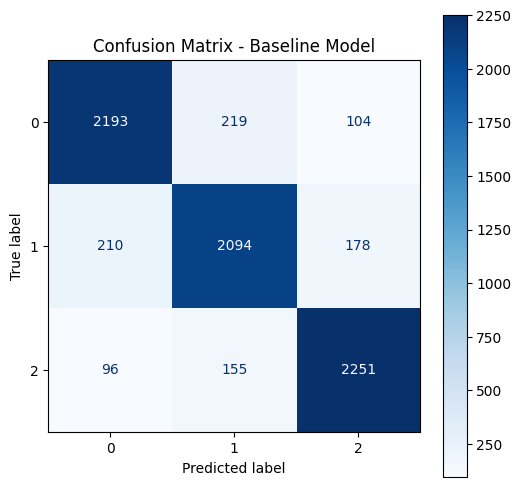


Model: PCA
Accuracy : 0.8929
Precision: 0.8928
Recall   : 0.8929
F1-Score : 0.8928


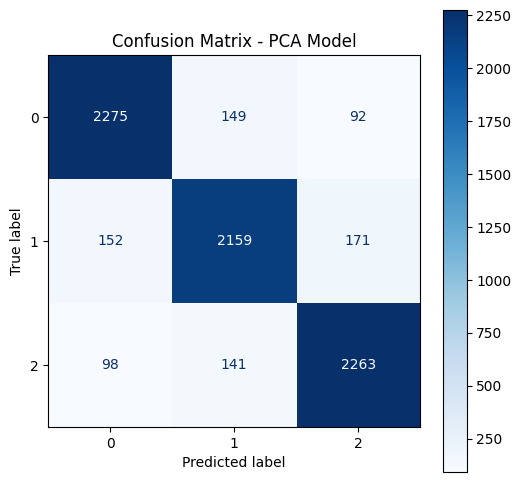


Model: GA
Accuracy : 0.8800
Precision: 0.8799
Recall   : 0.8799
F1-Score : 0.8799


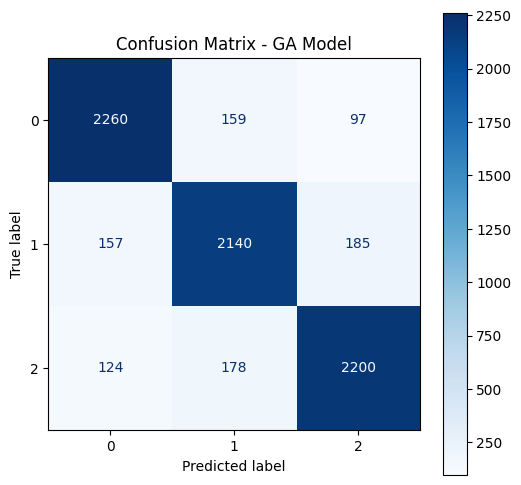

In [ ]:
import joblib
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import (
    confusion_matrix,
    ConfusionMatrixDisplay,
    precision_score,
    recall_score,
    f1_score,
    accuracy_score
)

model_paths = {
    'Baseline': './pso_models/best_svm_pso_model_baseline_20250525_231603.pkl',
    'PCA': './pso_models/best_svm_pso_model_pca_20250525_231603.pkl',
    'GA': './pso_models/best_svm_pso_model_ga_20250525_231603.pkl'
}

test_data_map = {
    'Baseline': X_test_baseline,
    'PCA': X_test_pca,
    'GA': X_test_ga
}

true_labels = y_test
class_labels = np.unique(true_labels)

print("Loading models and generating metrics & confusion matrices...\n")

# Metric rules to display once
metric_explanation = """
Metric Definitions:
-------------------
- Accuracy:    (TP + TN) / (TP + TN + FP + FN) — how often the model is correct overall.
- Precision:   TP / (TP + FP) — how many selected items were relevant (low FP).
- Recall:      TP / (TP + FN) — how many relevant items were selected (low FN).
- F1-Score:    2 * (Precision * Recall) / (Precision + Recall) — harmonic mean - balance between Precision and Recall.
"""

print(metric_explanation)

for model_name, path in model_paths.items():
    try:
        model = joblib.load(path)
        X_test_for_model = test_data_map[model_name]
        y_pred = model.predict(X_test_for_model)

        # Compute metrics
        acc = accuracy_score(true_labels, y_pred)
        prec = precision_score(true_labels, y_pred, average='macro', zero_division=0)
        rec = recall_score(true_labels, y_pred, average='macro', zero_division=0)
        f1 = f1_score(true_labels, y_pred, average='macro', zero_division=0)

        # Print metrics
        print(f"\nModel: {model_name}")
        print(f"Accuracy : {acc:.4f}")
        print(f"Precision: {prec:.4f}")
        print(f"Recall   : {rec:.4f}")
        print(f"F1-Score : {f1:.4f}")

        # Display Confusion Matrix
        cm = confusion_matrix(true_labels, y_pred, labels=class_labels)
        disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)

        fig, ax = plt.subplots(figsize=(6, 6))
        disp.plot(cmap=plt.cm.Blues, ax=ax)
        ax.set_title(f'Confusion Matrix - {model_name} Model')
        plt.show()

    except FileNotFoundError:
        print(f" Error: Model file not found at {path}.")
    except Exception as e:
        print(f" An error occurred while processing {model_name} model: {e}")


### SVM with PSO (ALGORITHM)

In [ ]:
class Particle:
    def __init__(self, bounds):
        self.position = np.array([np.random.uniform(low, high) for low, high in bounds])
        self.velocity = np.random.uniform(-1, 1, len(bounds))
        self.best_position = np.copy(self.position)
        self.best_score = -np.inf

    def update_velocity(self, global_best_position, w=0.5, c1=1.5, c2=1.5):
        r1, r2 = np.random.rand(2)
        cognitive = c1 * r1 * (self.best_position - self.position)
        social = c2 * r2 * (global_best_position - self.position)
        self.velocity = w * self.velocity + cognitive + social

    def update_position(self, bounds):
        self.position += self.velocity
        for i, (low, high) in enumerate(bounds):
            if self.position[i] < low:
                self.position[i] = low + (low - self.position[i]) % (high - low)
            elif self.position[i] > high:
                self.position[i] = high - (self.position[i] - high) % (high - low)

def evaluate_svm_optimized(X_train, y_train, X_val, y_val, C, gamma):
    clf = OneVsRestClassifier(SVC(C=C, gamma=gamma, kernel='rbf', probability=False, cache_size=200))
    clf.fit(X_train, y_train)
    return clf.score(X_val, y_val)

def pso_optimize_enhanced(X_train, y_train, bounds, n_particles=15, max_iter=25,
                         patience=6, w_start=0.9, w_end=0.4, verbose=True):
    particles = [Particle(bounds) for _ in range(n_particles)]
    global_best_position = None
    global_best_score = -np.inf
    history = []

    no_improve_count = 0
    stagnation_threshold = 1e-4

    for t in range(max_iter):
        w = w_start - (w_start - w_end) * t / max_iter

        iteration_scores = []

        for particle in particles:
            C, gamma = particle.position
            score = evaluate_svm_optimized(X_train, y_train, X_val, y_val, C, gamma)
            iteration_scores.append(score)

            if score > particle.best_score:
                particle.best_score = score
                particle.best_position = np.copy(particle.position)

            if score > global_best_score:
                global_best_score = score
                global_best_position = np.copy(particle.position)
                no_improve_count = 0
            else:
                no_improve_count += 1

        # Update particle velocities and positions
        for particle in particles:
            particle.update_velocity(global_best_position, w=w)
            particle.update_position(bounds)

        history.append(global_best_score)

        # Check for convergence
        if len(history) > 3:
            recent_improvement = abs(history[-1] - history[-4])
            if recent_improvement < stagnation_threshold:
                no_improve_count += 2  # Accelerate early stopping

        if verbose:
            avg_score = np.mean(iteration_scores)
            print(f"Iter {t:2d}: Best={global_best_score:.4f}, Avg={avg_score:.4f}, w={w:.3f}")

        if no_improve_count >= patience:
            if verbose:
                print(f"Early stopping at iteration {t} (no improvement for {patience} iterations)")
            break

    return global_best_position, global_best_score, history

def visualize_results(results):
    """Create comprehensive visualization of results"""
    fig, axes = plt.subplots(2, 2, figsize=(15, 12))

    # Test accuracy comparison
    names = list(results.keys())
    test_accs = [results[name]['test_acc'] for name in names]
    colors = ['skyblue', 'lightgreen', 'coral', 'gold', 'lightpink'][:len(names)]

    bars = axes[0,0].bar(names, test_accs, color=colors)
    axes[0,0].set_title('Test Accuracy by Method', fontsize=14, fontweight='bold')
    axes[0,0].set_ylabel('Accuracy')
    axes[0,0].tick_params(axis='x', rotation=45)
    axes[0,0].grid(True, alpha=0.3)

    # Add value labels on bars
    for bar, acc in zip(bars, test_accs):
        axes[0,0].text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.005,
                      f'{acc:.3f}', ha='center', va='bottom', fontweight='bold')

    # Convergence curves
    for i, name in enumerate(names):
        axes[0,1].plot(results[name]['history'], label=name, linewidth=2,
                      color=colors[i], marker='o', markersize=3)
    axes[0,1].set_title('PSO Convergence Curves', fontsize=14, fontweight='bold')
    axes[0,1].set_xlabel('Iteration')
    axes[0,1].set_ylabel('Best Validation Score')
    axes[0,1].legend()
    axes[0,1].grid(True, alpha=0.3)

    # Parameter space visualization (C vs gamma)
    for i, name in enumerate(names):
        axes[1,0].scatter(results[name]['C'], results[name]['gamma'],
                         s=150, label=f"{name}: {results[name]['test_acc']:.3f}",
                         alpha=0.8, color=colors[i], edgecolors='black', linewidth=1)
    axes[1,0].set_xlabel('C (log scale)')
    axes[1,0].set_ylabel('Gamma (log scale)')
    axes[1,0].set_xscale('log')
    axes[1,0].set_yscale('log')
    axes[1,0].set_title('Optimal Parameters', fontsize=14, fontweight='bold')
    axes[1,0].legend()
    axes[1,0].grid(True, alpha=0.3)

    # Training time comparison
    times = [results[name]['time'] for name in names]
    bars2 = axes[1,1].bar(names, times, color=colors)
    axes[1,1].set_title('Training Time by Method', fontsize=14, fontweight='bold')
    axes[1,1].set_ylabel('Time (seconds)')
    axes[1,1].tick_params(axis='x', rotation=45)
    axes[1,1].grid(True, alpha=0.3)

    # Add value labels on bars
    for bar, time_val in zip(bars2, times):
        axes[1,1].text(bar.get_x() + bar.get_width()/2, bar.get_height() + max(times)*0.01,
                      f'{time_val:.1f}s', ha='center', va='bottom', fontweight='bold')

    plt.tight_layout()
    plt.show()



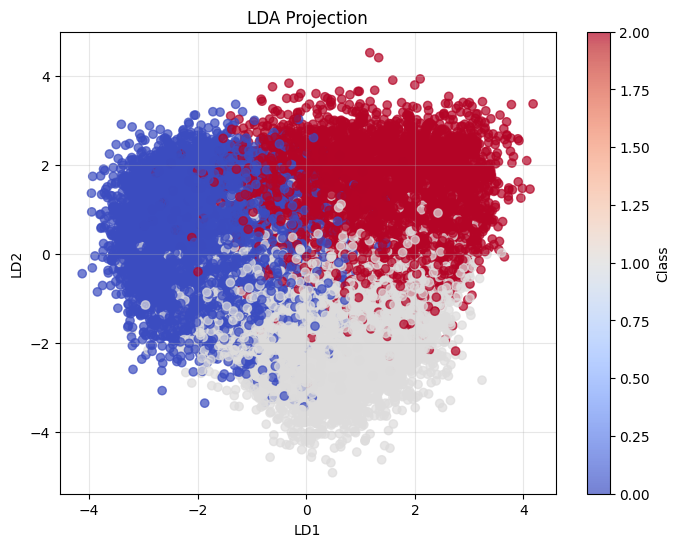

PSO-OPTIMIZED SVM HYPERPARAMETER TUNING

--------------------------------------------------
Method: BASELINE
Training shape: (34830, 309), Test shape: (7464, 309)
Classes: 3
--------------------------------------------------


In [ ]:
bounds = [(1e-3, 1e3), (1e-6, 1e2)]

pipelines = {
    'baseline': (X_train_baseline, y_train, X_test_baseline, y_test),
    'pca': (X_train_pca, y_train, X_test_pca, y_test),
    'ga': (X_train_ga, y_train, X_test_ga, y_test),
}

results = {}

print(f"{'='*70}")
print("PSO-OPTIMIZED SVM HYPERPARAMETER TUNING")
print(f"{'='*70}")

for name, (X_train, y_train, X_test, y_test) in pipelines.items():
    print(f"\n{'-'*50}")
    print(f"Method: {name.upper()}")
    print(f"Training shape: {X_train.shape}, Test shape: {X_test.shape}")
    print(f"Classes: {len(np.unique(y_train))}")
    print(f"{'-'*50}")

    start_time = time.time()

    # Run PSO optimization
    best_params, best_score, history = pso_optimize_enhanced(
        X_train, y_train, bounds,
        n_particles=15, max_iter=20, patience=5, verbose=True
    )

    end_time = time.time()

    # Train final model with best parameters
    best_C, best_gamma = best_params
    print(f"\nOptimal parameters found:")
    print(f"  C = {best_C:.4f}")
    print(f"  gamma = {best_gamma:.6f}")

    # Train and evaluate final model
    model = OneVsRestClassifier(SVC(C=best_C, gamma=best_gamma, kernel='rbf'))
    model.fit(X_train, y_train)

    # Make predictions
    y_pred = model.predict(X_test)
    test_acc = accuracy_score(y_test, y_pred)

    # Save model
    joblib.dump(model, f'/content/drive/MyDrive/Task (2) - Machine Learning/pso_models/best_model_{name}_pso.pkl')
    print(f"Model saved as: best_model_{name}.pkl")

    # Store results
    results[name] = {
        'C': best_C,
        'gamma': best_gamma,
        'val_score': best_score,
        'test_acc': test_acc,
        'history': history,
        'time': end_time - start_time,
        'y_test': y_test,
        'y_pred': y_pred
    }

    print(f"\nResults:")
    print(f"  Validation score: {best_score:.4f}")
    print(f"  Test accuracy: {test_acc:.4f}")
    print(f"  Training time: {end_time - start_time:.1f}s")
    print(f"  Iterations: {len(history)}")

    # Print detailed classification report for this method
    print(f"\n DETAILED CLASSIFICATION REPORT - {name.upper()}:")
    print("=" * 60)
    print(classification_report(y_test, y_pred, digits=4))
    print("=" * 60)

# Print all classification reports together for easy comparison
print(f"\n{'='*80}")
print(" CLASSIFICATION REPORTS COMPARISON")
print(f"{'='*80}")

for name in results:
    print(f"\n {name.upper()} METHOD:")
    print("-" * 50)
    print(classification_report(results[name]['y_test'], results[name]['y_pred'], digits=4))

# Create visualizations
visualize_results(results)

# Print final summary
print(f"\n{'='*70}")
print("FINAL SUMMARY")
print(f"{'='*70}")
best_method = max(results, key=lambda x: results[x]['test_acc'])

print(f"{'Method':<12} {'Test Acc':<10} {'Val Score':<10} {'C':<10} {'Gamma':<12} {'Time':<8}")
print(f"{'-'*70}")

for name in results:
    marker = " ★" if name == best_method else ""
    print(f"{name:<12} {results[name]['test_acc']:<10.4f} "
            f"{results[name]['val_score']:<10.4f} {results[name]['C']:<10.3f} "
            f"{results[name]['gamma']:<12.6f} {results[name]['time']:<8.1f}{marker}")

print(f"\nBest performing method: {best_method.upper()}")
print(f"   Test accuracy: {results[best_method]['test_acc']:.4f}")

### Logistic Regression

In [22]:
from sklearn.metrics import confusion_matrix, classification_report

In [20]:
# Hyperparameter tuning for Logistic Regression on all pipelines
param_grid = {
    'C': [0.0005, 0.001, 0.01, 0.1, 1, 10, 100, 1000],
    'solver': ['lbfgs'],
    'penalty': ['l2'],
    'max_iter': [1000]
}

In [23]:
# 1. Baseline Model (No PCA)
print("\n===== Training Baseline Model (No PCA) =====")
grid_lr_baseline = GridSearchCV(LogisticRegression(random_state=42), param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_lr_baseline.fit(X_train_baseline, y_train)

best_lr_baseline = grid_lr_baseline.best_estimator_
train_acc_baseline = accuracy_score(y_train, best_lr_baseline.predict(X_train_baseline))
val_acc_baseline = accuracy_score(y_val, best_lr_baseline.predict(X_val_baseline))
test_acc_baseline = accuracy_score(y_test, best_lr_baseline.predict(X_test_baseline))

# Confusion matrix and classification report for baseline
y_pred_baseline = best_lr_baseline.predict(X_test_baseline)
print("\nBaseline Model - Test Set Performance:")
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_baseline))
print("\nClassification Report:")
print(classification_report(y_test, y_pred_baseline))


===== Training Baseline Model (No PCA) =====

Baseline Model - Test Set Performance:
Confusion Matrix:
[[2248  145  123]
 [ 170 2031  281]
 [ 209  251 2042]]

Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.89      0.87      2516
           1       0.84      0.82      0.83      2482
           2       0.83      0.82      0.83      2502

    accuracy                           0.84      7500
   macro avg       0.84      0.84      0.84      7500
weighted avg       0.84      0.84      0.84      7500



In [24]:
# 2. PCA Model
print("\n===== Training PCA Model =====")
grid_lr_pca = GridSearchCV(LogisticRegression(random_state=42), param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_lr_pca.fit(X_train_pca, y_train)

best_lr_pca = grid_lr_pca.best_estimator_
train_acc_pca = accuracy_score(y_train, best_lr_pca.predict(X_train_pca))
val_acc_pca = accuracy_score(y_val, best_lr_pca.predict(X_val_pca))
test_acc_pca = accuracy_score(y_test, best_lr_pca.predict(X_test_pca))

# Confusion matrix and classification report for PCA
y_pred_pca = best_lr_pca.predict(X_test_pca)
print("\nPCA Model - Test Set Performance:")
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_pca))
print("\nClassification Report:")
print(classification_report(y_test, y_pred_pca))


===== Training PCA Model =====

PCA Model - Test Set Performance:
Confusion Matrix:
[[2249  145  122]
 [ 171 2028  283]
 [ 209  251 2042]]

Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.89      0.87      2516
           1       0.84      0.82      0.83      2482
           2       0.83      0.82      0.83      2502

    accuracy                           0.84      7500
   macro avg       0.84      0.84      0.84      7500
weighted avg       0.84      0.84      0.84      7500



In [29]:
print("\n===== Training Genetic Algorithm Model =====")
grid_lr_ga = GridSearchCV(LogisticRegression(random_state=42), param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_lr_ga.fit(X_train_ga, y_train)

best_lr_ga = grid_lr_ga.best_estimator_
train_acc_ga = accuracy_score(y_train, best_lr_ga.predict(X_train_ga))
val_acc_ga = accuracy_score(y_val, best_lr_ga.predict(X_val_ga))
test_acc_ga = accuracy_score(y_test, best_lr_ga.predict(X_test_ga))

# Confusion matrix and classification report for GA
y_pred_ga = best_lr_ga.predict(X_test_ga)
print("\nGenetic Algorithm Model - Test Set Performance:")
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_ga))
print("\nClassification Report:")
print(classification_report(y_test, y_pred_ga))


===== Training Genetic Algorithm Model =====

Genetic Algorithm Model - Test Set Performance:
Confusion Matrix:
[[2206  171  139]
 [ 185 1997  300]
 [ 216  273 2013]]

Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.88      0.86      2516
           1       0.82      0.80      0.81      2482
           2       0.82      0.80      0.81      2502

    accuracy                           0.83      7500
   macro avg       0.83      0.83      0.83      7500
weighted avg       0.83      0.83      0.83      7500



In [30]:
# # Print comparison of all models
print("\n===== MODEL COMPARISON =====")
print("Baseline Model (No Feature Selection):")
print(f"Best Params:         {grid_lr_baseline.best_params_}")
print(f"Training Accuracy:   {train_acc_baseline:.4f}")
print(f"Validation Accuracy: {val_acc_baseline:.4f}")
print(f"Testing Accuracy:    {test_acc_baseline:.4f}")

print("\nPCA Model:")
print(f"Best Params:         {grid_lr_pca.best_params_}")
print(f"Training Accuracy:   {train_acc_pca:.4f}")
print(f"Validation Accuracy: {val_acc_pca:.4f}")
print(f"Testing Accuracy:    {test_acc_pca:.4f}")

print("\nGenetic Algorithm Model:")
print(f"Best Params:         {grid_lr_ga.best_params_}")
print(f"Training Accuracy:   {train_acc_ga:.4f}")
print(f"Validation Accuracy: {val_acc_ga:.4f}")
print(f"Testing Accuracy:    {test_acc_ga:.4f}")

# Print feature importance from GA
print("\n===== GA Selected Features =====")
print(f"GA selected {len(selected_indices)} features out of {n_features}")


===== MODEL COMPARISON =====
Baseline Model (No Feature Selection):
Best Params:         {'C': 1, 'max_iter': 1000, 'penalty': 'l2', 'solver': 'lbfgs'}
Training Accuracy:   0.8449
Validation Accuracy: 0.8523
Testing Accuracy:    0.8428

PCA Model:
Best Params:         {'C': 1, 'max_iter': 1000, 'penalty': 'l2', 'solver': 'lbfgs'}
Training Accuracy:   0.8444
Validation Accuracy: 0.8524
Testing Accuracy:    0.8425

Genetic Algorithm Model:
Best Params:         {'C': 1, 'max_iter': 1000, 'penalty': 'l2', 'solver': 'lbfgs'}
Training Accuracy:   0.8287
Validation Accuracy: 0.8396
Testing Accuracy:    0.8288

===== GA Selected Features =====
GA selected 195 features out of 311


### MLP

In [ ]:
### MLP Classifier
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, accuracy_score
import warnings
warnings.filterwarnings("ignore")

# Define the MLP hyperparameter grid
param_grid_mlp = {
    'hidden_layer_sizes': [(64,), (128,), (64, 64), (128, 64)],
    'activation': ['relu', 'tanh'],
    'solver': ['adam'],
    'alpha': [0.0001, 0.001],
    'learning_rate': ['constant', 'adaptive'],
    'max_iter': [200],
    'early_stopping': [True]
}



In [ ]:
# 1. Baseline Model (No PCA)
print("\n===== Training MLP Baseline Model (No PCA) =====")
grid_mlp_baseline = GridSearchCV(MLPClassifier(random_state=42), param_grid_mlp,
                                cv=5, scoring='accuracy', verbose=2, n_jobs=-1)
grid_mlp_baseline.fit(X_train_baseline, y_train)

best_mlp_baseline = grid_mlp_baseline.best_estimator_
train_acc_mlp_baseline = accuracy_score(y_train, best_mlp_baseline.predict(X_train_baseline))
val_acc_mlp_baseline = accuracy_score(y_val, best_mlp_baseline.predict(X_val_baseline))
test_acc_mlp_baseline = accuracy_score(y_test, best_mlp_baseline.predict(X_test_baseline))




===== Training MLP Baseline Model (No PCA) =====
Fitting 5 folds for each of 32 candidates, totalling 160 fits


In [ ]:
# 2. PCA Model
print("\n===== Training MLP PCA Model =====")
grid_mlp_pca = GridSearchCV(MLPClassifier(random_state=42), param_grid_mlp,
                           cv=5, scoring='accuracy', verbose=2, n_jobs=-1)
grid_mlp_pca.fit(X_train_pca, y_train)

best_mlp_pca = grid_mlp_pca.best_estimator_
train_acc_mlp_pca = accuracy_score(y_train, best_mlp_pca.predict(X_train_pca))
val_acc_mlp_pca = accuracy_score(y_val, best_mlp_pca.predict(X_val_pca))
test_acc_mlp_pca = accuracy_score(y_test, best_mlp_pca.predict(X_test_pca))




===== Training MLP PCA Model =====
Fitting 5 folds for each of 32 candidates, totalling 160 fits


In [ ]:
# 3. Genetic Algorithm Model
print("\n===== Training MLP Genetic Algorithm Model =====")
grid_mlp_ga = GridSearchCV(MLPClassifier(random_state=42), param_grid_mlp,
                          cv=5, scoring='accuracy', verbose=2, n_jobs=-1)
grid_mlp_ga.fit(X_train_ga, y_train)

best_mlp_ga = grid_mlp_ga.best_estimator_
train_acc_mlp_ga = accuracy_score(y_train, best_mlp_ga.predict(X_train_ga))
val_acc_mlp_ga = accuracy_score(y_val, best_mlp_ga.predict(X_val_ga))
test_acc_mlp_ga = accuracy_score(y_test, best_mlp_ga.predict(X_test_ga))



===== Training MLP Genetic Algorithm Model =====
Fitting 5 folds for each of 32 candidates, totalling 160 fits


In [ ]:

# Print comparison of all MLP models
print("\n===== MLP MODEL COMPARISON =====")
print("MLP Baseline Model (No Feature Selection):")
print(f"Best Params:         {grid_mlp_baseline.best_params_}")
print(f"Training Accuracy:   {train_acc_mlp_baseline:.4f}")
print(f"Validation Accuracy: {val_acc_mlp_baseline:.4f}")
print(f"Testing Accuracy:    {test_acc_mlp_baseline:.4f}")

print("\nMLP PCA Model:")
print(f"Best Params:         {grid_mlp_pca.best_params_}")
print(f"Training Accuracy:   {train_acc_mlp_pca:.4f}")
print(f"Validation Accuracy: {val_acc_mlp_pca:.4f}")
print(f"Testing Accuracy:    {test_acc_mlp_pca:.4f}")

print("\nMLP Genetic Algorithm Model:")
print(f"Best Params:         {grid_mlp_ga.best_params_}")
print(f"Training Accuracy:   {train_acc_mlp_ga:.4f}")
print(f"Validation Accuracy: {val_acc_mlp_ga:.4f}")
print(f"Testing Accuracy:    {test_acc_mlp_ga:.4f}")

# Print detailed classification reports
print("\n===== Detailed Classification Reports =====")
print("\nMLP Baseline Model Test Performance:")
print(classification_report(y_test, best_mlp_baseline.predict(X_test_baseline)))

print("\nMLP PCA Model Test Performance:")
print(classification_report(y_test, best_mlp_pca.predict(X_test_pca)))

print("\nMLP GA Model Test Performance:")
print(classification_report(y_test, best_mlp_ga.predict(X_test_ga)))


===== MLP MODEL COMPARISON =====
MLP Baseline Model (No Feature Selection):
Best Params:         {'activation': 'tanh', 'alpha': 0.001, 'early_stopping': True, 'hidden_layer_sizes': (128,), 'learning_rate': 'constant', 'max_iter': 200, 'solver': 'adam'}
Training Accuracy:   0.8813
Validation Accuracy: 0.8707
Testing Accuracy:    0.8688

MLP PCA Model:
Best Params:         {'activation': 'tanh', 'alpha': 0.001, 'early_stopping': True, 'hidden_layer_sizes': (64,), 'learning_rate': 'constant', 'max_iter': 200, 'solver': 'adam'}
Training Accuracy:   0.9037
Validation Accuracy: 0.8919
Testing Accuracy:    0.8877

MLP Genetic Algorithm Model:
Best Params:         {'activation': 'tanh', 'alpha': 0.001, 'early_stopping': True, 'hidden_layer_sizes': (64, 64), 'learning_rate': 'constant', 'max_iter': 200, 'solver': 'adam'}
Training Accuracy:   0.8886
Validation Accuracy: 0.8806
Testing Accuracy:    0.8741

===== Detailed Classification Reports =====

MLP Baseline Model Test Performance:
       

In [ ]:
import joblib

# Save baseline model
#joblib.dump(best_mlp_baseline, 'mlp_baseline_model.pkl')

# # Save PCA model
joblib.dump(best_mlp_pca, 'mlp_pca_model.pkl')

# # Save GA model
# joblib.dump(best_mlp_ga, 'mlp_ga_model.pkl')


['mlp_pca_model.pkl']

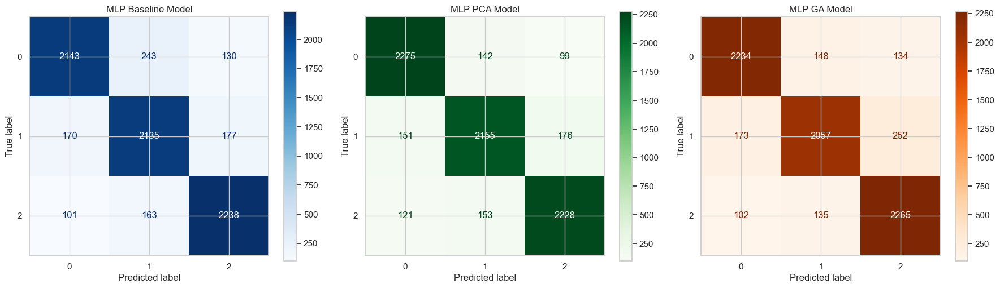

In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Plot confusion matrices
plt.figure(figsize=(18, 5))

# Baseline Confusion Matrix
plt.subplot(1, 3, 1)
cm_baseline = confusion_matrix(y_test, best_mlp_baseline.predict(X_test_baseline))
disp_baseline = ConfusionMatrixDisplay(confusion_matrix=cm_baseline)
disp_baseline.plot(ax=plt.gca(), cmap='Blues')
plt.title('MLP Baseline Model')

# PCA Confusion Matrix
plt.subplot(1, 3, 2)
cm_pca = confusion_matrix(y_test, best_mlp_pca.predict(X_test_pca))
disp_pca = ConfusionMatrixDisplay(confusion_matrix=cm_pca)
disp_pca.plot(ax=plt.gca(), cmap='Greens')
plt.title('MLP PCA Model')

# GA Confusion Matrix
plt.subplot(1, 3, 3)
cm_ga = confusion_matrix(y_test, best_mlp_ga.predict(X_test_ga))
disp_ga = ConfusionMatrixDisplay(confusion_matrix=cm_ga)
disp_ga.plot(ax=plt.gca(), cmap='Oranges')
plt.title('MLP GA Model')

plt.tight_layout()
plt.show()


### Naive Bayes Classifier

In [ ]:
# Enhanced Naive Bayes - Jupyter Notebook Cells with Train/Val Accuracy and Learning Curves

## Cell 1: Import Libraries and Setup
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import GridSearchCV, cross_val_score, learning_curve, validation_curve
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, f1_score, classification_report
import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings('ignore')

# Set plotting style
plt.style.use('default')
sns.set_palette("husl")

In [ ]:
# Define pipelines with validation sets
pipelines = {
    'baseline': (X_train_baseline, X_val_baseline, y_train, y_val, X_test_baseline, y_test),
    'pca': (X_train_pca, X_val_pca, y_train, y_val, X_test_pca, y_test),
    'ga': (X_train_ga_full, X_val_ga_full, y_train, y_val, X_test_ga_full, y_test),
    'lda': (X_train_lda, None, y_train, None, X_test_lda, y_test)  # LDA typically doesn't need validation set
}

# Define hyperparameter grid for Gaussian Naive Bayes
param_grid = {
    'var_smoothing': [1e-9, 1e-8, 1e-7, 1e-6, 1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1.0]
}

# Store results for comparison
results = {}

print("✅ Pipelines and hyperparameter grid defined")
print(f"📊 Pipelines: {list(pipelines.keys())}")
print(f"🔧 Hyperparameter options: {len(param_grid['var_smoothing'])} values")

✅ Pipelines and hyperparameter grid defined
📊 Pipelines: ['baseline', 'pca', 'ga', 'lda']
🔧 Hyperparameter options: 10 values


In [ ]:
print("=== Naive Bayes Classification with Hyperparameter Tuning ===\n")

for pipeline_name, (X_train, X_val, y_train, y_val, X_test, y_test) in pipelines.items():
    print(f"--- Pipeline: {pipeline_name.upper()} ---")

    # Initialize Gaussian Naive Bayes
    nb_model = GaussianNB()

    # Perform Grid Search with Cross-Validation
    print("🔍 Performing hyperparameter tuning...")
    grid_search = GridSearchCV(
        estimator=nb_model,
        param_grid=param_grid,
        cv=5,  # 5-fold cross-validation
        scoring='accuracy',
        n_jobs=-1,
        verbose=0
    )

    # Fit the grid search
    grid_search.fit(X_train, y_train)

    # Get the best model
    best_model = grid_search.best_estimator_
    best_params = grid_search.best_params_
    best_cv_score = grid_search.best_score_

    # Calculate training and validation accuracy
    train_acc = best_model.score(X_train, y_train)
    val_acc = best_model.score(X_val, y_val) if X_val is not None else None

    print(f"✅ Best parameters: {best_params}")
    print(f"📊 Best CV score: {best_cv_score:.4f}")
    print(f"🎓 Training Accuracy: {train_acc:.4f}")
    if val_acc is not None:
        print(f"🔍 Validation Accuracy: {val_acc:.4f}")

    # Make predictions with the best model
    y_pred = best_model.predict(X_test)

    # Calculate metrics
    acc = accuracy_score(y_test, y_pred)
    cm = confusion_matrix(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1 = f1_score(y_test, y_pred, average='weighted')

    # Calculate per-class accuracy
    class_accuracy = cm.diagonal() / cm.sum(axis=1)
    avg_accuracy = np.mean(class_accuracy)

    # Store results
    results[pipeline_name] = {
        'best_params': best_params,
        'cv_score': best_cv_score,
        'train_accuracy': train_acc,
        'val_accuracy': val_acc,
        'test_accuracy': acc,
        'avg_accuracy': avg_accuracy,
        'precision': precision,
        'recall': recall,
        'f1_score': f1,
        'confusion_matrix': cm
    }

    # Print results
    print(f"🎯 Test Accuracy: {acc:.4f}")
    print(f"📈 Average Accuracy (per class): {avg_accuracy:.4f}")
    print(f"⚖️ Precision: {precision:.4f}")
    print(f"🔄 Sensitivity/Recall: {recall:.4f}")
    print(f"📊 F1 Score: {f1:.4f}")
    print("Confusion Matrix:")
    print(cm)
    print("\nClassification Report:")
    print(classification_report(y_test, y_pred))
    print("-" * 60)
    print()

print("✅ All pipelines completed!")

=== Naive Bayes Classification with Hyperparameter Tuning ===

--- Pipeline: BASELINE ---
🔍 Performing hyperparameter tuning...
✅ Best parameters: {'var_smoothing': 0.1}
📊 Best CV score: 0.8034
🎓 Training Accuracy: 0.8046
🔍 Validation Accuracy: 0.8086
🎯 Test Accuracy: 0.8043
📈 Average Accuracy (per class): 0.8038
⚖️ Precision: 0.8041
🔄 Sensitivity/Recall: 0.8043
📊 F1 Score: 0.8035
Confusion Matrix:
[[2208  213   95]
 [ 265 1853  327]
 [ 234  327 1942]]

Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.88      0.85      2516
           1       0.77      0.76      0.77      2445
           2       0.82      0.78      0.80      2503

    accuracy                           0.80      7464
   macro avg       0.80      0.80      0.80      7464
weighted avg       0.80      0.80      0.80      7464

------------------------------------------------------------

--- Pipeline: PCA ---
🔍 Performing hyperparameter tuning...
✅ Best parameter

=== LEARNING CURVES ANALYSIS ===


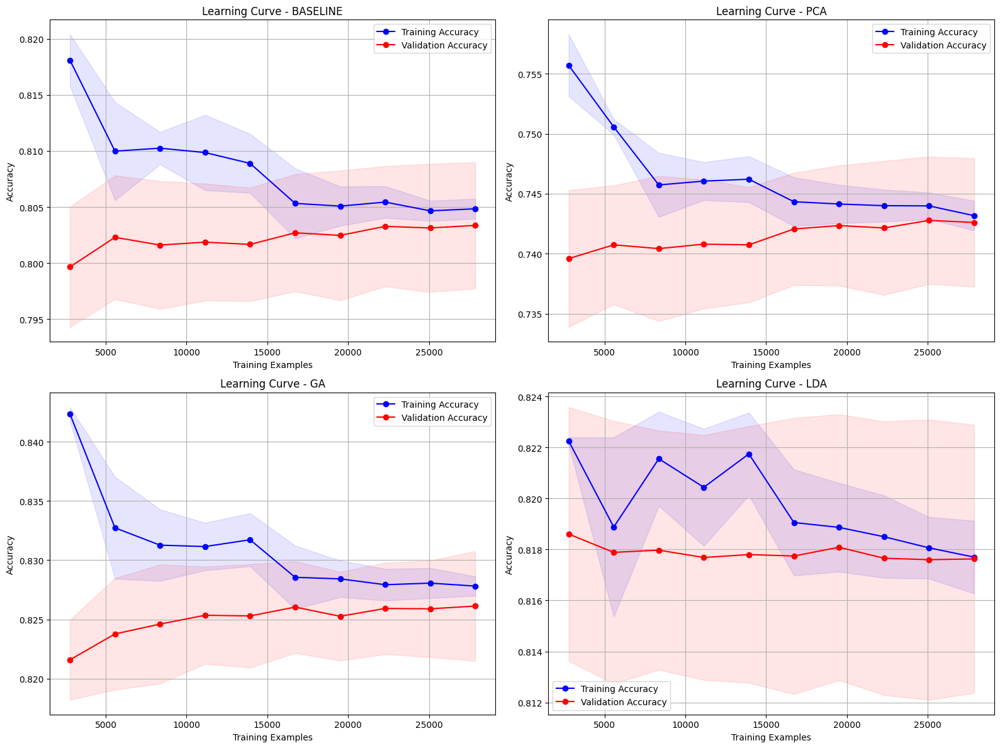

In [ ]:
print("=== LEARNING CURVES ANALYSIS ===")

fig, axes = plt.subplots(2, 2, figsize=(16, 12))
axes = axes.flatten()

for idx, pipeline_name in enumerate(pipelines.keys()):
    X_train, X_val, y_train, y_val, X_test, y_test = pipelines[pipeline_name]

    # Get best parameters
    best_params = results[pipeline_name]['best_params']

    # Create learning curve data
    train_sizes, train_scores, val_scores = learning_curve(
        GaussianNB(**best_params),
        X_train,
        y_train,
        cv=5,
        scoring='accuracy',
        train_sizes=np.linspace(0.1, 1.0, 10),
        n_jobs=-1
    )

    # Calculate mean and std
    train_mean = np.mean(train_scores, axis=1)
    train_std = np.std(train_scores, axis=1)
    val_mean = np.mean(val_scores, axis=1)
    val_std = np.std(val_scores, axis=1)

    # Plot learning curve
    ax = axes[idx]
    ax.plot(train_sizes, train_mean, 'o-', color='b', label='Training Accuracy')
    ax.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, alpha=0.1, color='b')
    ax.plot(train_sizes, val_mean, 'o-', color='r', label='Validation Accuracy')
    ax.fill_between(train_sizes, val_mean - val_std, val_mean + val_std, alpha=0.1, color='r')

    ax.set_title(f'Learning Curve - {pipeline_name.upper()}')
    ax.set_xlabel('Training Examples')
    ax.set_ylabel('Accuracy')
    ax.legend(loc='best')
    ax.grid(True)

plt.tight_layout()
plt.show()

=== VALIDATION CURVES ANALYSIS ===


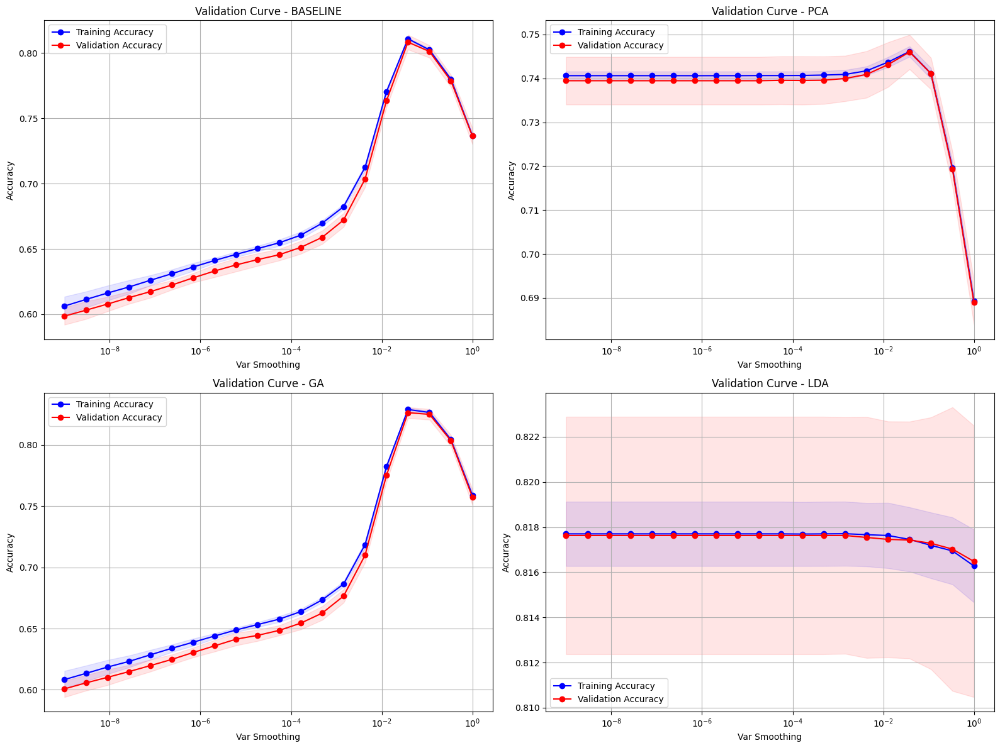

In [ ]:
print("=== VALIDATION CURVES ANALYSIS ===")

fig, axes = plt.subplots(2, 2, figsize=(16, 12))
axes = axes.flatten()

for idx, pipeline_name in enumerate(pipelines.keys()):
    X_train, X_val, y_train, y_val, X_test, y_test = pipelines[pipeline_name]

    # Create validation curve data
    param_range = np.logspace(-9, 0, 20)
    train_scores, val_scores = validation_curve(
        GaussianNB(),
        X_train,
        y_train,
        param_name="var_smoothing",
        param_range=param_range,
        cv=5,
        scoring="accuracy",
        n_jobs=-1
    )

    # Calculate mean and std
    train_mean = np.mean(train_scores, axis=1)
    train_std = np.std(train_scores, axis=1)
    val_mean = np.mean(val_scores, axis=1)
    val_std = np.std(val_scores, axis=1)

    # Plot validation curve
    ax = axes[idx]
    ax.semilogx(param_range, train_mean, 'o-', color='b', label='Training Accuracy')
    ax.fill_between(param_range, train_mean - train_std, train_mean + train_std, alpha=0.1, color='b')
    ax.semilogx(param_range, val_mean, 'o-', color='r', label='Validation Accuracy')
    ax.fill_between(param_range, val_mean - val_std, val_mean + val_std, alpha=0.1, color='r')

    ax.set_title(f'Validation Curve - {pipeline_name.upper()}')
    ax.set_xlabel('Var Smoothing')
    ax.set_ylabel('Accuracy')
    ax.legend(loc='best')
    ax.grid(True)

plt.tight_layout()
plt.show()

=== CONFUSION MATRIX VISUALIZATIONS ===



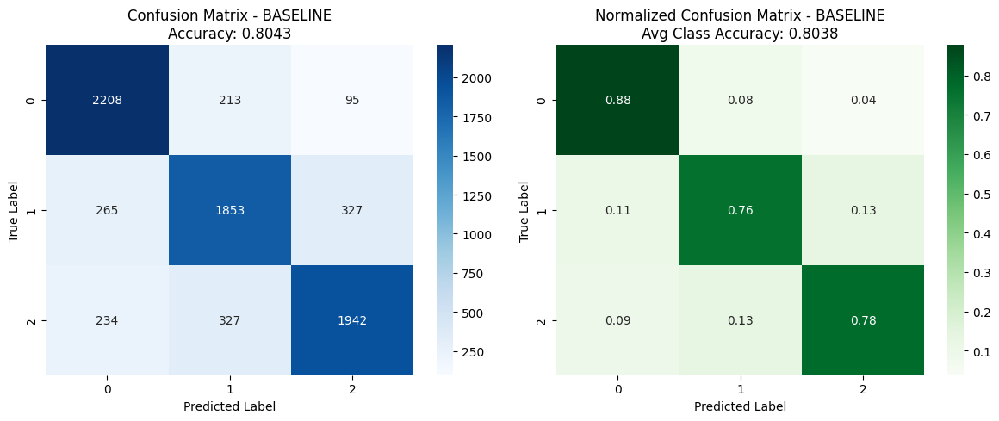

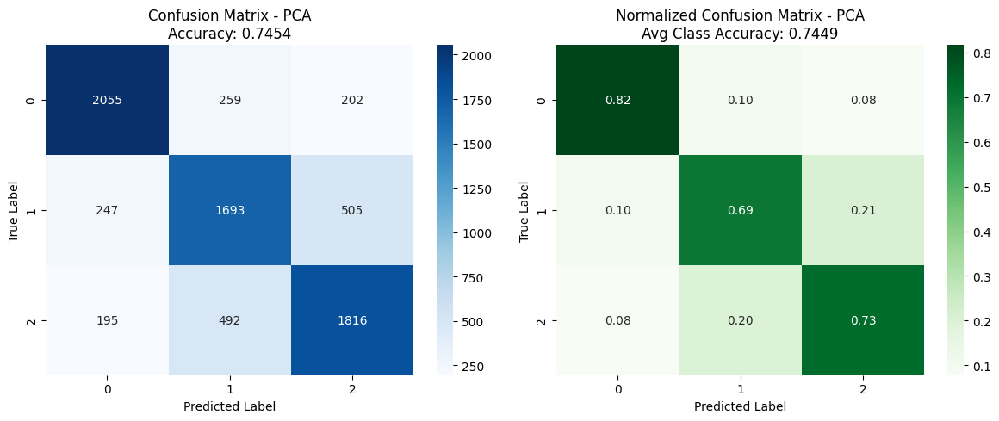

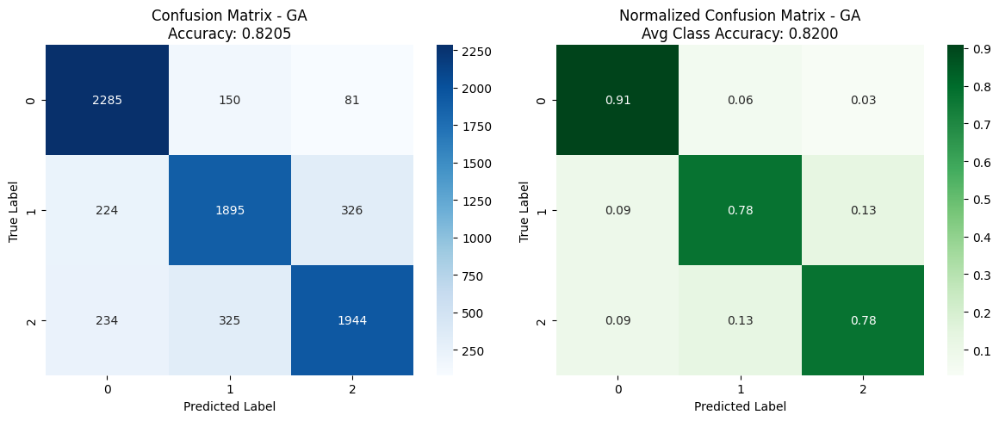

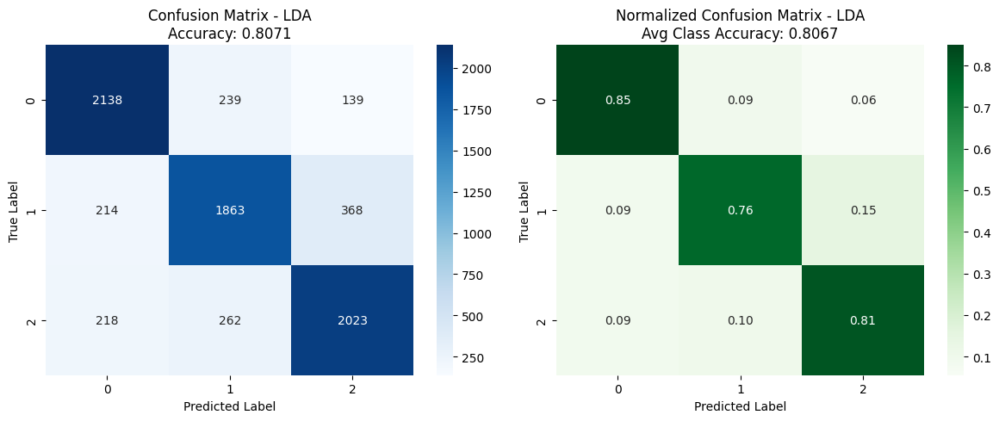

In [ ]:
# Visualization of confusion matrix for all pipelines
print("=== CONFUSION MATRIX VISUALIZATIONS ===\n")

for pipeline_name in pipelines.keys():
    cm = results[pipeline_name]['confusion_matrix']
    test_accuracy = results[pipeline_name]['test_accuracy']
    avg_accuracy = results[pipeline_name]['avg_accuracy']

    # Visualization of confusion matrix
    plt.figure(figsize=(12, 5))

    # Original confusion matrix
    plt.subplot(1, 2, 1)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=np.unique(y_test),
                yticklabels=np.unique(y_test))
    plt.title(f'Confusion Matrix - {pipeline_name.upper()}\nAccuracy: {test_accuracy:.4f}')
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')

    # Normalized confusion matrix
    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    plt.subplot(1, 2, 2)
    sns.heatmap(cm_normalized, annot=True, fmt='.2f', cmap='Greens',
                xticklabels=np.unique(y_test),
                yticklabels=np.unique(y_test))
    plt.title(f'Normalized Confusion Matrix - {pipeline_name.upper()}\nAvg Class Accuracy: {avg_accuracy:.4f}')
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')

    plt.tight_layout()
    plt.show()
    print()

In [ ]:
# Create enhanced comparison summary
print("=== COMPARISON SUMMARY ===")
comparison_df = pd.DataFrame({
    'Pipeline': list(results.keys()),
    'Best Var Smoothing': [results[k]['best_params']['var_smoothing'] for k in results.keys()],
    'CV Score': [results[k]['cv_score'] for k in results.keys()],
    'Training Accuracy': [results[k]['train_accuracy'] for k in results.keys()],
    'Validation Accuracy': [results[k]['val_accuracy'] if results[k]['val_accuracy'] is not None else np.nan for k in results.keys()],
    'Test Accuracy': [results[k]['test_accuracy'] for k in results.keys()],
    'Precision': [results[k]['precision'] for k in results.keys()],
    'Recall': [results[k]['recall'] for k in results.keys()],
    'F1 Score': [results[k]['f1_score'] for k in results.keys()]
})

print(comparison_df.round(4))

=== COMPARISON SUMMARY ===
   Pipeline  Best Var Smoothing  CV Score  Training Accuracy  \
0  baseline                0.10    0.8034             0.8046   
1       pca                0.01    0.7426             0.7428   
2        ga                0.10    0.8261             0.8280   
3       lda                0.00    0.8176             0.8179   

   Validation Accuracy  Test Accuracy  Precision  Recall  F1 Score  
0               0.8086         0.8043     0.8041  0.8043    0.8035  
1               0.7489         0.7454     0.7457  0.7454    0.7456  
2               0.8311         0.8205     0.8200  0.8205    0.8194  
3                  NaN         0.8071     0.8067  0.8071    0.8068  


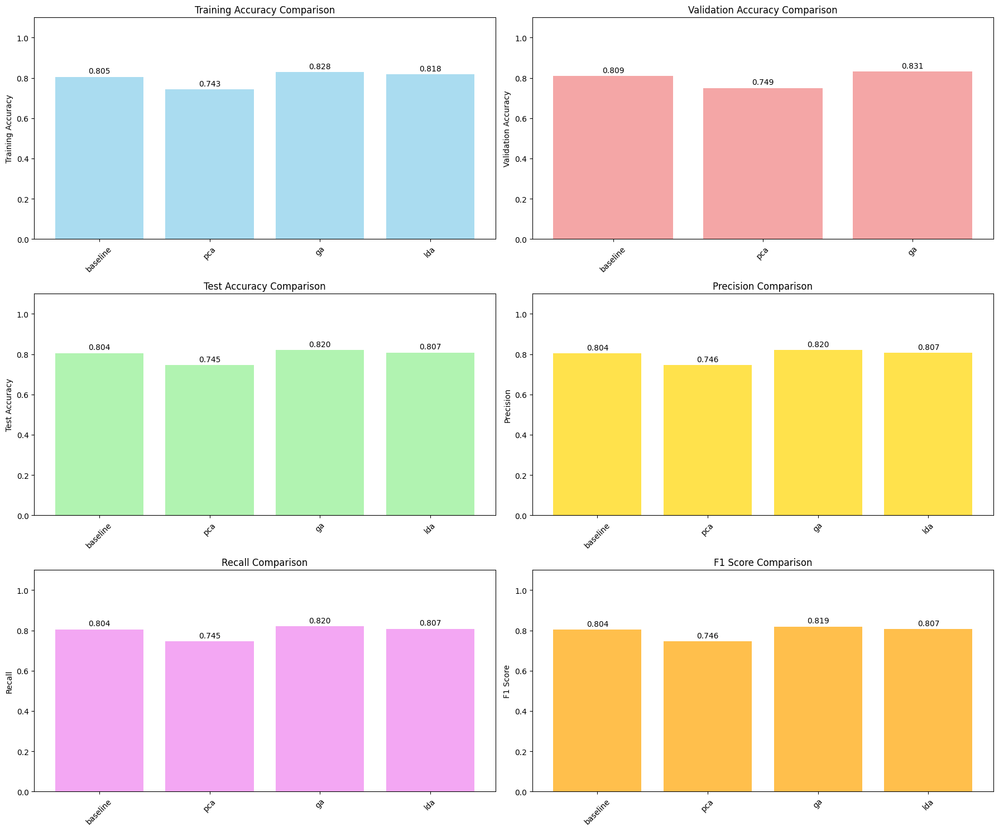

In [ ]:
# Enhanced visualization with training and validation metrics
fig, axes = plt.subplots(3, 2, figsize=(18, 15))

metrics = ['Training Accuracy', 'Validation Accuracy', 'Test Accuracy', 'Precision', 'Recall', 'F1 Score']
colors = ['skyblue', 'lightcoral', 'lightgreen', 'gold', 'violet', 'orange']

for i, (metric, color) in enumerate(zip(metrics, colors)):
    ax = axes[i//2, i%2]

    # Skip validation accuracy for LDA if it's None
    if metric == 'Validation Accuracy':
        valid_pipelines = [p for p in comparison_df['Pipeline'] if not pd.isna(comparison_df.loc[comparison_df['Pipeline'] == p, metric].values[0])]
        values = [comparison_df.loc[comparison_df['Pipeline'] == p, metric].values[0] for p in valid_pipelines]
        bars = ax.bar(valid_pipelines, values, color=color, alpha=0.7)
    else:
        bars = ax.bar(comparison_df['Pipeline'], comparison_df[metric], color=color, alpha=0.7)

    ax.set_title(f'{metric} Comparison')
    ax.set_ylabel(metric)
    ax.set_ylim(0, 1.1)

    # Add value labels on bars
    for bar in bars:
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width()/2., height + 0.01,
                f'{height:.3f}', ha='center', va='bottom')

    # Rotate x-axis labels for better readability
    ax.tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

In [ ]:
# Find and highlight best performing pipeline
best_pipeline = comparison_df.loc[comparison_df['Test Accuracy'].idxmax(), 'Pipeline']
best_accuracy = comparison_df['Test Accuracy'].max()

print(f"\n🏆 BEST PERFORMING PIPELINE: {best_pipeline.upper()}")
print(f"   📊 Test Accuracy: {best_accuracy:.4f}")
print(f"   🔧 Best Parameters: {results[best_pipeline]['best_params']}")
print(f"   📈 CV Score: {results[best_pipeline]['cv_score']:.4f}")
print(f"   ⚖️ F1 Score: {results[best_pipeline]['f1_score']:.4f}")

# Display detailed metrics for best pipeline
print(f"\n📋 DETAILED METRICS FOR {best_pipeline.upper()}:")
print(f"   • Precision: {results[best_pipeline]['precision']:.4f}")
print(f"   • Recall: {results[best_pipeline]['recall']:.4f}")
print(f"   • Average Class Accuracy: {results[best_pipeline]['avg_accuracy']:.4f}")


🏆 BEST PERFORMING PIPELINE: GA
   📊 Test Accuracy: 0.8205
   🔧 Best Parameters: {'var_smoothing': 0.1}
   📈 CV Score: 0.8261
   ⚖️ F1 Score: 0.8194

📋 DETAILED METRICS FOR GA:
   • Precision: 0.8200
   • Recall: 0.8205
   • Average Class Accuracy: 0.8200


=== HYPERPARAMETER TUNING RESULTS ===


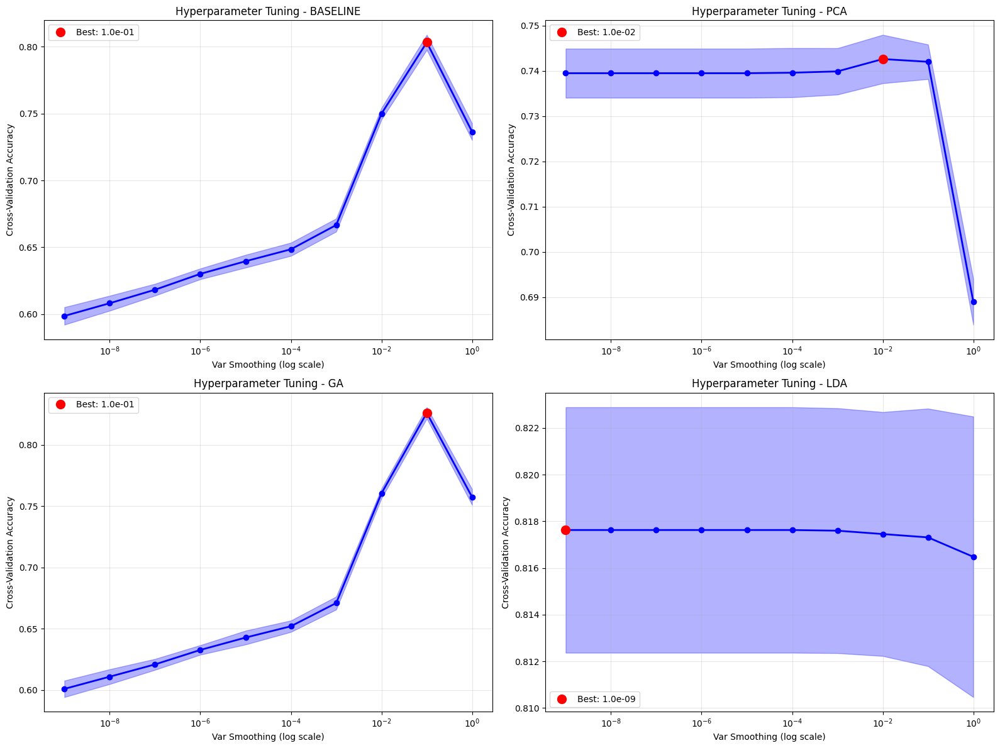

In [ ]:
# Hyperparameter tuning visualization
print("=== HYPERPARAMETER TUNING RESULTS ===")

fig, axes = plt.subplots(2, 2, figsize=(16, 12))
axes = axes.flatten()

for idx, pipeline_name in enumerate(pipelines.keys()):
    # Re-run grid search to get all scores for visualization
    nb_model = GaussianNB()
    grid_search = GridSearchCV(
        estimator=nb_model,
        param_grid=param_grid,
        cv=5,
        scoring='accuracy',
        n_jobs=-1
    )

    X_train, X_val, y_train, y_val, X_test, y_test = pipelines[pipeline_name]
    grid_search.fit(X_train, y_train)

    # Plot hyperparameter tuning results
    param_values = param_grid['var_smoothing']
    mean_scores = [grid_search.cv_results_['mean_test_score'][i] for i in range(len(param_values))]
    std_scores = [grid_search.cv_results_['std_test_score'][i] for i in range(len(param_values))]

    ax = axes[idx]
    ax.semilogx(param_values, mean_scores, 'bo-', linewidth=2, markersize=6)
    ax.fill_between(param_values,
                    np.array(mean_scores) - np.array(std_scores),
                    np.array(mean_scores) + np.array(std_scores),
                    alpha=0.3, color='blue')
    ax.set_title(f'Hyperparameter Tuning - {pipeline_name.upper()}')
    ax.set_xlabel('Var Smoothing (log scale)')
    ax.set_ylabel('Cross-Validation Accuracy')
    ax.grid(True, alpha=0.3)

    # Highlight best parameter
    best_idx = np.argmax(mean_scores)
    ax.plot(param_values[best_idx], mean_scores[best_idx], 'ro', markersize=10,
            label=f'Best: {param_values[best_idx]:.1e}')
    ax.legend()

plt.tight_layout()
plt.show()

In [ ]:
# Additional cross-validation analysis
print("=== CROSS-VALIDATION STABILITY ANALYSIS ===")

cv_results_summary = []

for pipeline_name, (X_train, X_val, y_train, y_val, X_test, y_test) in pipelines.items():
    best_params = results[pipeline_name]['best_params']
    # Use the unpacked variables as needed


    # Create model with best parameters
    best_nb_model = GaussianNB(**best_params)

    # Perform cross-validation
    cv_scores = cross_val_score(best_nb_model, X_train, y_train, cv=10, scoring='accuracy')

    cv_results_summary.append({
        'Pipeline': pipeline_name,
        'CV Mean': cv_scores.mean(),
        'CV Std': cv_scores.std(),
        'CV Min': cv_scores.min(),
        'CV Max': cv_scores.max()
    })

    print(f"{pipeline_name.upper()}:")
    print(f"  📊 CV Mean ± Std: {cv_scores.mean():.4f} ± {cv_scores.std():.4f}")
    print(f"  📈 CV Range: [{cv_scores.min():.4f}, {cv_scores.max():.4f}]")

# Create CV results dataframe
cv_df = pd.DataFrame(cv_results_summary)
print("\n" + "="*50)
print(cv_df.round(4))

=== CROSS-VALIDATION STABILITY ANALYSIS ===
BASELINE:
  📊 CV Mean ± Std: 0.8030 ± 0.0087
  📈 CV Range: [0.7858, 0.8128]
PCA:
  📊 CV Mean ± Std: 0.7431 ± 0.0092
  📈 CV Range: [0.7247, 0.7577]
GA:
  📊 CV Mean ± Std: 0.8260 ± 0.0074
  📈 CV Range: [0.8122, 0.8352]
LDA:
  📊 CV Mean ± Std: 0.8176 ± 0.0084
  📈 CV Range: [0.8002, 0.8315]

   Pipeline  CV Mean  CV Std  CV Min  CV Max
0  baseline   0.8030  0.0087  0.7858  0.8128
1       pca   0.7431  0.0092  0.7247  0.7577
2        ga   0.8260  0.0074  0.8122  0.8352
3       lda   0.8176  0.0084  0.8002  0.8315


=== VAR_SMOOTHING PARAMETER IMPACT ANALYSIS ===


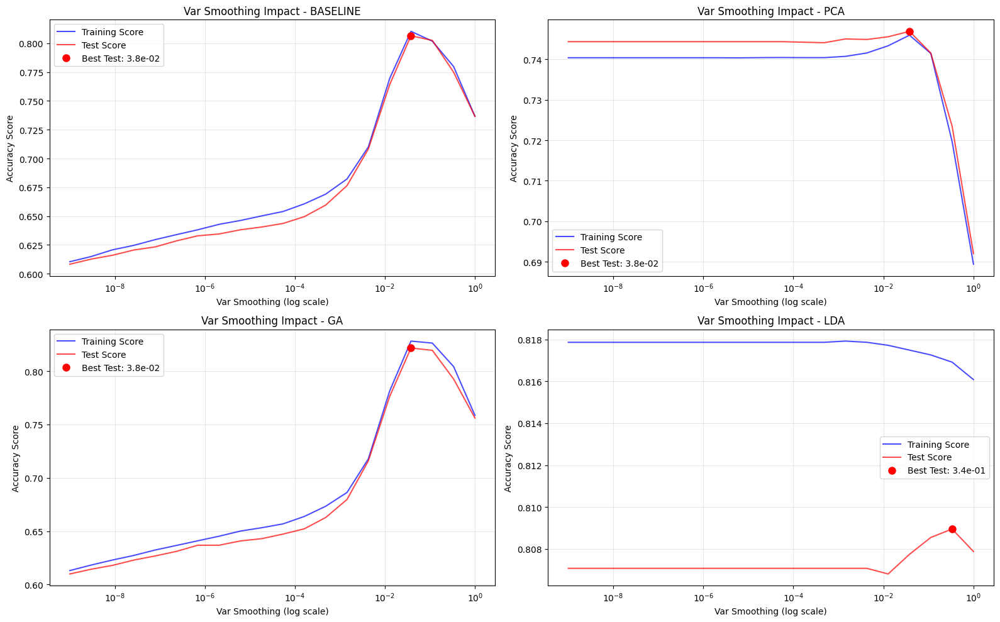

In [ ]:
# Analyze the impact of var_smoothing parameter
print("=== VAR_SMOOTHING PARAMETER IMPACT ANALYSIS ===")

# Create a comprehensive analysis plot
fig, axes = plt.subplots(2, 2, figsize=(16, 10))
axes = axes.flatten()

for idx, pipeline_name in enumerate(pipelines.keys()):
    X_train, X_val, y_train, y_val, X_test, y_test = pipelines[pipeline_name]

    # Test different var_smoothing values
    smoothing_values = np.logspace(-9, 0, 20)  # More granular analysis
    train_scores = []
    test_scores = []

    for smoothing in smoothing_values:
        nb_model = GaussianNB(var_smoothing=smoothing)
        nb_model.fit(X_train, y_train)

        train_score = nb_model.score(X_train, y_train)
        test_score = nb_model.score(X_test, y_test)

        train_scores.append(train_score)
        test_scores.append(test_score)

    ax = axes[idx]
    ax.semilogx(smoothing_values, train_scores, 'b-', label='Training Score', alpha=0.7)
    ax.semilogx(smoothing_values, test_scores, 'r-', label='Test Score', alpha=0.7)

    # Highlight best test score
    best_test_idx = np.argmax(test_scores)
    ax.plot(smoothing_values[best_test_idx], test_scores[best_test_idx],
            'ro', markersize=8, label=f'Best Test: {smoothing_values[best_test_idx]:.1e}')

    ax.set_title(f'Var Smoothing Impact - {pipeline_name.upper()}')
    ax.set_xlabel('Var Smoothing (log scale)')
    ax.set_ylabel('Accuracy Score')
    ax.legend()
    ax.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

In [ ]:
# Optional: Save results to files
comparison_df.to_csv('naive_bayes_comparison.csv', index=False)

# Save detailed results
detailed_results = []
for pipeline_name, result_data in results.items():
    detailed_results.append({
        'Pipeline': pipeline_name,
        'Best_Var_Smoothing': result_data['best_params']['var_smoothing'],
        'CV_Score': result_data['cv_score'],
        'train_accuracy': result_data['train_accuracy'],
        'val_accuracy': result_data['val_accuracy'],
        'Test_Accuracy': result_data['test_accuracy'],
        'Precision': result_data['precision'],
        'Recall': result_data['recall'],
        'F1_Score': result_data['f1_score'],
        'Avg_Class_Accuracy': result_data['avg_accuracy']
    })


pd.DataFrame(detailed_results).to_csv('naive_bayes_detailed_results.csv', index=False)

# Save cross-validation results
cv_df.to_csv('naive_bayes_cv_analysis.csv', index=False)

print("✅ Results exported to CSV files:")
print("   • naive_bayes_comparison.csv")
print("   • naive_bayes_detailed_results.csv")
print("   • naive_bayes_cv_analysis.csv")

print(f"\n🎉 Complete analysis finished!")
print(f"🏆 Best pipeline: {best_pipeline.upper()} with {best_accuracy:.4f} accuracy")

✅ Results exported to CSV files:
   • naive_bayes_comparison.csv
   • naive_bayes_detailed_results.csv
   • naive_bayes_cv_analysis.csv

🎉 Complete analysis finished!
🏆 Best pipeline: GA with 0.8205 accuracy


### Ensemble Method (GradientBoostingClassifier-XGBClassifier-RandomForest-AdaBoost)

In [ ]:
import torch
print("CUDA available:", torch.cuda.is_available())
print("GPU:", torch.cuda.get_device_name(0))


CUDA available: True
GPU: NVIDIA GeForce RTX 2070 with Max-Q Design


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim

# Check and set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)


Using device: cuda


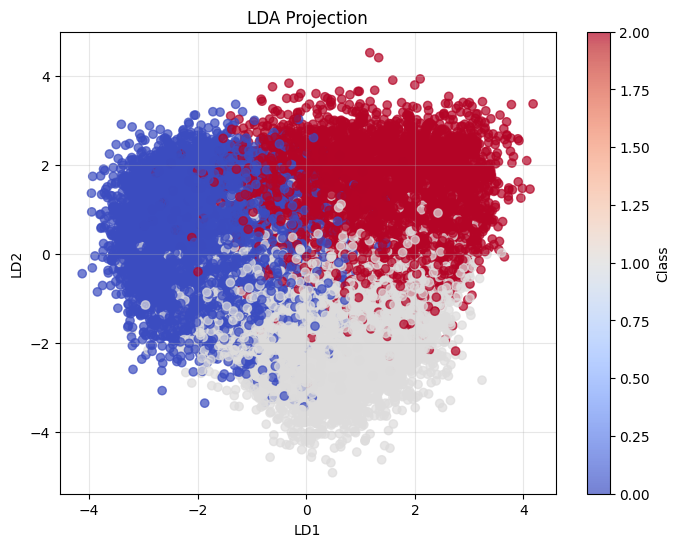

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, f1_score, classification_report
import numpy as np
import pandas as pd
import time
import warnings
warnings.filterwarnings('ignore')

# Set plotting style
plt.style.use('default')
sns.set_palette("husl")

# X_train_lda, X_test_lda, lda_model = create_lda_features(X_train_baseline, y_train, X_test_baseline)
# plot_lda_projection(X_train_lda, y_train)

In [ ]:
!pip install xgboost


In [ ]:
# Define pipelines
pipelines = {
    'baseline': (X_train_baseline, X_val_baseline, y_train, y_val, X_test_baseline, y_test),
    'pca': (X_train_pca, X_val_pca, y_train, y_val, X_test_pca, y_test),
    'ga': (X_train_ga, X_val_ga, y_train, y_val, X_test_ga_full, y_test),
    'lda': (X_train_lda, None, y_train, None, X_test_lda, y_test)  # LDA typically doesn't need validation set
}

# Define models and their hyperparameter grids
models_config = {
    'Random Forest': {
        'model': RandomForestClassifier(random_state=42),
        'params': {
            'n_estimators': [50, 100, 200],
            'max_depth': [None, 10, 20, 30],
            'min_samples_split': [2, 5, 10],
            'min_samples_leaf': [1, 2, 4],
            'max_features': ['sqrt', 'log2']
        }
    },
    'Gradient Boosting': {
        'model': GradientBoostingClassifier(random_state=42),
        'params': {
            'n_estimators': [50, 100, 200],
            'learning_rate': [0.01, 0.1, 0.2],
            'max_depth': [3, 5, 7],
            'min_samples_split': [2, 5, 10],
            'min_samples_leaf': [1, 2, 4]
        }
    },
    'AdaBoost': {
        'model': AdaBoostClassifier(random_state=42),
        'params': {
            'n_estimators': [50, 100, 200],
            'learning_rate': [0.01, 0.1, 0.5, 1.0],
            'algorithm': ['SAMME', 'SAMME.R']
        }
    },
    'XGBoost': {
        'model': XGBClassifier(tree_method='gpu_hist', predictor='gpu_predictor', random_state=42, eval_metric='logloss'),
        'params': {
            'n_estimators': [50, 100, 200],
            'learning_rate': [0.01, 0.1, 0.2],
            'max_depth': [3, 5, 7],
            'min_child_weight': [1, 3, 5],
            'subsample': [0.8, 0.9, 1.0],
            'colsample_bytree': [0.8, 0.9, 1.0]
        }
    }
}

print("✅ Pipelines and model configurations defined")
print(f"📊 Pipelines: {list(pipelines.keys())}")
print(f"🤖 Models: {list(models_config.keys())}")
print(X_val_baseline.shape)

✅ Pipelines and model configurations defined
📊 Pipelines: ['baseline', 'pca', 'ga', 'lda']
🤖 Models: ['Random Forest', 'Gradient Boosting', 'AdaBoost', 'XGBoost']
(7466, 309)


In [ ]:
# Store all results
all_results = {}

print("=== Enhanced Ensemble Models with Hyperparameter Tuning ===\n")

for pipeline_name, (X_train, X_val, y_train, y_val, X_test, y_test) in pipelines.items():
    print(f"--- Pipeline: {pipeline_name.upper()} ---")
    print("=" * 60)
    # print(X_val.shape)
    # print(y_val.shape)

    pipeline_results = {}

    for model_name, config in models_config.items():
        print(f"\n--- {model_name} on {pipeline_name.upper()} ---")

        start_time = time.time()

        # Use RandomizedSearchCV for faster hyperparameter tuning
        n_iter = 20 if model_name in ['XGBoost', 'Gradient Boosting'] else 30

        random_search = RandomizedSearchCV(
            estimator=config['model'],
            param_distributions=config['params'],
            n_iter=n_iter,
            cv=3,
            scoring='accuracy',
            n_jobs=-1,
            random_state=42,
            verbose=0
        )

        # Fit the random search
        print("🔍 Performing hyperparameter tuning...")
        random_search.fit(X_train, y_train)

        # Get the best model
        best_model = random_search.best_estimator_
        best_params = random_search.best_params_
        best_cv_score = random_search.best_score_

        # Make predictions
        y_train_pred = best_model.predict(X_train)
        y_val_pred = best_model.predict(X_val) if X_val is not None else None
        y_test_pred = best_model.predict(X_test)

        # Calculate metrics
        train_acc = accuracy_score(y_train, y_train_pred)
        val_acc = accuracy_score(y_val, y_val_pred) if y_val is not None else None
        test_acc = accuracy_score(y_test, y_test_pred)

        cm = confusion_matrix(y_test, y_test_pred)
        precision = precision_score(y_test, y_test_pred, average='weighted')
        recall = recall_score(y_test, y_test_pred, average='weighted')
        f1 = f1_score(y_test, y_test_pred, average='weighted')

        # Per-class accuracy
        class_accuracy = cm.diagonal() / cm.sum(axis=1)
        avg_accuracy = np.mean(class_accuracy)

        training_time = time.time() - start_time

        # Store results
        pipeline_results[model_name] = {
            'best_params': best_params,
            'cv_score': best_cv_score,
            'train_accuracy': train_acc,
            'val_accuracy': val_acc,
            'test_accuracy': test_acc,
            'avg_accuracy': avg_accuracy,
            'precision': precision,
            'recall': recall,
            'f1_score': f1,
            'confusion_matrix': cm,
            'training_time': training_time,
            'best_model': best_model
        }

        # Print results
        print(f"✅ Best CV Score: {best_cv_score:.4f}")
        print(f"🏋️ Train Accuracy: {train_acc:.4f}")
        if val_acc is not None:
            print(f"🔍 Validation Accuracy: {val_acc:.4f}")
        print(f"📊 Test Accuracy: {test_acc:.4f}")
        print(f"📈 Precision: {precision:.4f}")
        print(f"🎯 Recall: {recall:.4f}")
        print(f"⚖️ F1 Score: {f1:.4f}")
        print(f"⏱️ Training Time: {training_time:.2f}s")
        print(f"🔧 Best Parameters: {best_params}")

    all_results[pipeline_name] = pipeline_results
    print(f"\n✅ Completed pipeline: {pipeline_name.upper()}")
    print("=" * 60)

print("\n🎉 All models trained successfully!")


=== Enhanced Ensemble Models with Hyperparameter Tuning ===

--- Pipeline: BASELINE ---

--- Random Forest on BASELINE ---
🔍 Performing hyperparameter tuning...
✅ Best CV Score: 0.8575
🏋️ Train Accuracy: 0.9857
🔍 Validation Accuracy: 0.8632
📊 Test Accuracy: 0.8589
📈 Precision: 0.8587
🎯 Recall: 0.8589
⚖️ F1 Score: 0.8588
⏱️ Training Time: 120.46s
🔧 Best Parameters: {'n_estimators': 50, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 'log2', 'max_depth': None}

--- Gradient Boosting on BASELINE ---
🔍 Performing hyperparameter tuning...
✅ Best CV Score: 0.8798
🏋️ Train Accuracy: 0.9616
🔍 Validation Accuracy: 0.8831
📊 Test Accuracy: 0.8767
📈 Precision: 0.8766
🎯 Recall: 0.8767
⚖️ F1 Score: 0.8765
⏱️ Training Time: 3779.18s
🔧 Best Parameters: {'n_estimators': 200, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_depth': 7, 'learning_rate': 0.2}

--- AdaBoost on BASELINE ---
🔍 Performing hyperparameter tuning...
✅ Best CV Score: 0.8018
🏋️ Train Accuracy: 0.8004
🔍 Validation 

In [ ]:
# Create comprehensive comparison
print("=== COMPREHENSIVE RESULTS COMPARISON ===")

# Prepare data for comparison table
comparison_data = []
for pipeline_name, pipeline_results in all_results.items():
    for model_name, results in pipeline_results.items():
        comparison_data.append({
            'Pipeline': pipeline_name,
            'Model': model_name,
            'CV Score': results['cv_score'],
            'Train Accuracy': results['train_accuracy'],
            'Validation Accuracy': results['val_accuracy'],
            'Test Accuracy': results['test_accuracy'],
            'Precision': results['precision'],
            'Recall': results['recall'],
            'F1 Score': results['f1_score'],
            'Training Time (s)': results['training_time']
        })

comparison_df = pd.DataFrame(comparison_data)
print(comparison_df.round(4))

# Find best overall model based on Test Accuracy
best_idx = comparison_df['Test Accuracy'].idxmax()
best_result = comparison_df.iloc[best_idx]
print(f"\n🏆 BEST OVERALL MODEL:")
print(f"   Pipeline: {best_result['Pipeline'].upper()}")
print(f"   Model: {best_result['Model']}")
print(f"   Test Accuracy: {best_result['Test Accuracy']:.4f}")


=== COMPREHENSIVE RESULTS COMPARISON ===
    Pipeline              Model  CV Score  Train Accuracy  \
0   baseline      Random Forest    0.8575          0.9857   
1   baseline  Gradient Boosting    0.8798          0.9616   
2   baseline           AdaBoost    0.8018          0.8004   
3   baseline            XGBoost    0.8812          0.9046   
4        pca      Random Forest    0.8288          0.9785   
5        pca  Gradient Boosting    0.8446          0.9479   
6        pca           AdaBoost    0.7589          0.7709   
7        pca            XGBoost    0.8480          0.9803   
8         ga      Random Forest    0.8879          0.9283   
9         ga  Gradient Boosting    0.9102          0.9506   
10        ga           AdaBoost    0.8304          0.8311   
11        ga            XGBoost    0.9090          0.9343   
12       lda      Random Forest    0.8184          0.8401   
13       lda  Gradient Boosting    0.8187          0.8245   
14       lda           AdaBoost    0.8163   

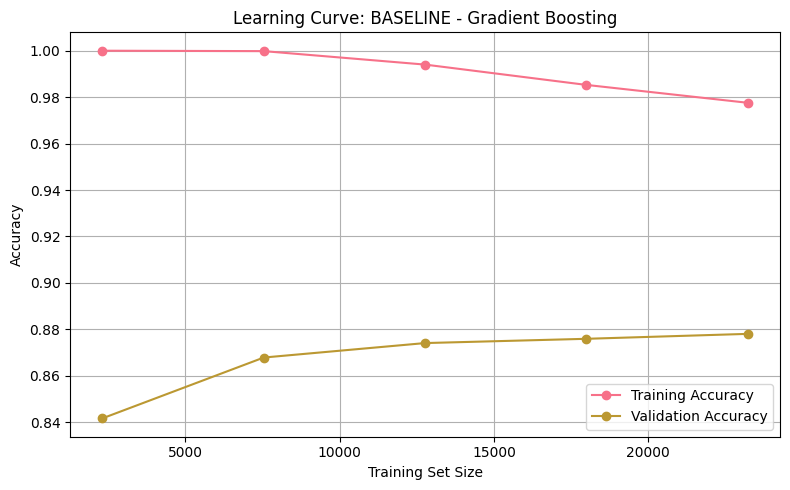

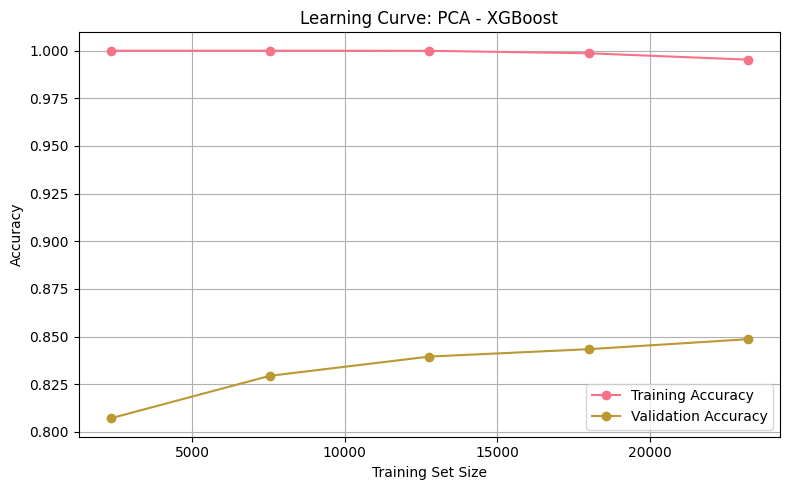

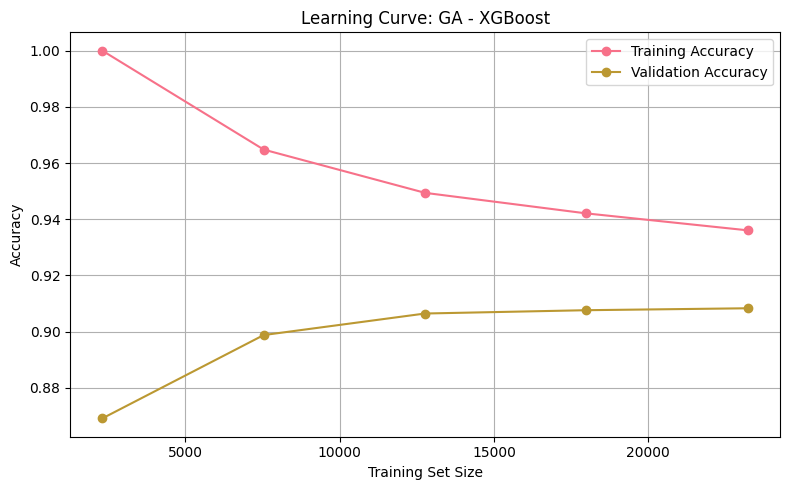

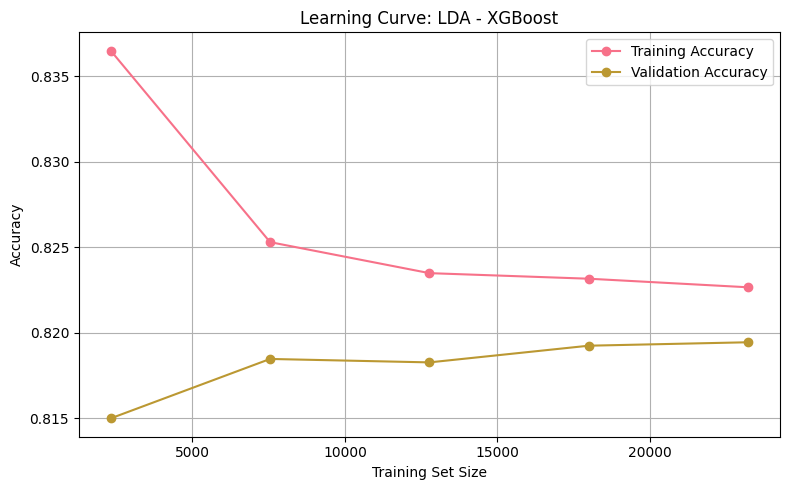

In [ ]:
from sklearn.model_selection import learning_curve

# Learning curve visualization
def plot_learning_curve(model, X, y, title):
    train_sizes, train_scores, val_scores = learning_curve(
        model, X, y, cv=3, scoring='accuracy', n_jobs=-1,
        train_sizes=np.linspace(0.1, 1.0, 5), shuffle=True, random_state=42)

    train_mean = np.mean(train_scores, axis=1)
    val_mean = np.mean(val_scores, axis=1)

    plt.figure(figsize=(8, 5))
    plt.plot(train_sizes, train_mean, 'o-', label='Training Accuracy')
    plt.plot(train_sizes, val_mean, 'o-', label='Validation Accuracy')
    plt.title(title)
    plt.xlabel('Training Set Size')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid()
    plt.tight_layout()
    plt.show()

# Call for best models
for pipeline_name, pipeline_results in all_results.items():
    best_model_name = max(pipeline_results, key=lambda x: pipeline_results[x]['test_accuracy'])
    best_model = pipeline_results[best_model_name]['best_model']
    X_train, _, y_train, _, _, _ = pipelines[pipeline_name]
    plot_learning_curve(best_model, X_train, y_train, f'Learning Curve: {pipeline_name.upper()} - {best_model_name}')


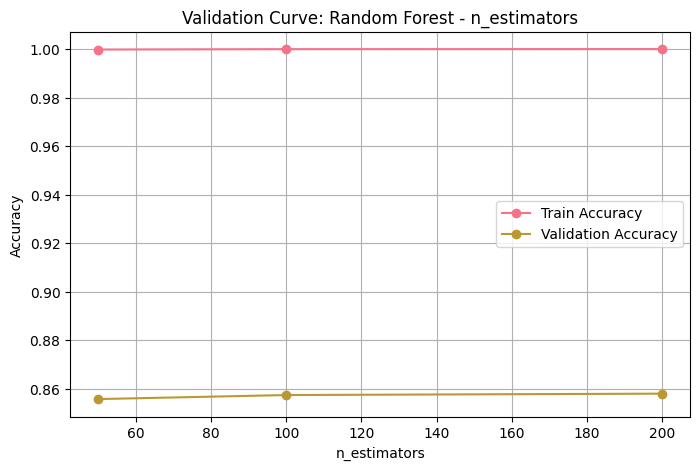

In [ ]:
from sklearn.model_selection import validation_curve

# Example: Validation curve for n_estimators in RandomForest
param_range = [50, 100, 200]
train_scores, val_scores = validation_curve(
    RandomForestClassifier(random_state=42),
    X_train_baseline, y_train,
    param_name='n_estimators',
    param_range=param_range,
    scoring='accuracy', cv=3, n_jobs=-1)

train_mean = np.mean(train_scores, axis=1)
val_mean = np.mean(val_scores, axis=1)

plt.figure(figsize=(8, 5))
plt.plot(param_range, train_mean, label='Train Accuracy', marker='o')
plt.plot(param_range, val_mean, label='Validation Accuracy', marker='o')
plt.title('Validation Curve: Random Forest - n_estimators')
plt.xlabel('n_estimators')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()


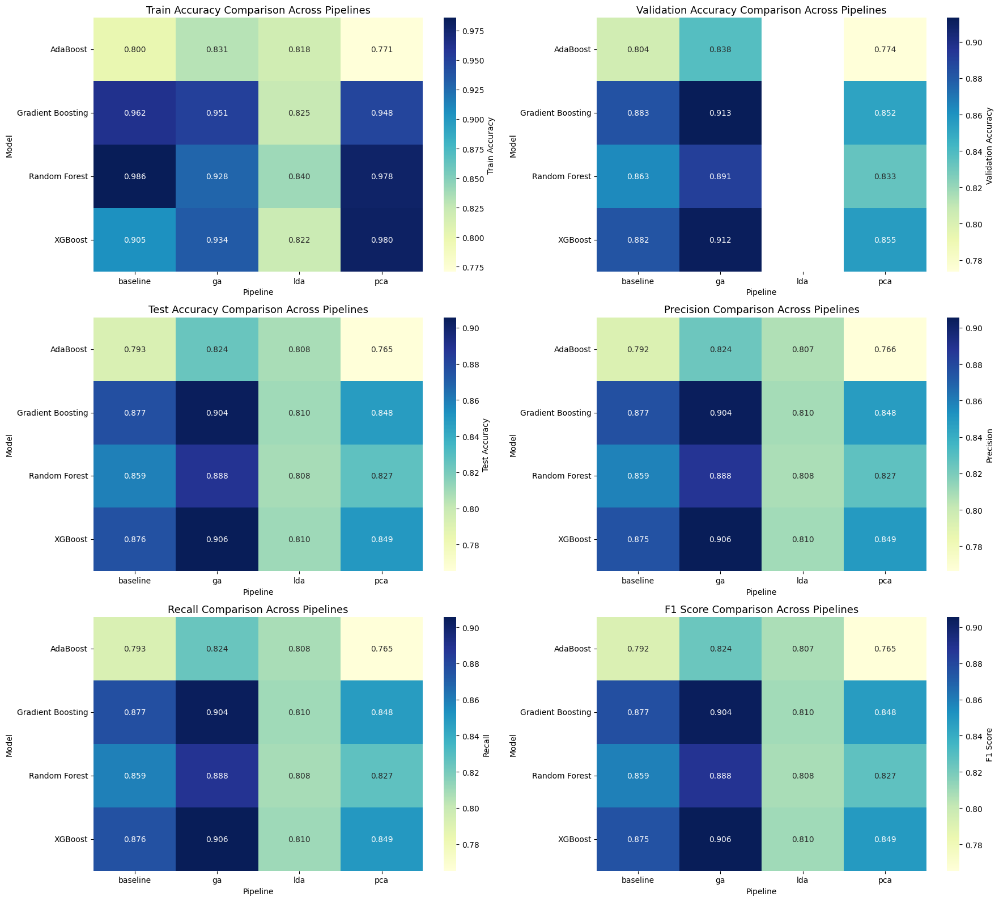

In [ ]:
# Visualization: Performance comparison across pipelines
fig, axes = plt.subplots(3, 2, figsize=(18, 16))

metrics = ['Train Accuracy', 'Validation Accuracy', 'Test Accuracy', 'Precision', 'Recall', 'F1 Score']
colors = ['lightsteelblue', 'mediumorchid', 'skyblue', 'lightcoral', 'lightgreen', 'gold']

for i, (metric, color) in enumerate(zip(metrics, colors)):
    ax = axes[i // 2, i % 2]

    # Create pivot table for heatmap
    pivot_data = comparison_df.pivot(index='Model', columns='Pipeline', values=metric)

    sns.heatmap(pivot_data, annot=True, fmt='.3f', cmap='YlGnBu', ax=ax,
                cbar_kws={'label': metric})
    ax.set_title(f'{metric} Comparison Across Pipelines', fontsize=13)
    ax.set_xlabel('Pipeline')
    ax.set_ylabel('Model')

plt.tight_layout()
plt.show()


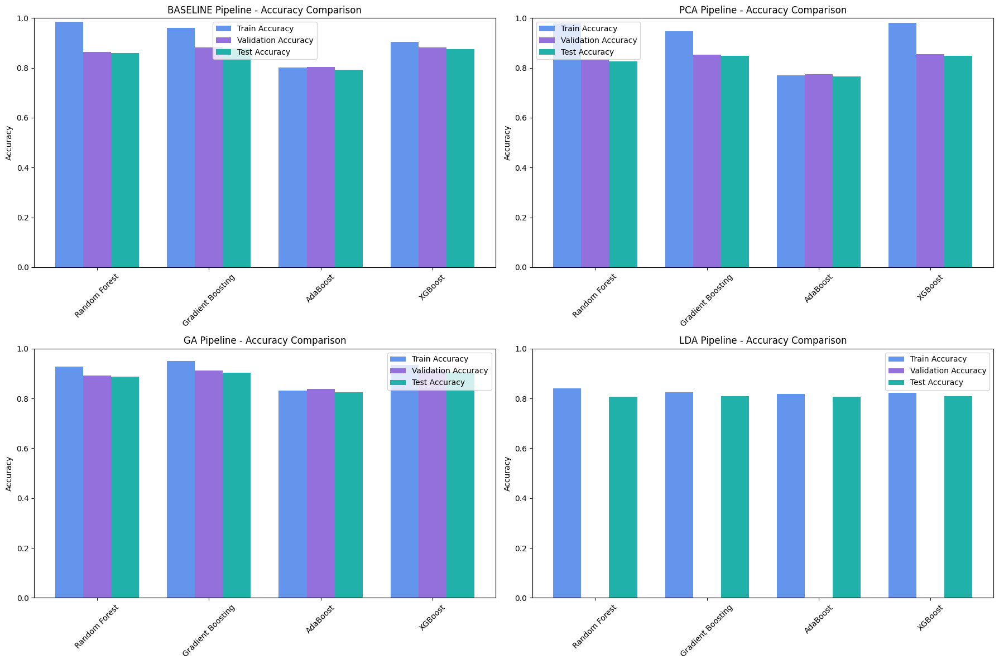

In [ ]:
# Bar plot comparison for best models in each pipeline (Train, Validation, Test Accuracy)
fig, axes = plt.subplots(2, 2, figsize=(18, 12))

bar_width = 0.25
metrics = ['Train Accuracy', 'Validation Accuracy', 'Test Accuracy']
colors = ['cornflowerblue', 'mediumpurple', 'lightseagreen']

for i, pipeline_name in enumerate(pipelines.keys()):
    ax = axes[i//2, i%2]

    pipeline_data = comparison_df[comparison_df['Pipeline'] == pipeline_name]
    models = pipeline_data['Model'].tolist()
    x = np.arange(len(models))

    for j, metric in enumerate(metrics):
        ax.bar(x + j * bar_width, pipeline_data[metric], width=bar_width, label=metric, color=colors[j])

    ax.set_title(f'{pipeline_name.upper()} Pipeline - Accuracy Comparison')
    ax.set_ylabel('Accuracy')
    ax.set_ylim(0, 1)
    ax.set_xticks(x + bar_width)
    ax.set_xticklabels(models, rotation=45)
    ax.legend()

plt.tight_layout()
plt.show()


=== CONFUSION MATRICES FOR BEST MODELS ===


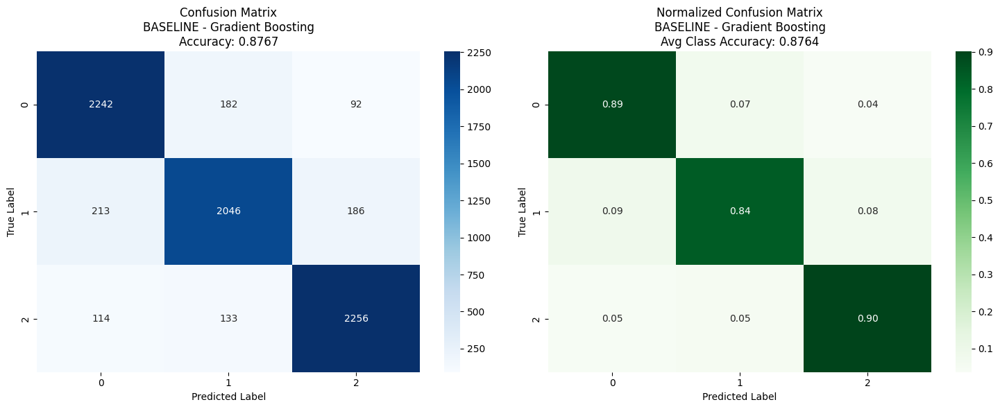

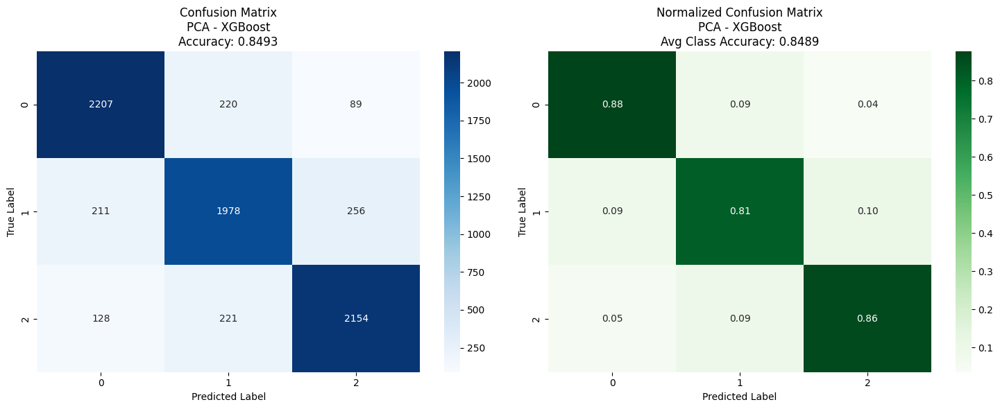

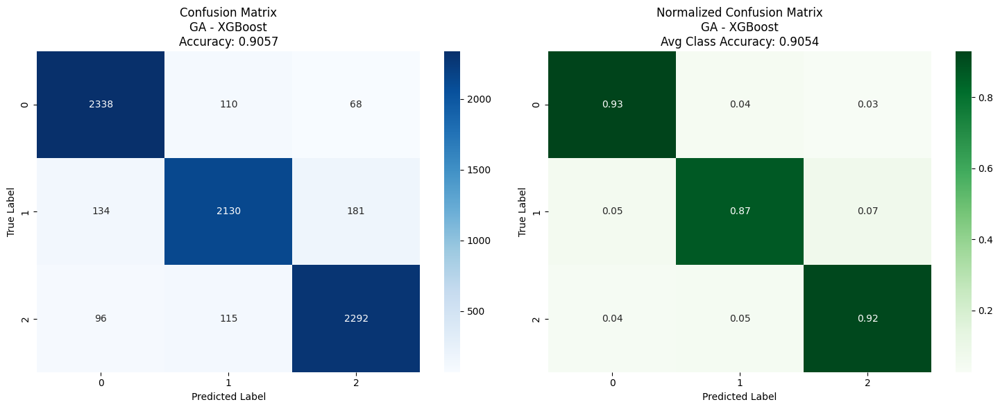

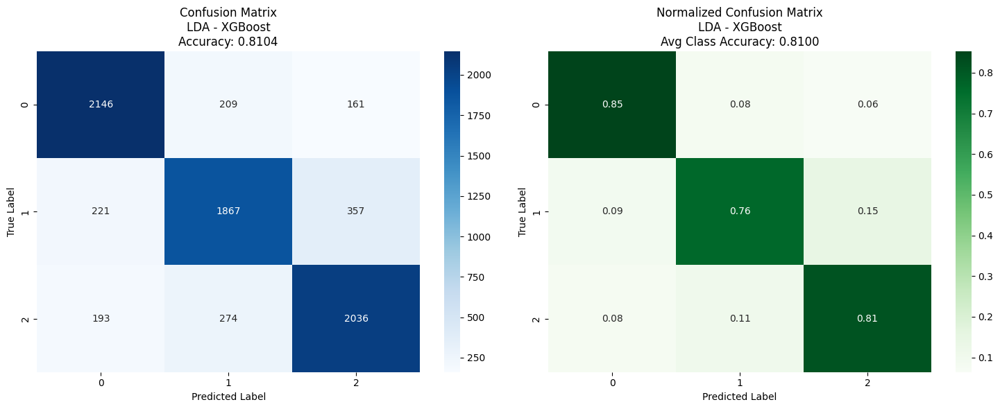

In [ ]:
# Confusion matrices for best models
print("=== CONFUSION MATRICES FOR BEST MODELS ===")

for pipeline_name, pipeline_results in all_results.items():
    # Find best model in this pipeline
    best_model_name = max(pipeline_results.keys(),
                         key=lambda x: pipeline_results[x]['test_accuracy'])
    best_results = pipeline_results[best_model_name]

    cm = best_results['confusion_matrix']

    # Create figure with confusion matrices
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

    # Standard confusion matrix
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=ax1,
                xticklabels=np.unique(y_test),
                yticklabels=np.unique(y_test))
    ax1.set_title(f'Confusion Matrix\n{pipeline_name.upper()} - {best_model_name}\nAccuracy: {best_results["test_accuracy"]:.4f}')
    ax1.set_xlabel('Predicted Label')
    ax1.set_ylabel('True Label')

    # Normalized confusion matrix
    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    sns.heatmap(cm_normalized, annot=True, fmt='.2f', cmap='Greens', ax=ax2,
                xticklabels=np.unique(y_test),
                yticklabels=np.unique(y_test))
    ax2.set_title(f'Normalized Confusion Matrix\n{pipeline_name.upper()} - {best_model_name}\nAvg Class Accuracy: {best_results["avg_accuracy"]:.4f}')
    ax2.set_xlabel('Predicted Label')
    ax2.set_ylabel('True Label')

    plt.tight_layout()
    plt.show()

=== FEATURE IMPORTANCE ANALYSIS ===

--- BASELINE Pipeline ---


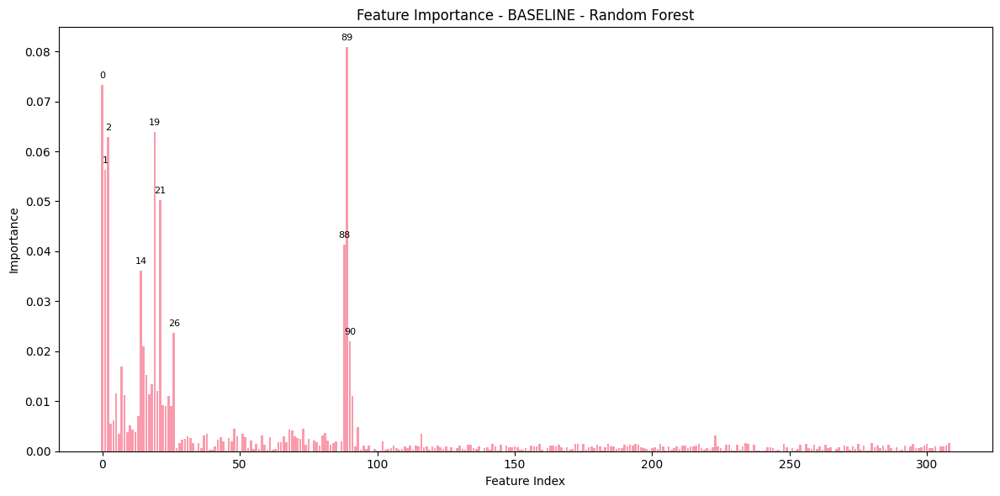

Random Forest: Top 5 features - [ 1  2 19  0 89]


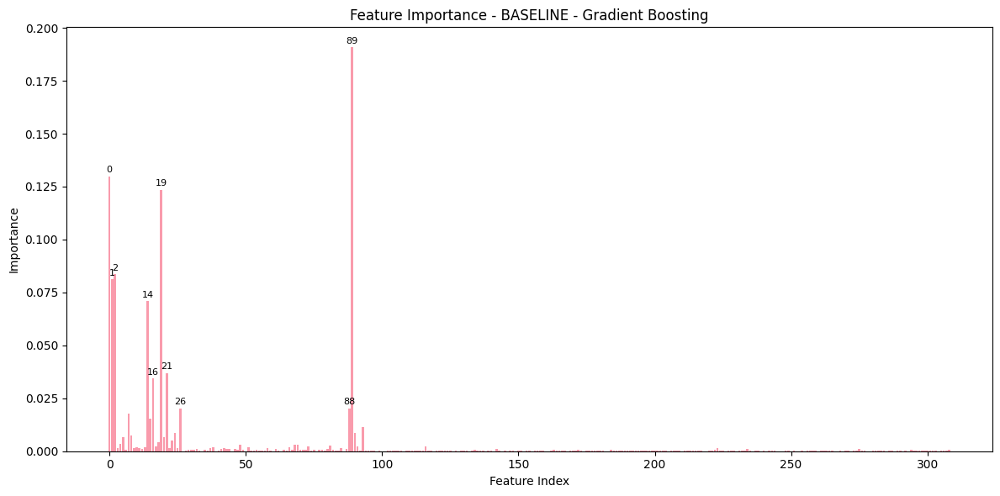

Gradient Boosting: Top 5 features - [ 1  2 19  0 89]


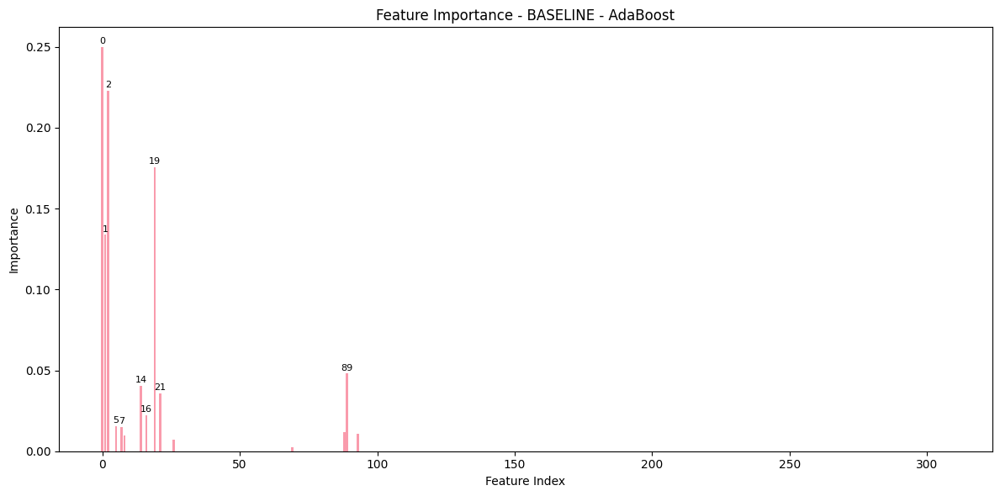

AdaBoost: Top 5 features - [89  1 19  2  0]


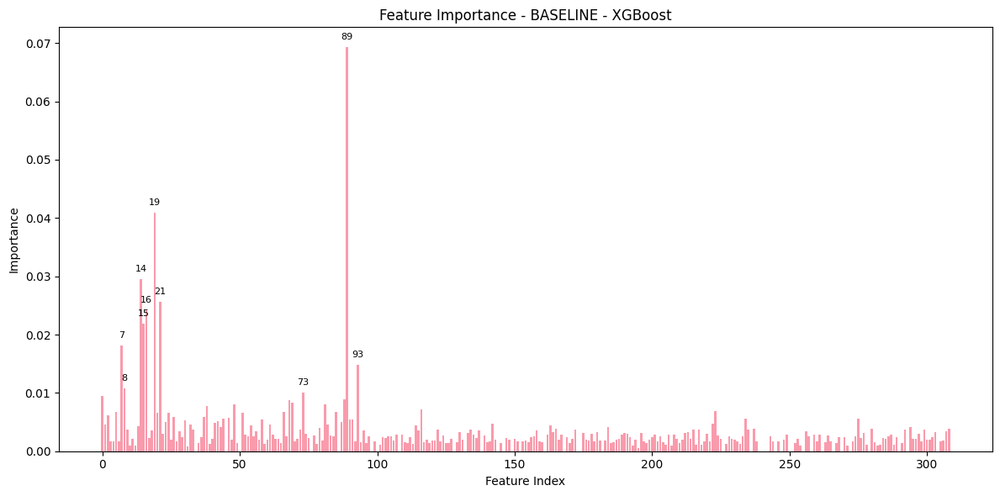

XGBoost: Top 5 features - [16 21 14 19 89]

--- PCA Pipeline ---


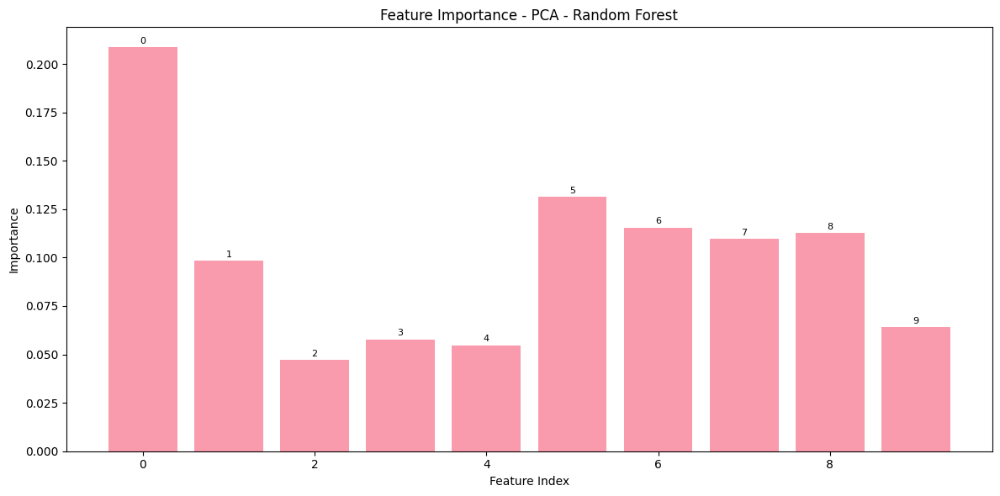

Random Forest: Top 5 features - [7 8 6 5 0]


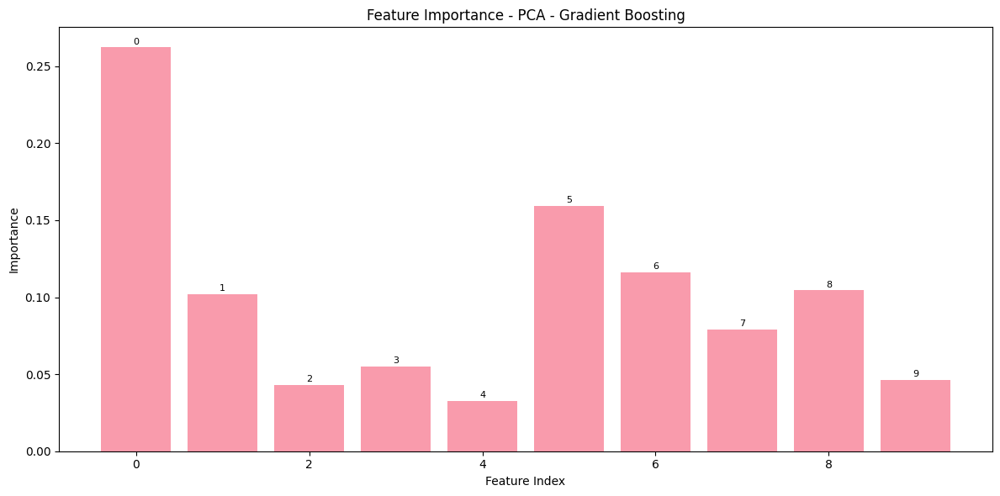

Gradient Boosting: Top 5 features - [1 8 6 5 0]


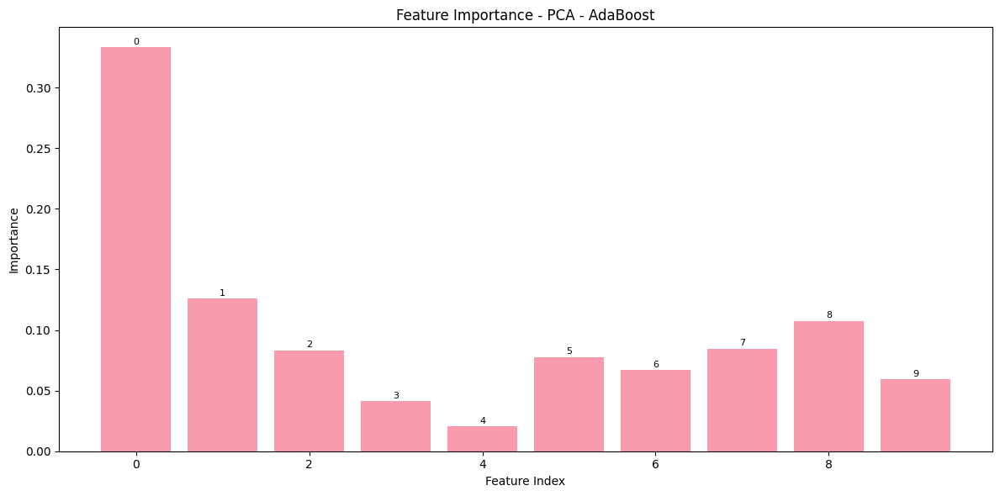

AdaBoost: Top 5 features - [2 7 8 1 0]


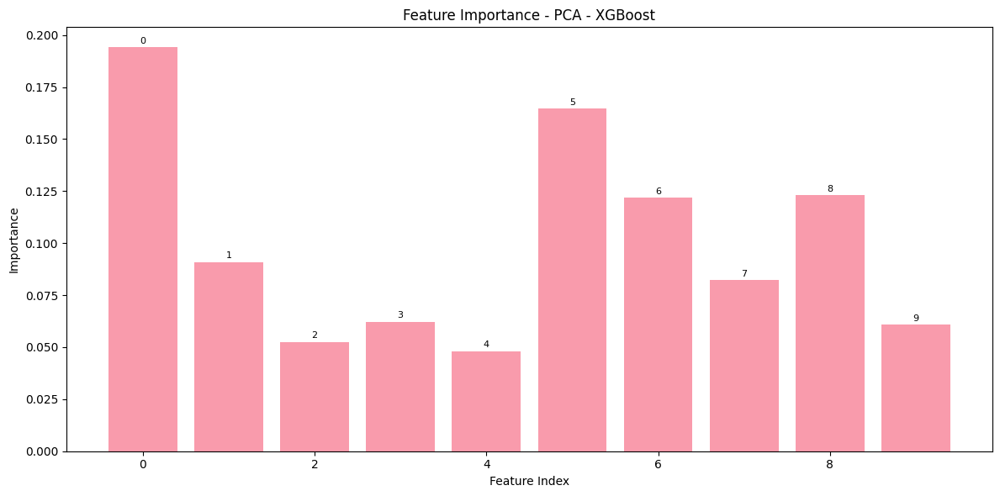

XGBoost: Top 5 features - [1 6 8 5 0]

--- GA Pipeline ---


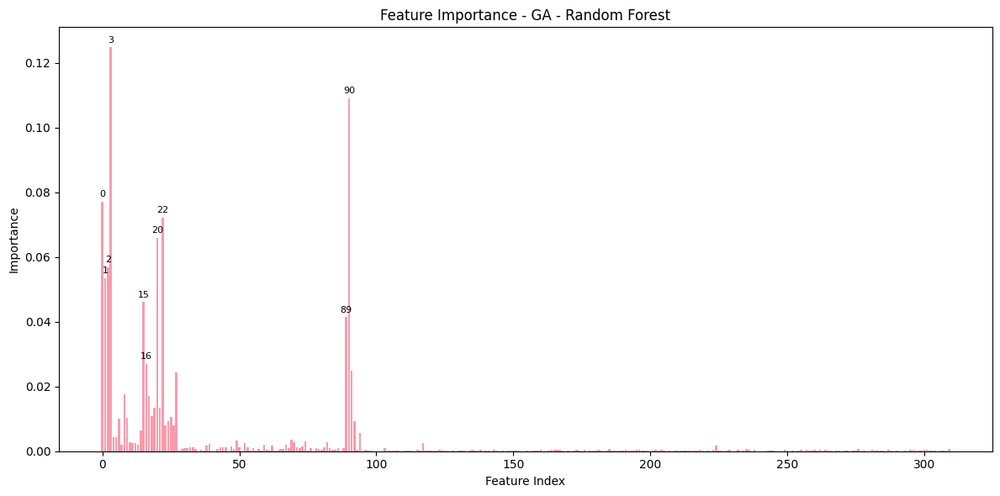

Random Forest: Top 5 features - [20 22  0 90  3]


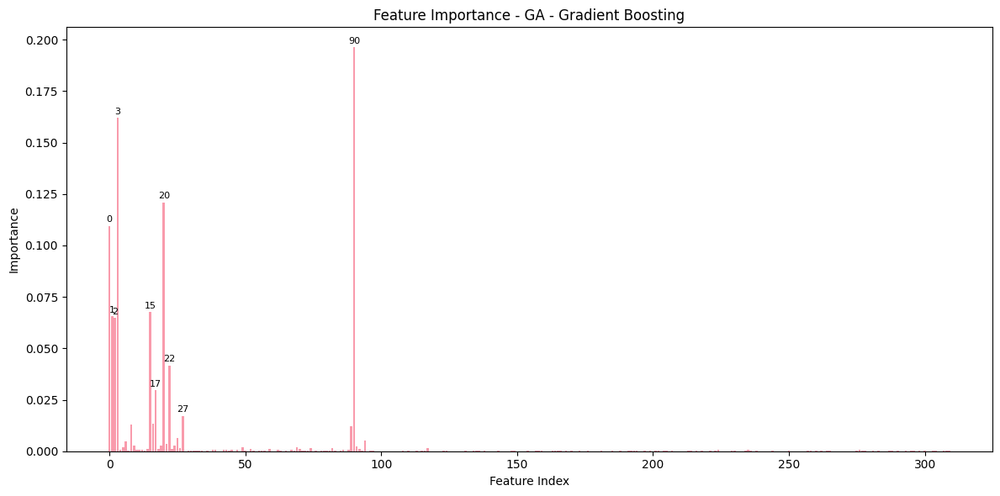

Gradient Boosting: Top 5 features - [15  0 20  3 90]


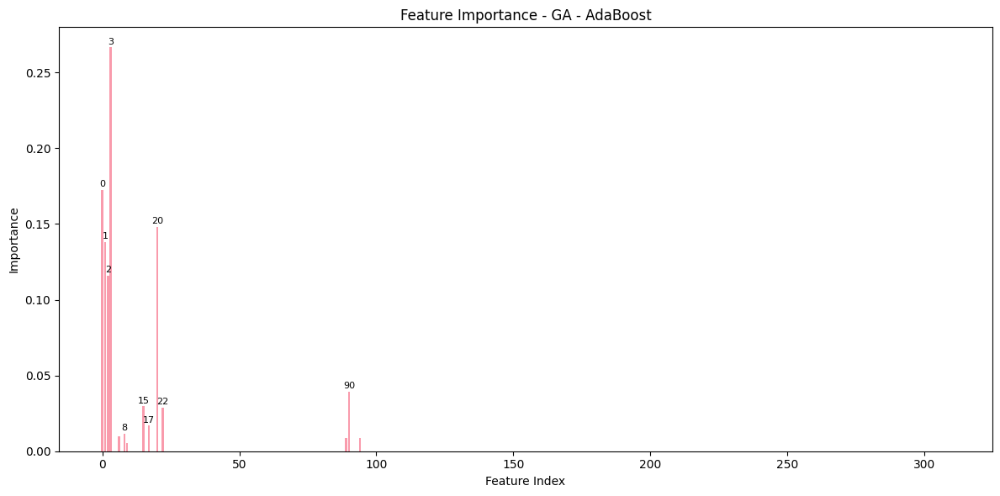

AdaBoost: Top 5 features - [ 2  1 20  0  3]


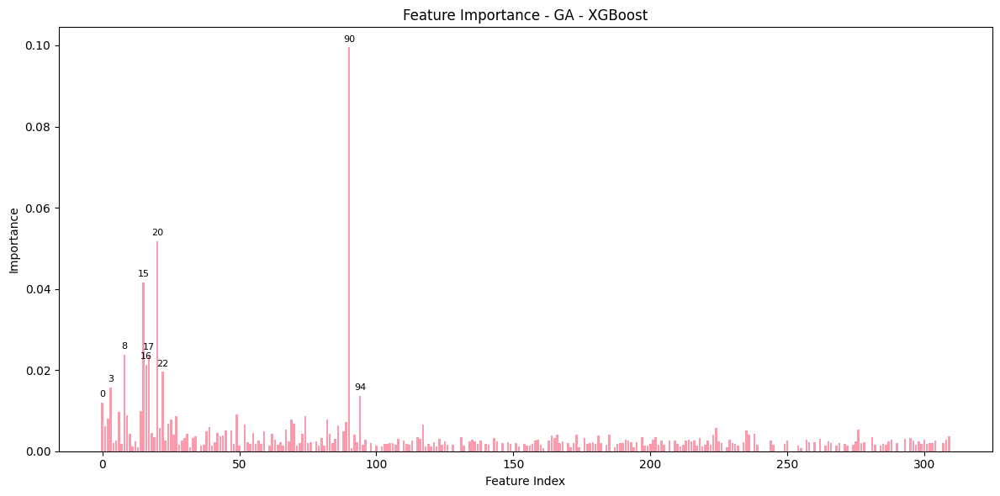

XGBoost: Top 5 features - [17  8 15 20 90]

--- LDA Pipeline ---


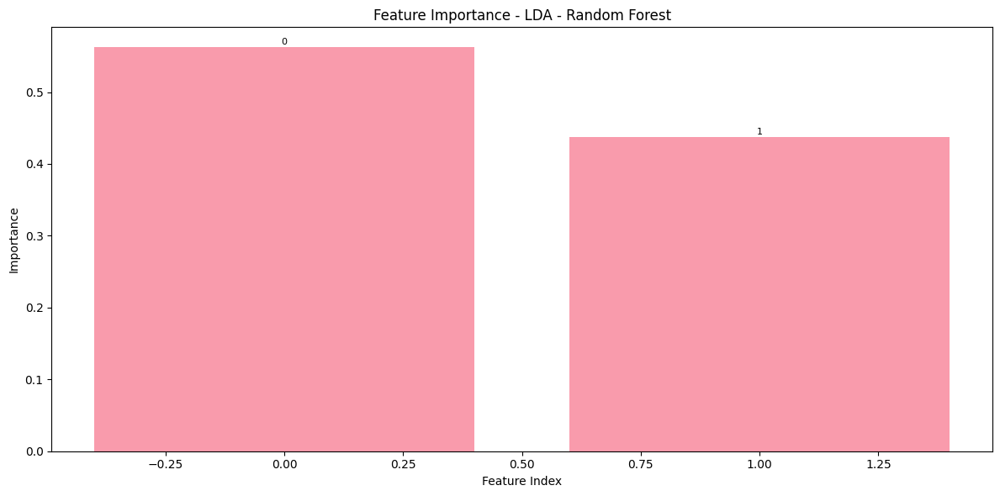

Random Forest: Top 5 features - [1 0]


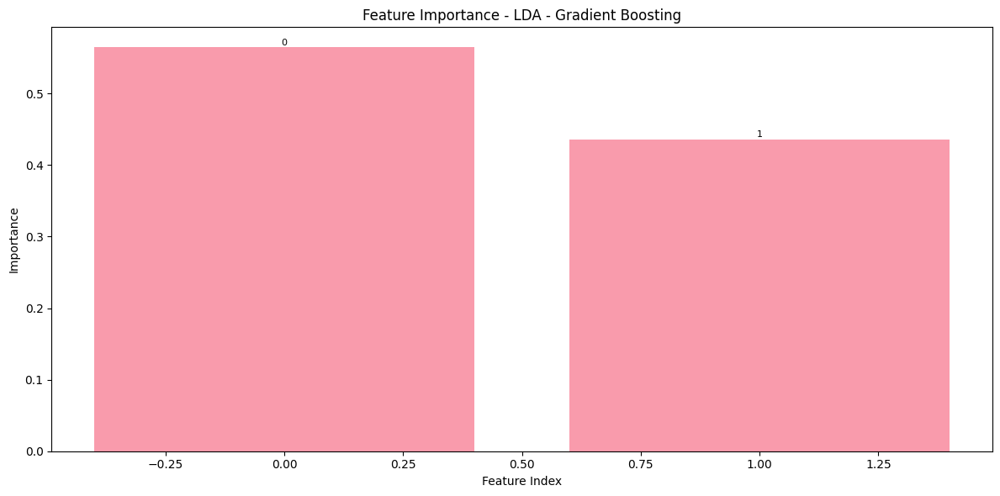

Gradient Boosting: Top 5 features - [1 0]


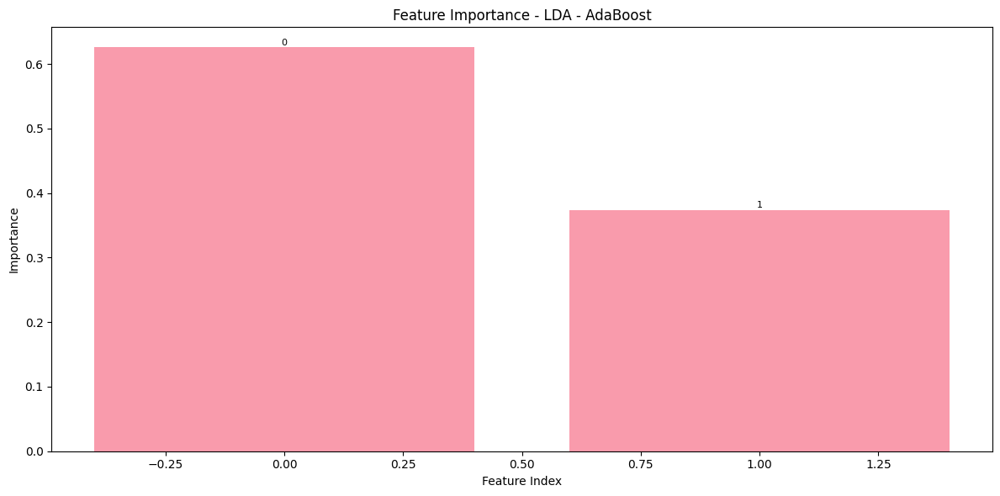

AdaBoost: Top 5 features - [1 0]


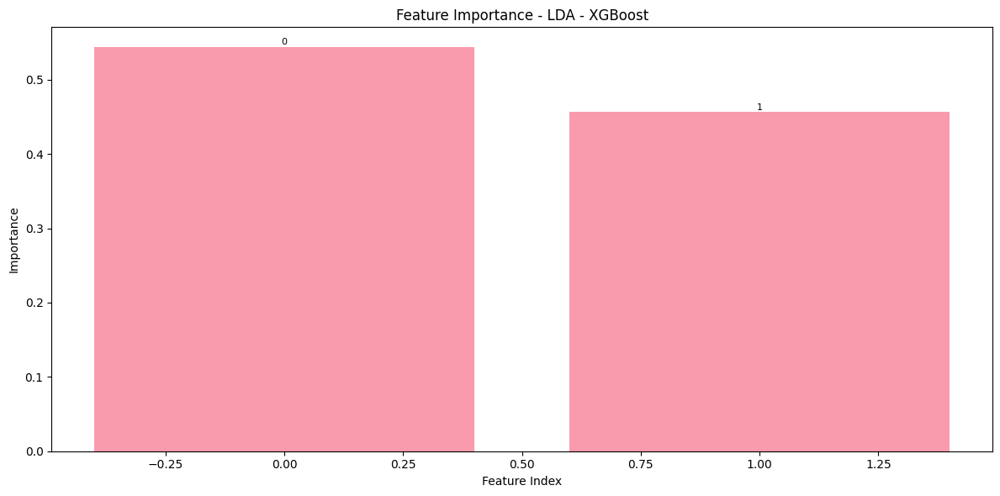

XGBoost: Top 5 features - [1 0]


In [ ]:
# Feature importance analysis for tree-based models
print("=== FEATURE IMPORTANCE ANALYSIS ===")

for pipeline_name, pipeline_results in all_results.items():
    print(f"\n--- {pipeline_name.upper()} Pipeline ---")

    for model_name, results in pipeline_results.items():
        model = results['best_model']

        # Check if model has feature_importances_ attribute
        if hasattr(model, 'feature_importances_'):
            importances = model.feature_importances_

            # Create feature importance plot
            plt.figure(figsize=(12, 6))
            feature_indices = np.arange(len(importances))

            plt.bar(feature_indices, importances, alpha=0.7)
            plt.title(f'Feature Importance - {pipeline_name.upper()} - {model_name}')
            plt.xlabel('Feature Index')
            plt.ylabel('Importance')

            # Show top 10 most important features
            top_features = np.argsort(importances)[-10:]
            for i, idx in enumerate(top_features):
                plt.text(idx, importances[idx] + 0.001, f'{idx}',
                        ha='center', va='bottom', fontsize=8)

            plt.tight_layout()
            plt.show()

            print(f"{model_name}: Top 5 features - {top_features[-5:]}")

In [ ]:
# Performance summary table
print("=== FINAL PERFORMANCE SUMMARY ===")

summary_stats = comparison_df.groupby('Pipeline').agg({
    'Train Accuracy': ['mean', 'max', 'std'],
    'Validation Accuracy': ['mean', 'max', 'std'],
    'Test Accuracy': ['mean', 'max', 'std'],
    'F1 Score': ['mean', 'max', 'std'],
    'Training Time (s)': ['mean', 'sum']
}).round(4)

# Improve readability by flattening column MultiIndex
summary_stats.columns = ['_'.join(col).strip() for col in summary_stats.columns.values]

print(summary_stats)


=== FINAL PERFORMANCE SUMMARY ===
          Train Accuracy_mean  Train Accuracy_max  Train Accuracy_std  \
Pipeline                                                                
baseline               0.9131              0.9857              0.0824   
ga                     0.9111              0.9506              0.0541   
lda                    0.8262              0.8401              0.0096   
pca                    0.9194              0.9803              0.1001   

          Validation Accuracy_mean  Validation Accuracy_max  \
Pipeline                                                      
baseline                    0.8582                   0.8831   
ga                          0.8885                   0.9132   
lda                            NaN                      NaN   
pca                         0.8287                   0.8555   

          Validation Accuracy_std  Test Accuracy_mean  Test Accuracy_max  \
Pipeline                                                                

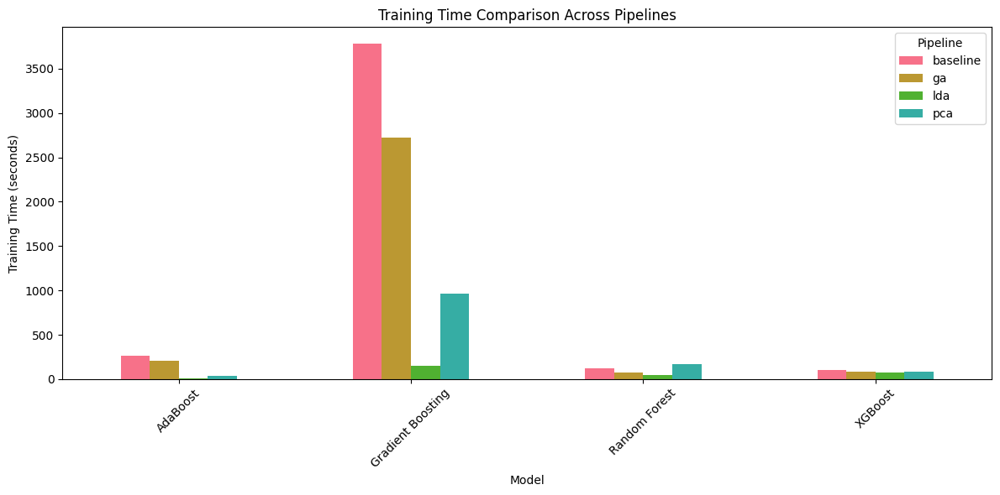


✅ Analysis complete! Best overall combination: GA + XGBoost


In [ ]:
# Training time comparison
plt.figure(figsize=(12, 6))
training_times = comparison_df.pivot(index='Model', columns='Pipeline', values='Training Time (s)')
training_times.plot(kind='bar', ax=plt.gca())
plt.title('Training Time Comparison Across Pipelines')
plt.ylabel('Training Time (seconds)')
plt.xlabel('Model')
plt.legend(title='Pipeline')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

print(f"\n✅ Analysis complete! Best overall combination: {best_result['Pipeline'].upper()} + {best_result['Model']}")

In [ ]:
# Optional: Save results to files
comparison_df.to_csv('ensemble_models_comparison.csv', index=False)
summary_stats.to_csv('ensemble_models_summary.csv')

# Save best parameters and extended metrics for each combination
best_params_data = []
for pipeline_name, pipeline_results in all_results.items():
    for model_name, results in pipeline_results.items():
        best_params_data.append({
            'Pipeline': pipeline_name,
            'Model': model_name,
            'Best_Parameters': str(results['best_params']),
            'Train_Accuracy': results['train_accuracy'],
            'Validation_Accuracy': results['val_accuracy'],
            'Test_Accuracy': results['test_accuracy'],
        })

# Convert to DataFrame and save
pd.DataFrame(best_params_data).to_csv('best_hyperparameters_detailed.csv', index=False)
print("✅ All results exported to CSV files successfully.")


✅ All results exported to CSV files successfully.


In [ ]:
import joblib
import os

# Create a directory to save models if it doesn't exist
os.makedirs('saved_models', exist_ok=True)

# Find the best model based on Test Accuracy
best_pipeline_name = None
best_model_name = None
best_model = None
best_accuracy = -1

for pipeline_name, pipeline_results in all_results.items():
    for model_name, results in pipeline_results.items():
        if results['test_accuracy'] > best_accuracy:
            best_accuracy = results['test_accuracy']
            best_pipeline_name = pipeline_name
            best_model_name = model_name
            best_model = results['best_model']

# Define filename
model_filename = f"saved_models/best_model_{best_pipeline_name}_{best_model_name}.pkl"

# Save the model using joblib
joblib.dump(best_model, model_filename)

print(f"✅ Best model saved: {model_filename}")


✅ Best model saved: saved_models/best_model_ga_XGBoost.pkl


In [ ]:
import joblib
import os

# Create directory if it doesn't exist
os.makedirs('saved_models', exist_ok=True)

# Specify target pipeline and model
target_pipeline = 'ga'
target_model = 'Gradient Boosting'

# Get the model
best_model = all_results[target_pipeline][target_model]['best_model']

# Define filename
model_filename = f"saved_models/{target_model.replace(' ', '_')}_{target_pipeline}.pkl"

# Save the model
joblib.dump(best_model, model_filename)

print(f"✅ {target_model} model from {target_pipeline.upper()} pipeline saved as: {model_filename}")

✅ Gradient Boosting model from GA pipeline saved as: saved_models/Gradient_Boosting_ga.pkl


In [ ]:
import time
import os
import joblib
import numpy as np
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, f1_score
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint, uniform

def calculate_metrics(y_true, y_pred):
    """Calculate all metrics at once to avoid redundant computations."""
    cm = confusion_matrix(y_true, y_pred)
    return {
        'accuracy': accuracy_score(y_true, y_pred),
        'precision': precision_score(y_true, y_pred, average='weighted'),
        'recall': recall_score(y_true, y_pred, average='weighted'),
        'f1_score': f1_score(y_true, y_pred, average='weighted'),
        'confusion_matrix': cm,
        'avg_accuracy': np.mean(cm.diagonal() / cm.sum(axis=1))
    }

def get_param_grid():
    """Define hyperparameter search space for GradientBoostingClassifier."""
    return {
        'n_estimators': randint(50, 150),
        'max_depth': randint(3, 6),
        'min_samples_leaf': randint(10, 50),
        'learning_rate': uniform(0.01, 0.15),
        'max_features': ['sqrt', 'log2', None],
        'subsample': uniform(0.7, 0.3),
        'random_state': [42]
    }

def train_and_evaluate_model(X_train, X_val, y_train, y_val, X_test, y_test, pipeline_name, save_dir):
    """Train model with hyperparameter tuning to reduce overfitting."""
    print(f"\n=== Pipeline: {pipeline_name.upper()} ===")
    print(" Starting hyperparameter tuning...")

    start_time = time.time()

    # Base model with default settings
    base_model = GradientBoostingClassifier(random_state=42)

    # Hyperparameter search
    param_grid = get_param_grid()

    # Use RandomizedSearchCV for efficiency
    random_search = RandomizedSearchCV(
        estimator=base_model,
        param_distributions=param_grid,
        n_iter=30,
        cv=5,
        scoring='f1_weighted',
        n_jobs=-1,
        random_state=42,
        verbose=1
    )

    # Combine train and validation for hyperparameter search
    if X_val is not None:
        X_search = np.vstack([X_train, X_val])
        y_search = np.hstack([y_train, y_val])
    else:
        X_search, y_search = X_train, y_train

    print(f" Searching through {len(param_grid)} hyperparameters with {random_search.n_iter} iterations...")
    random_search.fit(X_search, y_search)

    # Get best model
    best_model = random_search.best_estimator_
    best_params = random_search.best_params_
    best_cv_score = random_search.best_score_

    print(f" Best CV F1 Score: {best_cv_score:.4f}")
    print(f" Best Parameters: {best_params}")

    # Retrain on original train split to get final metrics
    final_model = GradientBoostingClassifier(**best_params)
    final_model.fit(X_train, y_train)

    # Predictions
    y_train_pred = final_model.predict(X_train)
    y_val_pred = final_model.predict(X_val) if X_val is not None else None
    y_test_pred = final_model.predict(X_test)

    # Calculate metrics
    train_metrics = calculate_metrics(y_train, y_train_pred)
    val_metrics = calculate_metrics(y_val, y_val_pred) if y_val is not None else None
    test_metrics = calculate_metrics(y_test, y_test_pred)

    training_time = time.time() - start_time

    # Overfitting metrics
    train_test_gap = train_metrics['accuracy'] - test_metrics['accuracy']
    val_test_gap = (val_metrics['accuracy'] - test_metrics['accuracy']) if val_metrics else None

    # Results dictionary
    results = {
        'best_params': best_params,
        'cv_score': best_cv_score,
        'train_accuracy': train_metrics['accuracy'],
        'val_accuracy': val_metrics['accuracy'] if val_metrics else None,
        'test_accuracy': test_metrics['accuracy'],
        'avg_accuracy': test_metrics['avg_accuracy'],
        'precision': test_metrics['precision'],
        'recall': test_metrics['recall'],
        'f1_score': test_metrics['f1_score'],
        'confusion_matrix': test_metrics['confusion_matrix'],
        'training_time': training_time,
        'overfitting_gap': train_test_gap,
        'val_test_gap': val_test_gap,
        'best_model': final_model
    }

    # Save model and results
    model_filename = f"{pipeline_name}GradientBoosting_tuned_model.pkl"
    results_filename = f"{pipeline_name}GradientBoosting_tuned_results.pkl"

    model_path = os.path.join(save_dir, model_filename)
    results_path = os.path.join(save_dir, results_filename)

    joblib.dump(final_model, model_path)
    joblib.dump({k: v for k, v in results.items() if k != 'best_model'}, results_path)

    results.update({'model_path': model_path, 'results_path': results_path})

    # Print summary
    print(f"\n === TRAINING RESULTS ===")
    print(f" Train Accuracy: {results['train_accuracy']:.4f}")
    if results['val_accuracy']:
        print(f" Validation Accuracy: {results['val_accuracy']:.4f}")
    print(f" Test Accuracy: {results['test_accuracy']:.4f}")
    print(f" Precision: {results['precision']:.4f}")
    print(f" Recall: {results['recall']:.4f}")
    print(f" F1 Score: {results['f1_score']:.4f}")
    print(f" Training Time: {training_time:.2f}s")

    return results


# === MAIN EXECUTION ===

save_dir = "/PCA-Models"
os.makedirs(save_dir, exist_ok=True)


# Run training
pipeline_results = train_and_evaluate_model(
    X_train_pca, X_val_pca, y_train, y_val, X_test_pca, y_test,
    'pca', save_dir
)

# Organize results
all_results = {'pca': {'Gradient Boosting (Tuned)': pipeline_results}}

# Save all results
complete_results_path = os.path.join(save_dir, "all_results_complete_tuned.pkl")
joblib.dump(all_results, complete_results_path)

# Prepare and save summary report
summary_report = [{
    'pipeline': 'pca',
    'model': 'Gradient Boosting (Tuned)',
    'test_accuracy': pipeline_results['test_accuracy'],
    'f1_score': pipeline_results['f1_score'],
    'training_time': pipeline_results['training_time'],
    'overfitting_gap': pipeline_results['overfitting_gap'],
    'cv_score': pipeline_results['cv_score'],
    'model_path': pipeline_results['model_path']
}]

summary_path = os.path.join(save_dir, "model_summary_tuned.pkl")
joblib.dump(summary_report, summary_path)

print(f"\n FINAL SUMMARY:")
print(f" Test Accuracy: {pipeline_results['test_accuracy']:.4f}")
print(f" F1 Score: {pipeline_results['f1_score']:.4f}")
print(f" Overfitting Gap: {pipeline_results['overfitting_gap']:.4f}")
print(f" CV Score: {pipeline_results['cv_score']:.4f}")



=== Pipeline: PCA ===
 Starting hyperparameter tuning...
 Searching through 11 hyperparameters with 30 iterations...
Fitting 5 folds for each of 30 candidates, totalling 150 fits
 Best CV F1 Score: 0.8831
 Best Parameters: {'learning_rate': 0.13875382072205797, 'max_depth': 5, 'min_samples_leaf': 35, 'max_leaf_nodes': 38, 'n_estimators': 85, 'random_state': 42}

=== TRAINING RESULTS ===
 Train Accuracy: 0.9299
 Validation Accuracy: 0.8830
 Test Accuracy: 0.8817
 Precision: 0.8817
 Recall: 0.8817
 F1 Score: 0.8817
 Training Time: 2189.21s

FINAL SUMMARY:
 Test Accuracy: 0.8817
 F1 Score: 0.8817
 Overfitting Gap: 0.0481
 CV Score: 0.8831


              precision    recall  f1-score   support

           0       0.85      0.83      0.84      2516
           1       0.82      0.81      0.81      2482
           2       0.83      0.86      0.85      2502

    accuracy                           0.83      7500
   macro avg       0.83      0.83      0.83      7500
weighted avg       0.83      0.83      0.83      7500

Confusion Matrix:
[[2078  224  214]
 [ 242 2014  226]
 [ 115  225 2162]]


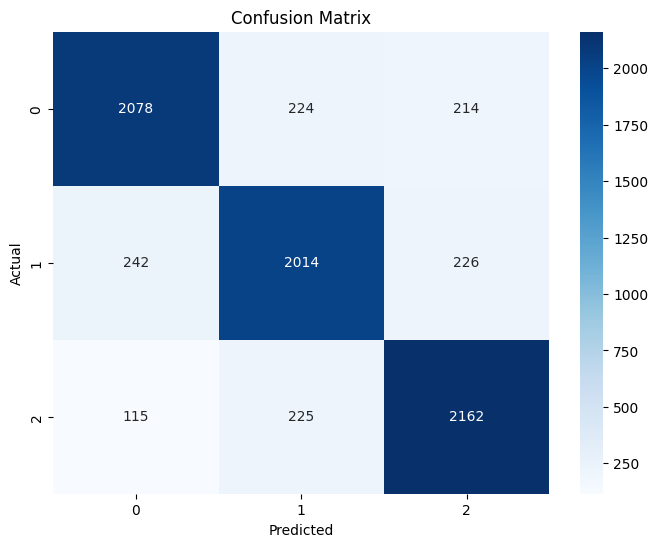

In [ ]:
import joblib
from sklearn.metrics import confusion_matrix, classification_report
import matplotlib.pyplot as plt
import seaborn as sns

# Load the model
model_path = "/content/drive/MyDrive/Task (2) - Machine Learning/PCA-Models/pcaGradientBoosting_tuned_model.pkl"
loaded_model = joblib.load(model_path)

# Predict
y_pred = loaded_model.predict(X_test_pca)

# Report
print(classification_report(y_test, y_pred))

# Load saved results (if this file contains y_test and y_pred, adjust accordingly)
result_path = "/content/drive/MyDrive/Task (2) - Machine Learning/PCA-Models/pcaGradientBoosting_tuned_results.pkl"
results = joblib.load(result_path)

cm = confusion_matrix(y_test, y_pred)

# Display confusion matrix content
print("Confusion Matrix:")
print(cm)

#Visualize the confusion matrix
plt.figure(figsize=(8,6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


### Best performing model

In [ ]:
# Define pipelines
import time
import os
import joblib
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, f1_score
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
import numpy as np
from sklearn.ensemble import GradientBoostingClassifier

pipelines = {
    'ga': (X_train_ga_full, X_val_ga_full, y_train, y_val, X_test_ga_full, y_test),
}
# Define models and their hyperparameter grids
models_config = {
    'Gradient Boosting': {
        'model': GradientBoostingClassifier(random_state=42),
        'params': {
            'n_estimators': [50, 100, 200],
            'learning_rate': [0.01, 0.1, 0.2],
            'max_depth': [3, 5, 7],
            'min_samples_split': [2, 5, 10],
            'min_samples_leaf': [1, 2, 4]
        }
    }
}

print("✅ Pipelines and model configurations defined")
print(f"📊 Pipelines: {list(pipelines.keys())}")
print(f"🤖 Models: {list(models_config.keys())}")
print(X_val_baseline.shape)

# Store all results
all_results = {}

print("=== Enhanced Ensemble Models with Hyperparameter Tuning (GA Pipeline Only) ===\n")

# Only process the GA pipeline
pipeline_name = 'ga'
(X_train, X_val, y_train, y_val, X_test, y_test) = pipelines[pipeline_name]

print(f"--- Pipeline: {pipeline_name.upper()} ---")
print("=" * 60)

pipeline_results = {}

for model_name, config in models_config.items():
    print(f"\n--- {model_name} on {pipeline_name.upper()} ---")

    start_time = time.time()

    # Use RandomizedSearchCV for faster hyperparameter tuning
    n_iter = 20 if model_name in ['XGBoost', 'Gradient Boosting'] else 30

    random_search = RandomizedSearchCV(
        estimator=config['model'],
        param_distributions=config['params'],
        n_iter=n_iter,
        cv=3,
        scoring='accuracy',
        n_jobs=-1,
        random_state=42,
        verbose=0
    )

    # Fit the random search
    print("🔍 Performing hyperparameter tuning...")
    random_search.fit(X_train, y_train)

    # Get the best model
    best_model = random_search.best_estimator_
    best_params = random_search.best_params_
    best_cv_score = random_search.best_score_

    # Make predictions
    y_train_pred = best_model.predict(X_train)
    y_val_pred = best_model.predict(X_val) if X_val is not None else None
    y_test_pred = best_model.predict(X_test)

    # Calculate metrics
    train_acc = accuracy_score(y_train, y_train_pred)
    val_acc = accuracy_score(y_val, y_val_pred) if y_val is not None else None
    test_acc = accuracy_score(y_test, y_test_pred)

    cm = confusion_matrix(y_test, y_test_pred)
    precision = precision_score(y_test, y_test_pred, average='weighted')
    recall = recall_score(y_test, y_test_pred, average='weighted')
    f1 = f1_score(y_test, y_test_pred, average='weighted')

    # Per-class accuracy
    class_accuracy = cm.diagonal() / cm.sum(axis=1)
    avg_accuracy = np.mean(class_accuracy)

    training_time = time.time() - start_time

    # Store results
    pipeline_results[model_name] = {
        'best_params': best_params,
        'cv_score': best_cv_score,
        'train_accuracy': train_acc,
        'val_accuracy': val_acc,
        'test_accuracy': test_acc,
        'avg_accuracy': avg_accuracy,
        'precision': precision,
        'recall': recall,
        'f1_score': f1,
        'confusion_matrix': cm,
        'training_time': training_time,
        'best_model': best_model
    }

    # Print results
    print(f"✅ Best CV Score: {best_cv_score:.4f}")
    print(f"🏋 Train Accuracy: {train_acc:.4f}")
    if val_acc is not None:
        print(f"🔍 Validation Accuracy: {val_acc:.4f}")
    print(f"📊 Test Accuracy: {test_acc:.4f}")
    print(f"📈 Precision: {precision:.4f}")
    print(f"🎯 Recall: {recall:.4f}")
    print(f"⚖ F1 Score: {f1:.4f}")
    print(f"⏱ Training Time: {training_time:.2f}s")
    print(f"🔧 Best Parameters: {best_params}")

all_results[pipeline_name] = pipeline_results
print(f"\n✅ Completed pipeline: {pipeline_name.upper()}")
print("=" * 60)

print("\n🎉 GA pipeline models trained successfully!")
# Save results to JSON (without model objects)
import json
results_to_save = {}
for pipeline, models in all_results.items():
    results_to_save[pipeline] = {}
    for model_name, results in models.items():
        # Exclude non-serializable items like model objects and numpy arrays
        results_to_save[pipeline][model_name] = {
            'best_params': results['best_params'],
            'cv_score': results['cv_score'],
            'train_accuracy': results['train_accuracy'],
            'val_accuracy': results['val_accuracy'],
            'test_accuracy': results['test_accuracy'],
            'precision': results['precision'],
            'recall': results['recall'],
            'f1_score': results['f1_score'],
            'training_time': results['training_time']
        }

with open('model_results.json', 'w') as f:
    json.dump(results_to_save, f, indent=2)

# Save trained models using joblib
import joblib
for model_name, results in pipeline_results.items():
    joblib.dump(results['best_model'], f'{model_name}_baseline_model_Test.pkl')

✅ Pipelines and model configurations defined
📊 Pipelines: ['ga']
🤖 Models: ['Gradient Boosting']
(7502, 310)
=== Enhanced Ensemble Models with Hyperparameter Tuning (GA Pipeline Only) ===

--- Pipeline: GA ---

--- Gradient Boosting on GA ---
🔍 Performing hyperparameter tuning...
✅ Best CV Score: 0.9081
🏋 Train Accuracy: 0.9455
🔍 Validation Accuracy: 0.9106
📊 Test Accuracy: 0.9081
📈 Precision: 0.9081
🎯 Recall: 0.9081
⚖ F1 Score: 0.9081
⏱ Training Time: 3775.81s
🔧 Best Parameters: {'n_estimators': 200, 'min_samples_split': 10, 'min_samples_leaf': 4, 'max_depth': 5, 'learning_rate': 0.2}

✅ Completed pipeline: GA

🎉 GA pipeline models trained successfully!



=== CONFUSION MATRIX VISUALIZATION ===


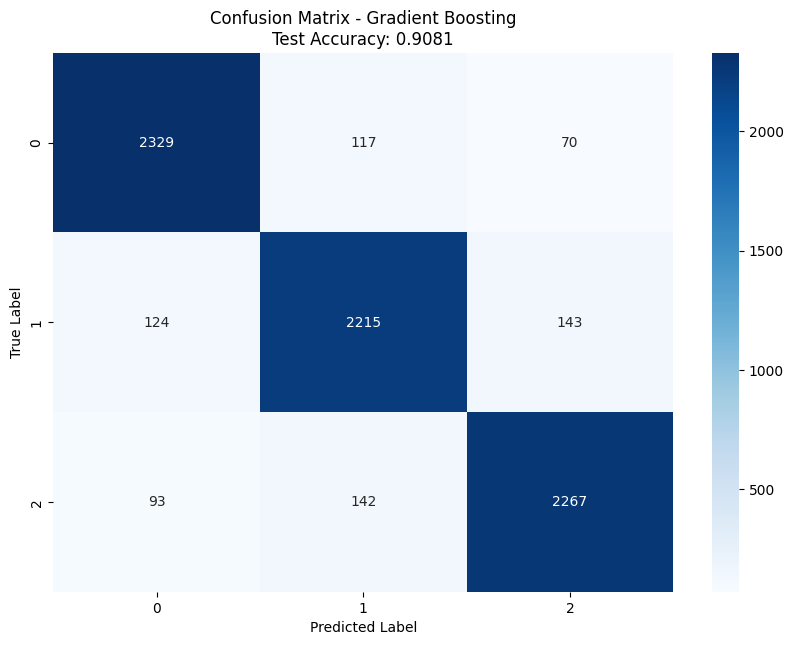

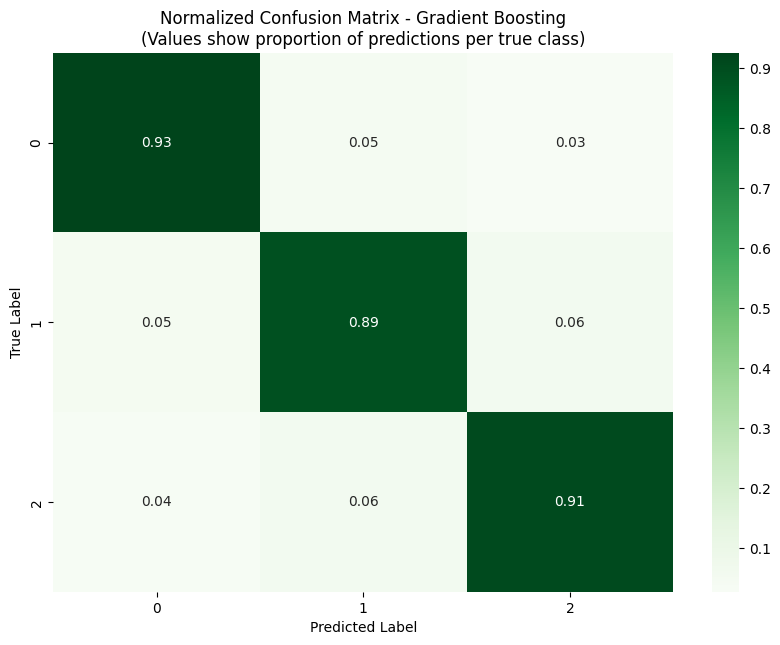


Classification Report for Gradient Boosting:


In [ ]:
# Confusion Matrix Visualization
import matplotlib.pyplot as plt
import seaborn as sns

print("\n=== CONFUSION MATRIX VISUALIZATION ===")

for model_name, results in pipeline_results.items():
    cm = results['confusion_matrix']
    test_acc = results['test_accuracy']

    plt.figure(figsize=(10, 7))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=np.unique(y_test),
                yticklabels=np.unique(y_test))
    plt.title(f'Confusion Matrix - {model_name}\nTest Accuracy: {test_acc:.4f}')
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.show()

    # Print normalized confusion matrix
    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    plt.figure(figsize=(10, 7))
    sns.heatmap(cm_normalized, annot=True, fmt='.2f', cmap='Greens',
                xticklabels=np.unique(y_test),
                yticklabels=np.unique(y_test))
    plt.title(f'Normalized Confusion Matrix - {model_name}\n(Values show proportion of predictions per true class)')
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.show()



In [ ]:
# Display classification report with precision, recall, and F1-score for each class
from sklearn.metrics import classification_report

print("\n=== DETAILED CLASSIFICATION REPORTS ===")

for model_name, results in pipeline_results.items():
    print(f"\nClassification Report for {model_name}:")
    print("="*60)

    # Get predictions
    y_pred = results['best_model'].predict(X_test)

    # Generate and print classification report
    report = classification_report(y_test, y_pred, digits=4)
    print(report)

    # Print confusion matrix
    print("\nConfusion Matrix:")
    print(results['confusion_matrix'])

    print("="*60)


=== DETAILED CLASSIFICATION REPORTS ===

Classification Report for Gradient Boosting:
              precision    recall  f1-score   support

           0     0.9148    0.9257    0.9202      2516
           1     0.8953    0.8924    0.8939      2482
           2     0.9141    0.9061    0.9101      2502

    accuracy                         0.9081      7500
   macro avg     0.9081    0.9081    0.9080      7500
weighted avg     0.9081    0.9081    0.9081      7500


Confusion Matrix:
[[2329  117   70]
 [ 124 2215  143]
 [  93  142 2267]]


# Testing PipeLine

In [ ]:
import pandas as pd
import numpy as np
from catboost import CatBoostClassifier
from sklearn.impute import KNNImputer

def handle_null_and_negative_values(df):
    """
    Handle null and negative values in a DataFrame following specific rules for each column.

    Parameters:
    df (pd.DataFrame): Input dataframe to clean

    Returns:
    pd.DataFrame: Cleaned dataframe with null and negative values handled
    """

    df_clean = df.copy()

    # Handle Blood Type - use CatBoost imputer
    if df_clean['Blood Type'].isna().sum() > 0:
        df_missing = df_clean[df_clean['Blood Type'].isna()]
        df_complete = df_clean[df_clean['Blood Type'].notna()]

        if len(df_complete) > 0:
            features = ['Age', 'Gender', 'Medical Condition']
            target = 'Blood Type'

            model = CatBoostClassifier(verbose=0)
            model.fit(df_complete[features], df_complete[target],
                     cat_features=[1, 2])

            predicted_blood_types = model.predict(df_missing[features])
            df_clean.loc[df_clean['Blood Type'].isna(), 'Blood Type'] = predicted_blood_types

    # Handle Gender, if there were we'd use mode
    if df_clean['Gender'].isna().sum() > 0:
        df_clean['Gender'] = df_clean['Gender'].fillna(df_clean['Gender'].mode()[0])


    # Handle Admission Type - mode imputation
    if df_clean['Admission Type'].isna().sum() > 0:
        mode_type = df_clean['Admission Type'].mode()[0]
        df_clean['Admission Type'] = df_clean['Admission Type'].fillna(mode_type)

    # Handle Medication - mode imputation
    if df_clean['Medication'].isna().sum() > 0:
        mode_med = df_clean['Medication'].mode()[0]
        df_clean['Medication'] = df_clean['Medication'].fillna(mode_med)

    # Handle Insurance Provider - mode imputation
    if df_clean['Insurance Provider'].isna().sum() > 0:
        df_clean['Insurance Provider'] = df_clean['Insurance Provider'].fillna('No Insurance')

    # Handle Hospital - mode imputation (you considered dropping this)
    if df_clean['Hospital'].isna().sum() > 0:
        df_clean['Hospital']=df_clean['Hospital'].fillna('Unknown', inplace=True)

    # Handle Medical Condition - mode imputation
    if df_clean['Medical Condition'].isna().sum() > 0:
        mode_cond = df_clean['Medical Condition'].mode()[0]
        df_clean['Medical Condition'] = df_clean['Medical Condition'].fillna(mode_cond)

    return df_clean


# Load the data
df = pd.read_csv('/content/drive/MyDrive/Task (2) - Machine Learning/test data.csv')

# Handle null and negative values
cleaned_df = handle_null_and_negative_values(df)

In [ ]:
cleaned_df_ID = cleaned_df[['ID']].copy()

In [ ]:
# Drop the 'ID' column from cleaned_df
columns_to_drop = ['ID', 'Name']
cleaned_df = cleaned_df.drop(columns=columns_to_drop, errors='ignore')


In [ ]:
processed = preprocess_dates_and_columns(cleaned_df, drop_columns=False)
print(processed[['Date of Admission', 'Discharge Date', 'Days Spent']].isna().sum())

# Check if Days Spent has NaNs
print(processed['Days Spent'].isna().sum())

Date of Admission    0
Discharge Date       0
Days Spent           0
dtype: int64
0


<ipython-input-243-f84a7c3b0fa0>:4: UserWarning: Parsing dates in %d/%m/%Y format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.
  df['Discharge Date'] = pd.to_datetime(df['Discharge Date'], errors='coerce')


In [ ]:
X_test = pipeline_ga_preprocess.transform(cleaned_df)

<ipython-input-243-f84a7c3b0fa0>:4: UserWarning: Parsing dates in %d/%m/%Y format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.
  df['Discharge Date'] = pd.to_datetime(df['Discharge Date'], errors='coerce')


In [ ]:
import joblib
import pandas as pd

# Path to your saved model
model_path = "/content/drive/MyDrive/Task (2) - Machine Learning/saved_models/Gradient Boosting_baseline_model_Test_age0.pkl"  # Update this path if needed

# Load the model
loaded_model = joblib.load(model_path)

# Make predictions
y_pred = loaded_model.predict(X_test)

# Create a DataFrame with ID and Test Results
results_df = pd.DataFrame({
    'ID': cleaned_df_ID['ID'],
    'Test Results': y_pred
})

results_df['Test Results'] = results_df['Test Results'].map({
    2: 'Normal',
    0: 'Abnormal',
    1: 'Inconclusive'
})

# Save to CSV
results_df.to_csv('/content/drive/MyDrive/Task (2) - Machine Learning/test_resultsGradientAGEZERO.csv', index=False)

print("✅ Model loaded successfully. Predictions saved to test_results.csv")
print("First 5 predictions:")
print(results_df.head())

✅ Model loaded successfully. Predictions saved to test_results.csv
First 5 predictions:
      ID  Test Results
0  50001  Inconclusive
1  50002        Normal
2  50003        Normal
3  50004  Inconclusive
4  50005      Abnormal
